**Imports**

In [1]:
import os

In [2]:
%reload_ext autoreload
%autoreload 2

from package import functions

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from numpy import average
from numpy import corrcoef
from numpy import arange
from sklearn.metrics import mean_absolute_percentage_error

import re

from pmdarima.arima import auto_arima

from darts import TimeSeries

**come fa random forest a predirre più di un periodo alla volta?**
multi_models If True, a separate model will be trained for each future lag to predict. If False, a single model is trained to predict at step ‘output_chunk_length’ in the future. Default: True

In [3]:
#top_series = pd.read_csv('./data/top_series_no_outliers.csv', index_col='date', parse_dates=True)
top_series = pd.read_csv('./data/top_series_no_outliers.csv', index_col='Unnamed: 0', parse_dates=True)

In [4]:
top_series.head(5)

,44 BEVERAGES,44 GROCERY I,44 PRODUCE,45 BEVERAGES,45 GROCERY I,45 PRODUCE
2013-01-01,5466.00,10686.00,57.00,4070.00,11422.00,47.00
2013-01-02,5466.00,10686.00,57.00,4070.00,11422.00,47.00
2013-01-03,3718.00,7342.00,57.00,2526.00,6841.00,47.00
2013-01-04,4112.00,7250.00,57.00,3064.00,7527.00,47.00
2013-01-05,6458.00,10699.00,57.00,4852.00,10550.00,47.00


In [5]:
#top_series.rename(columns={'Unnamed: 0':'date'}, inplace=True)
#top_series.set_index('date')
top_series.rename_axis('date')

,44 BEVERAGES,44 GROCERY I,44 PRODUCE,45 BEVERAGES,45 GROCERY I,45 PRODUCE
date,,,,,,
2013-01-01,5466.00,10686.00,57.00,4070.00,11422.00,47.00
2013-01-02,5466.00,10686.00,57.00,4070.00,11422.00,47.00
2013-01-03,3718.00,7342.00,57.00,2526.00,6841.00,47.00
2013-01-04,4112.00,7250.00,57.00,3064.00,7527.00,47.00
2013-01-05,6458.00,10699.00,57.00,4852.00,10550.00,47.00
...,...,...,...,...,...,...
2017-08-11,9517.00,9979.00,9311.46,8983.00,11088.00,7112.93
2017-08-12,9624.00,9391.00,9153.44,8969.00,9917.00,6242.68
2017-08-13,10491.00,9811.00,11201.80,10671.00,12723.00,7621.85


In [6]:
top_transactions = pd.read_csv("./data/top_series_transactions.csv", index_col='date', parse_dates=True)
top_transactions.head(2)

,44,45
date,,
2013-01-02,4821,4208
2013-01-03,3618,3314


In [7]:
top_transactions.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1677 entries, 2013-01-02 to 2017-08-15
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   44      1677 non-null   int64
 1   45      1677 non-null   int64
dtypes: int64(2)
memory usage: 39.3 KB


**CALCOLIAMO LA CORRELAZIONE TRA CATEGORIE DI PRODOTTO E TRANSAZIONI GIORNALIERE**

In [8]:
for product in top_series.columns:
    transactions = product[:2]
    functions.calculate_correlation(product=product, transactions=transactions, lags=7)

correlation between 44 BEVERAGES and 44 transactions with 7 lags is: 
 0.51
correlation between 44 GROCERY I and 44 transactions with 7 lags is: 
 0.51


In generale sembra poco utile utilizzare lo shift settimanale delle transazioni come covariata perchè in nessun caso la correlazione è superiore al 51%.

**STAZIONARIETA'**

Differenziamo la serie in modo tale da renderla stazionaria.

Dal grafico dell'autocorrelazione si capisce che le serie sono stagionali, con un periodo pari a una settimana, è necessario eliminare il trend (crescente) dalle serie in modo tale da favorire le performance ottimali (a livello teorico) degli algoritmi di statistical learning che applicheremo. Di solito si differenzia per un giorno, ma la deviazione standard potrebbe rimanere diversa tra una finestra e l'altra della serie, proveremo a differenziare di una settimana per ridurre la st. dev.

Considerazioni sul differenziamento a una settimana: tale manipolazione conduce a risultati pessimi, sostanzialmente si predice ripetutamente l'ultimo valore della serie, portando ad una predizione mensile piatta (quasi una linea retta).

Manterremo la differenziazione classica ad un giorno.

In [9]:
top_series['44 PRODUCE'][70:75]

2013-03-12   57.00
2013-03-13   57.00
2013-03-14   57.00
2013-03-15   57.00
2013-03-16   57.00
Name: 44 PRODUCE, dtype: float64

i primi 74 valori di vendite di 44 PRODUCE sono pari a zero

In [10]:
top_series['44 PRODUCE'][74:].mask(top_series['44 PRODUCE'][74:] != 0).count()

0

In [11]:
zero_series = top_series.loc[top_series['44 PRODUCE'] == 0]['44 PRODUCE'][74:]
zero_series

Series([], Name: 44 PRODUCE, dtype: float64)

In [12]:
top_series['44 PRODUCE']['2016-12-31': '2017-01-02']

2016-12-31   12032.65
2017-01-01   17449.59
2017-01-02   17449.59
Name: 44 PRODUCE, dtype: float64

**Attenzione**: i primi 4 anni di ciascuna serie non presentano il giorno di Natale, 25-12. Questo causa dei problemi per alcuni modelli come la rete neurale che non gestisce in autonomia i NaN. Si procede all'inserimento del dato per il 25-12 ponendolo pari al 26-12 con il metodo 'bfill' di pandas.

In [13]:
for s in top_series.columns:
    for y in ['2013','2014','2015','2016','2017']:
        print(s, y, len(top_series[s]['{}-01-01'.format(y): '{}-12-31'.format(y)]))
    print('\n')

44 BEVERAGES 2013 365
44 BEVERAGES 2014 365
44 BEVERAGES 2015 365
44 BEVERAGES 2016 366
44 BEVERAGES 2017 227


44 GROCERY I 2013 365
44 GROCERY I 2014 365
44 GROCERY I 2015 365
44 GROCERY I 2016 366
44 GROCERY I 2017 227


44 PRODUCE 2013 365
44 PRODUCE 2014 365
44 PRODUCE 2015 365
44 PRODUCE 2016 366
44 PRODUCE 2017 227


45 BEVERAGES 2013 365
45 BEVERAGES 2014 365
45 BEVERAGES 2015 365
45 BEVERAGES 2016 366
45 BEVERAGES 2017 227


45 GROCERY I 2013 365
45 GROCERY I 2014 365
45 GROCERY I 2015 365
45 GROCERY I 2016 366
45 GROCERY I 2017 227


45 PRODUCE 2013 365
45 PRODUCE 2014 365
45 PRODUCE 2015 365
45 PRODUCE 2016 366
45 PRODUCE 2017 227




In [14]:
date_index = pd.date_range(start='01/01/2013', end='15/08/2017', freq='D')
df = top_series.reindex(date_index)

In [15]:
df.shape

(1688, 6)

In [16]:
df[df['44 BEVERAGES'].isna() == True]

,44 BEVERAGES,44 GROCERY I,44 PRODUCE,45 BEVERAGES,45 GROCERY I,45 PRODUCE


In [17]:
top_series = top_series.reindex(date_index, method='bfill')

In [18]:
top_series[top_series['44 BEVERAGES'].isna() == True]

,44 BEVERAGES,44 GROCERY I,44 PRODUCE,45 BEVERAGES,45 GROCERY I,45 PRODUCE


In [19]:
top_series.loc['2013-12-25':'2013-12-26']

,44 BEVERAGES,44 GROCERY I,44 PRODUCE,45 BEVERAGES,45 GROCERY I,45 PRODUCE
2013-12-25,3723.00,7915.00,36.00,3089.00,8090.00,20.00
2013-12-26,3723.00,7915.00,36.00,3089.00,8090.00,20.00


Ad eccezione di qualche valore saltuario le vendite sono pari a zero il primo di ogni anno. Sostituiamo 0 con il valore successivo per agevolare i modelli predittivi.

In [20]:
top_series= top_series.replace(to_replace=0, method='bfill')

In [21]:
# for series in top_series.columns:
#     print(top_series[series].mask(top_series[series] == 0).count())

**Esempio serie lag1**

In [22]:
sr = top_series['44 BEVERAGES']
sr_lag1 = sr.shift(1)
data = {'44 BEVERAGES':sr, '44 BEVERAGES LAG1':sr_lag1}
df_lag1 = pd.concat(objs=data, axis=1) 
df_lag1.head(5)

,44 BEVERAGES,44 BEVERAGES LAG1
2013-01-01,5466.00,NaN
2013-01-02,5466.00,5466.00
2013-01-03,3718.00,5466.00
2013-01-04,4112.00,3718.00
2013-01-05,6458.00,4112.00


**CREAZIONE DIZIONARIO CON OGGETTI NECESSARI ALLA PREDIZIONE**

In [23]:
dict_diff_series = {}

**GRAFICI AUTO CORR E PARTIAL AUTO CORR DELLE SERIE STORICHE**

Consideriamo utili ai fini predittivi solamente i lag con i quali la serie differenziata ha un'auto correlazione parziale di almeno 0.20

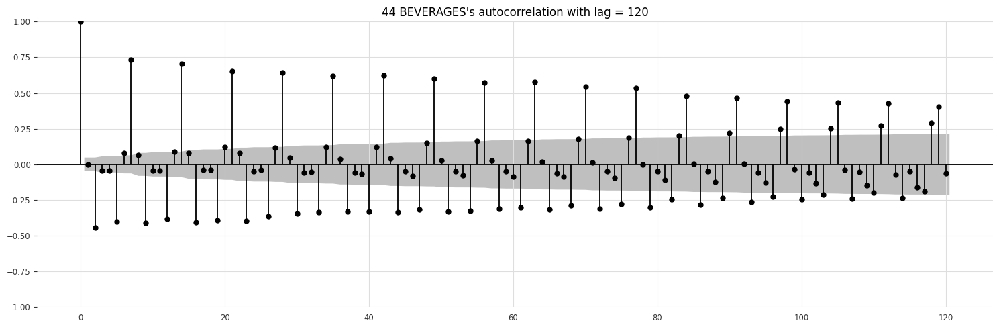

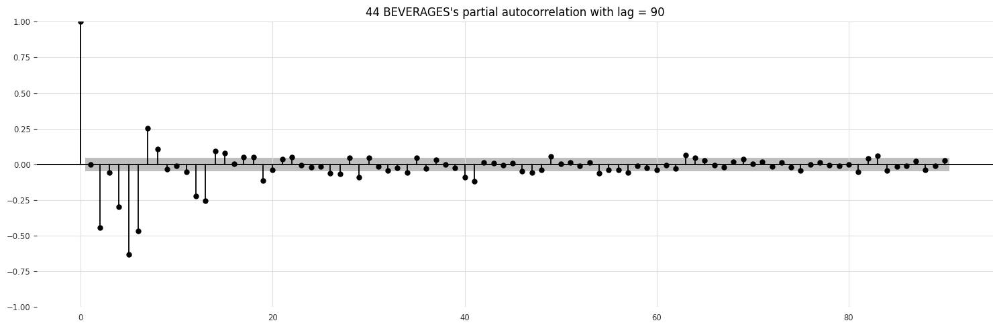

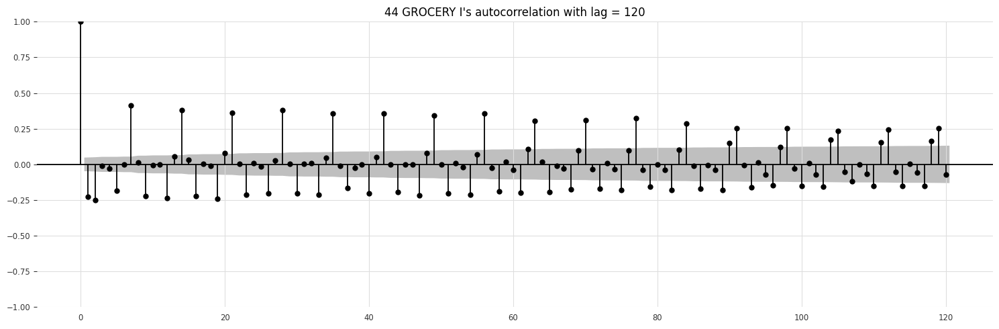

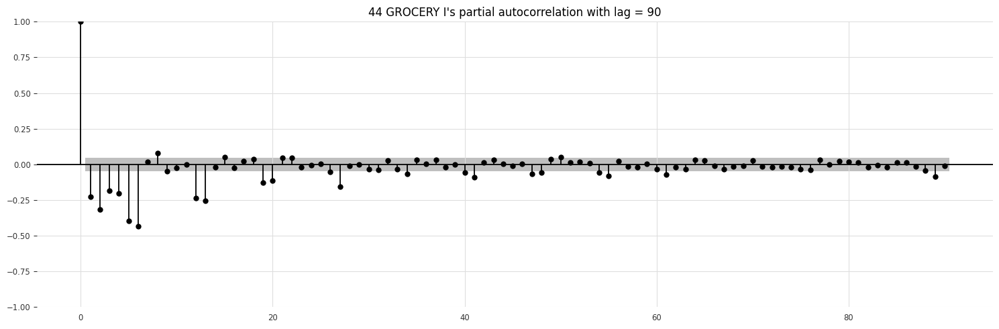

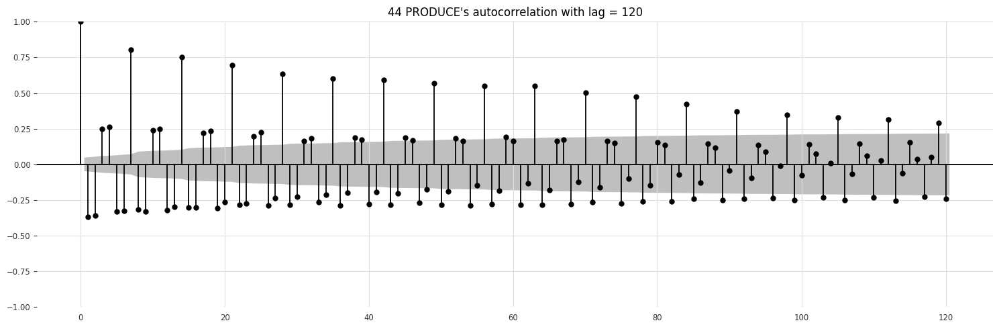

...

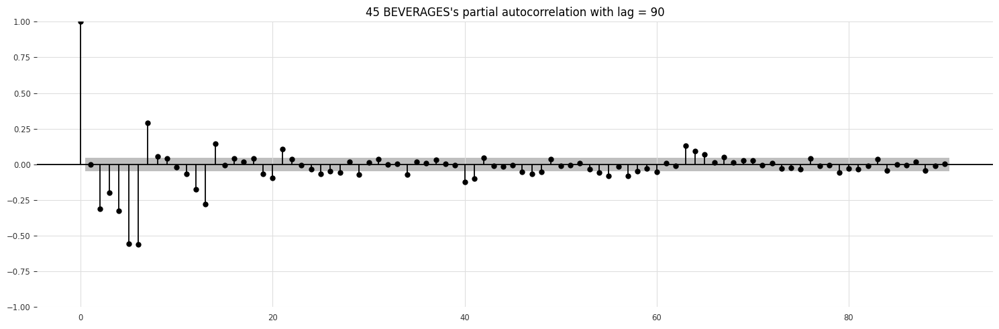

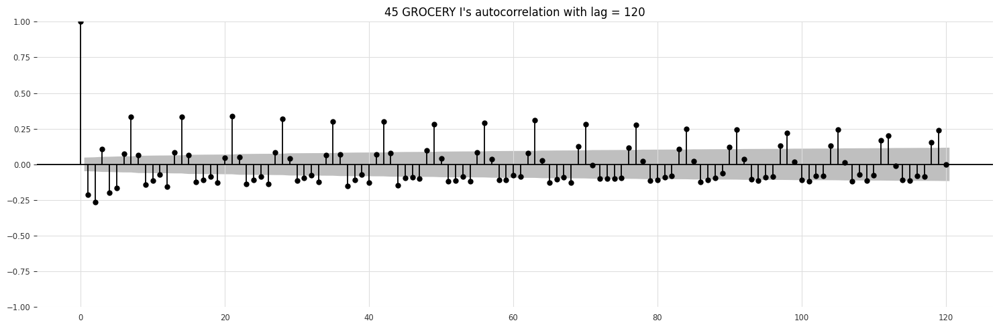

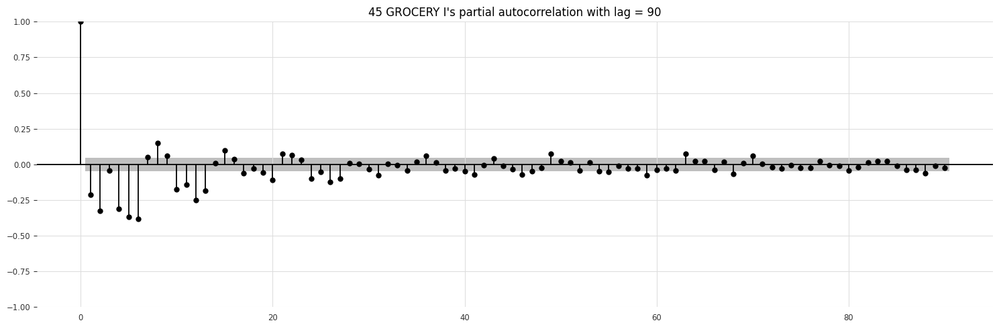

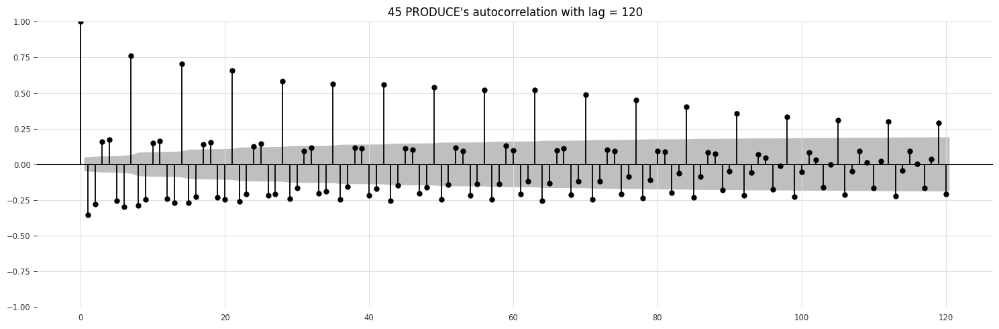

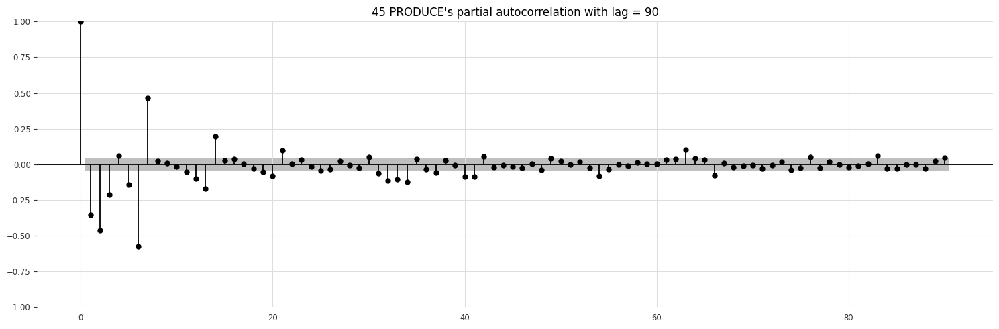

In [24]:
for product in top_series.columns:
    diff_series, lags_ac, lags_pac, lags_indexes_pac = functions.check_autocorrelation(series=product, diff_lags=1)
    dict_diff_series[product] = (diff_series, lags_ac, lags_pac, lags_indexes_pac)

Con lag -1 la stagionalità rimane settimanale, come nella serie originale.

**GRAFICI SERIE STORICHE DIFFERENZIATE DI UN GIORNO**

In [25]:
dict_diff_series.keys()

dict_keys(['44 BEVERAGES', '44 GROCERY I', '44 PRODUCE', '45 BEVERAGES', '45 GROCERY I', '45 PRODUCE'])

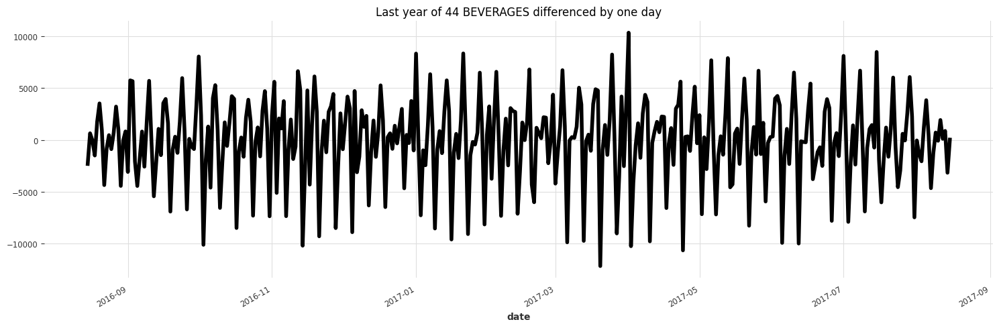

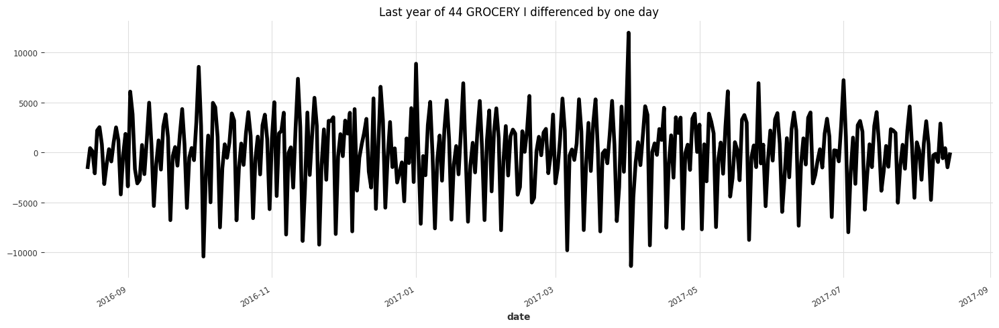

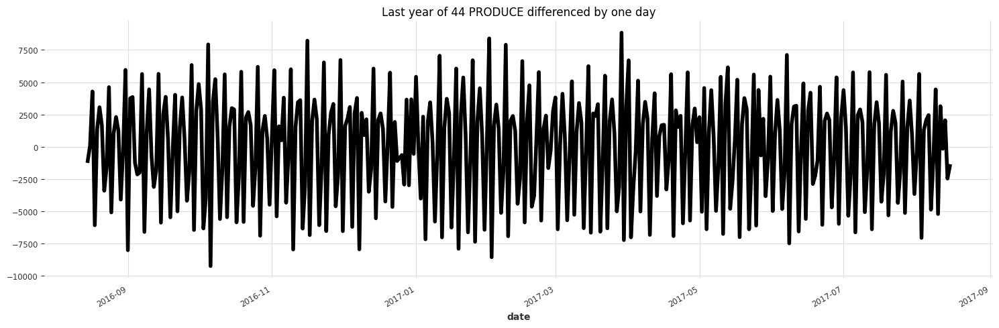

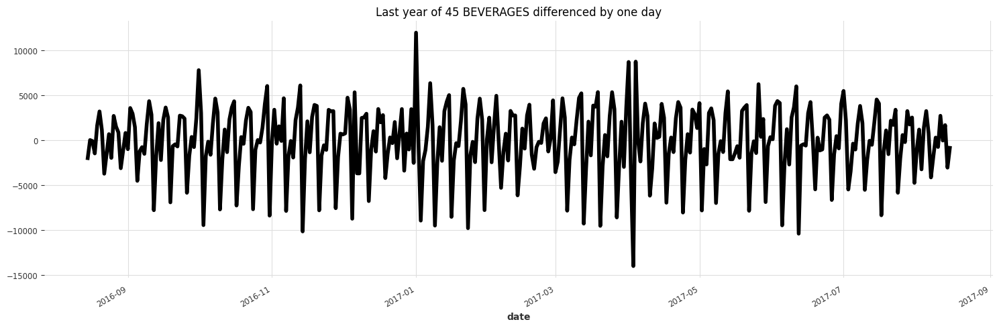

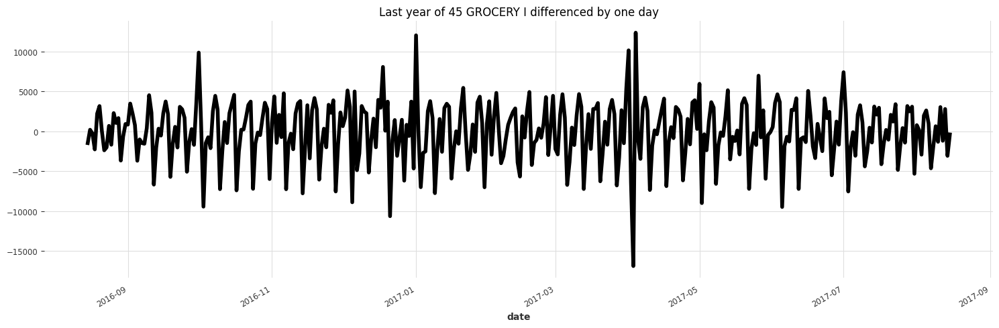

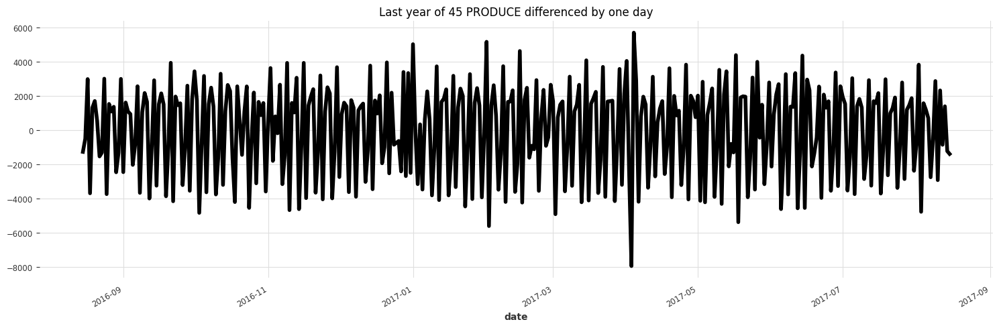

In [26]:
for series in dict_diff_series.keys():
    fig, ax = plt.subplots(figsize=(15, 5))
    dict_diff_series[series][0][-365:].plot(lw=4, ax=ax)
    plt.title(r'Last year of {} differenced by one day'.format(series))
    plt.tight_layout()
    plt.show()

In [27]:
performance_dict = {}
performance_dict['Series'] = []

In [28]:
performance_dict['Baseline mape'] = []

performance_dict['Arima mape cov days'] = []
#performance_dict['Random forest diff mape'] = []

In [29]:
performance_dict['Arima mape scaled data'] = []
performance_dict['Arima mape scaled data and weeks'] = []

performance_dict['Random forest diff and weeks mape'] = []
performance_dict['Bagging mape'] = []
performance_dict['Random Forest mape'] = []

**BASELINE MODEL**

Per prima cosa calcoliamo la moving average con una finestra di una settimana, dato che la stagionalità principale della serie non differenziata è settimanale.

Ora possiamo applicare un modello naive per cui la predizione è data dallo shift della serie in avanti di una settimana, cioè il modello prevede il volume di vendita registrato sette giorni prima.

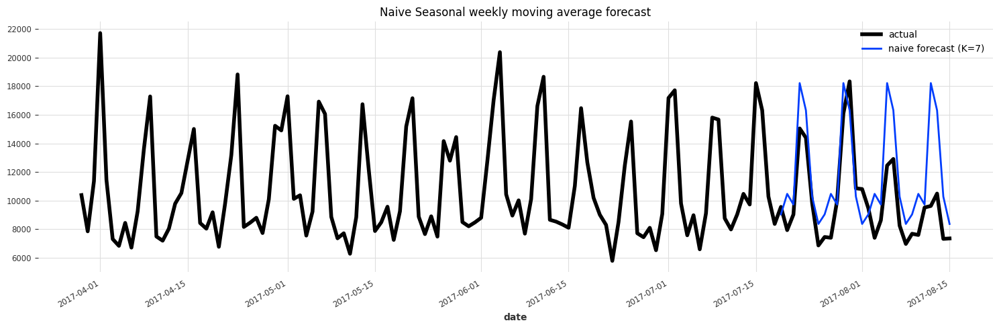

model Naive Seasonal obtains MAPE: 23.47


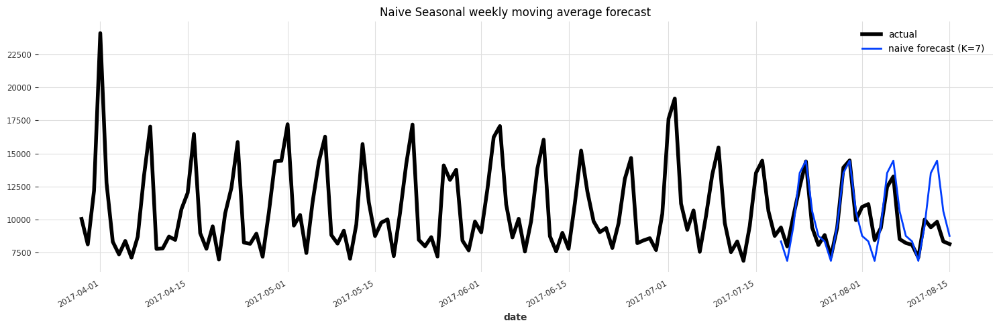

model Naive Seasonal obtains MAPE: 12.06


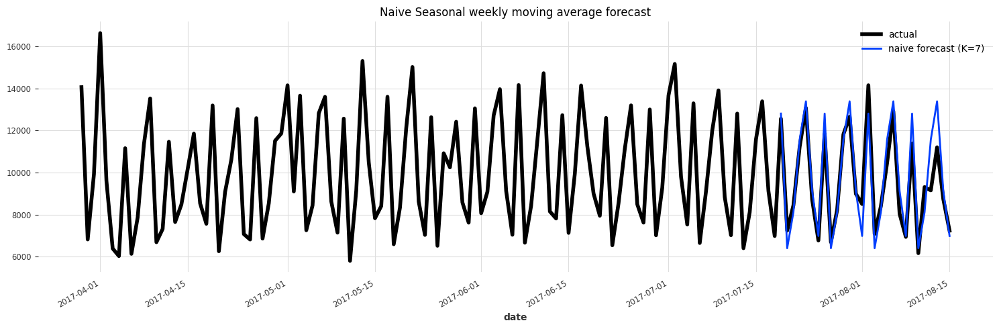

model Naive Seasonal obtains MAPE: 7.33


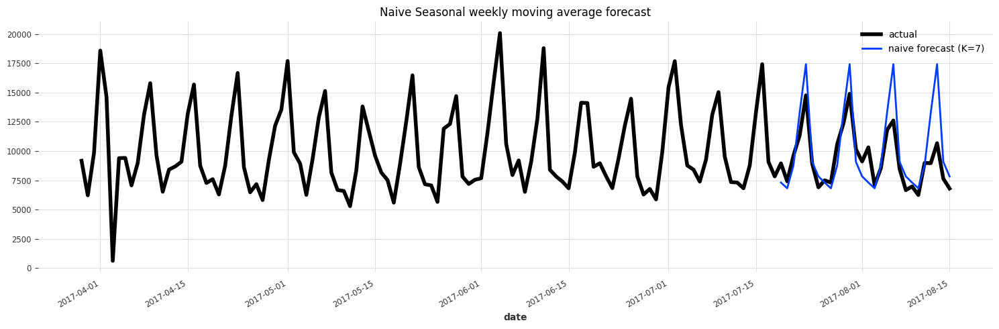

model Naive Seasonal obtains MAPE: 15.54


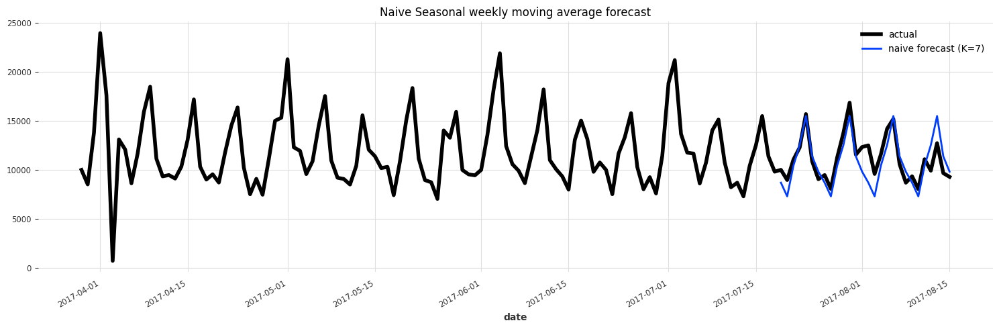

model Naive Seasonal obtains MAPE: 11.05


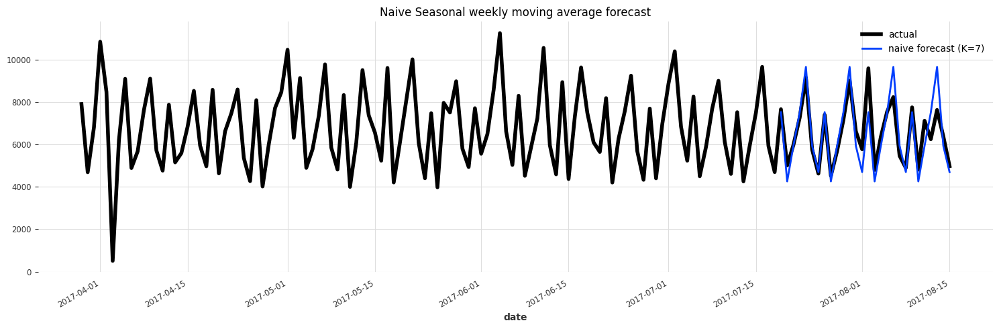

model Naive Seasonal obtains MAPE: 8.72


In [30]:
performance_dict['Baseline mape'] = []
for product in top_series.columns:
    baseline_mape = functions.get_naive_predictions(series=product)
    performance_dict['Baseline mape'].append(baseline_mape)

In [31]:
performance_dict['Baseline mape']

[23.47, 12.06, 7.33, 15.54, 11.05, 8.72]

In [32]:
round(average(performance_dict['Baseline mape']), 2)

13.03

**ARIMA MODEL**

Il modello utilizzato è solamente Auto Regressivo, col parametro *p* fissato pari all'ultimo lag significativo in base all'autocorrelaz. parziale.

Passiamo al modello AR i dati differenziati ma non scalati (tramite min-max scaler) e i giorni della settimana come covariata.

In [33]:
lags_diff_series = {}
for series in dict_diff_series.keys():
    diff_series = dict_diff_series[series][0]
    if 'PRODUCE'in series:
        #diff_series = diff_series['2015-06-01':]
        #print(diff_series[0:2])
        diff_series = diff_series['2015-06-02':]
        #print(diff_series[0:2])
    part_corr = functions.pacf(x=diff_series, nlags=30)
    lags_pac = [(i+1, round(c, 3)) for i, c in enumerate(part_corr[1:]) if abs(c) > 0.175] # 0.20 o 0.125
    
    lags_indexes_pac = [int(t[0])*(-1) for t in lags_pac]
    lags_diff_series[series] = lags_indexes_pac
lags_diff_series

{'44 BEVERAGES': [-2, -4, -5, -6, -7, -12, -13],
 '44 GROCERY I': [-1, -2, -3, -4, -5, -6, -12, -13],
 '44 PRODUCE': [-1, -2, -3, -6, -7, -13],
 '45 BEVERAGES': [-2, -3, -4, -5, -6, -7, -13],
 '45 GROCERY I': [-1, -2, -4, -5, -6, -12, -13],
 '45 PRODUCE': [-1, -2, -3, -5, -6, -7, -13]}

In [34]:
for series in dict_diff_series.keys():
    lags_indexes = dict_diff_series[series][3]
    print(lags_indexes)

[-2, -4, -5, -6, -7, -12, -13]
[-1, -2, -3, -4, -5, -6, -12, -13]
[-1, -2, -3, -6, -7, -14]
[-2, -3, -4, -5, -6, -7, -13]
[-1, -2, -4, -5, -6, -12, -13]
[-1, -2, -3, -6, -7, -14]


In [35]:
# for series in dict_diff_series.keys():
#     dict_diff_series[series][3] = lags_diff_series[series]
#     print(dict_diff_series[series][3])

**BISOGNA USARE ['2015-06-02':] CON DIFF SERIES, ['2015-06-01':] CON SERIES NON DIFF PER EVITERE IL BALZO**

[-2, -4, -5, -6, -7, -12, -13]
model Arima obtains MAPE: 19.57


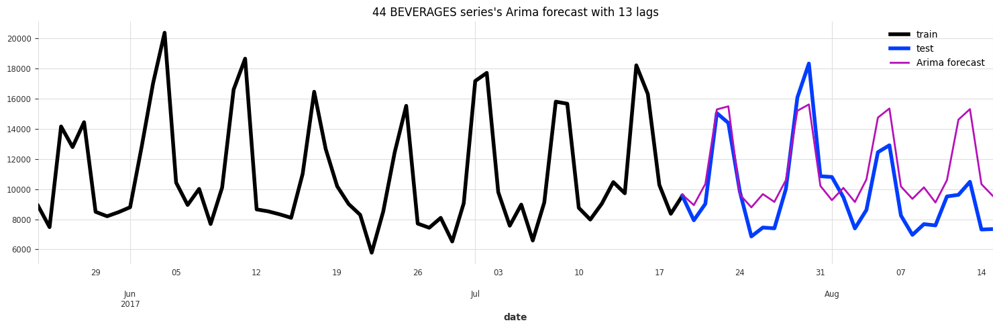

[-1, -2, -3, -4, -5, -6, -12, -13]
model Arima obtains MAPE: 9.99


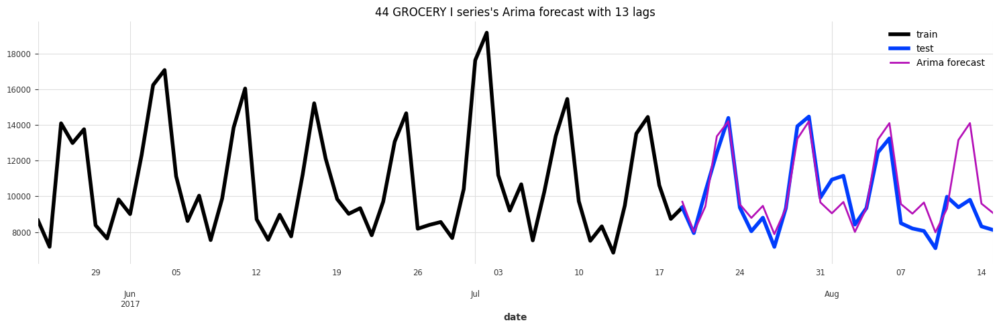

804
[-1, -2, -3, -6, -7, -13]
model Arima obtains MAPE: 6.62


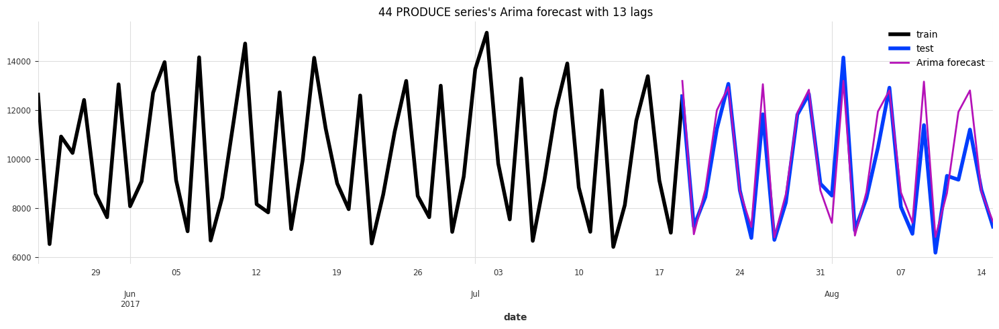

[-2, -3, -4, -5, -6, -7, -13]
model Arima obtains MAPE: 13.83


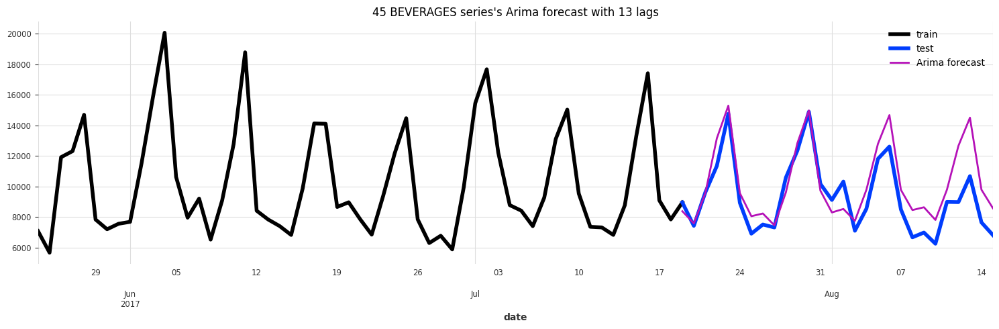

[-1, -2, -4, -5, -6, -12, -13]
model Arima obtains MAPE: 7.89


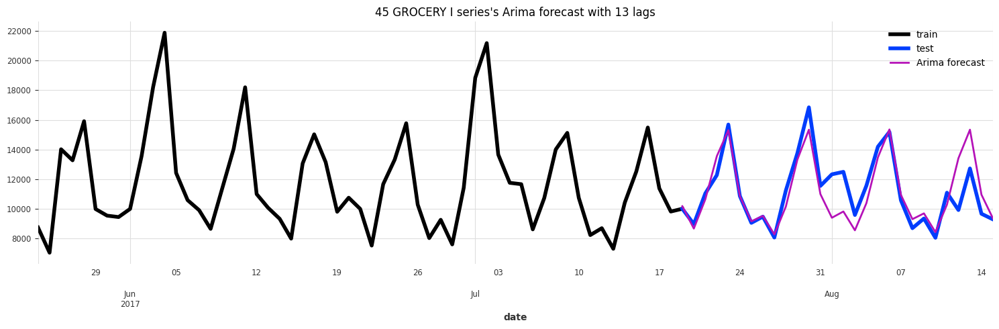

804
[-1, -2, -3, -5, -6, -7, -13]
model Arima obtains MAPE: 7.00


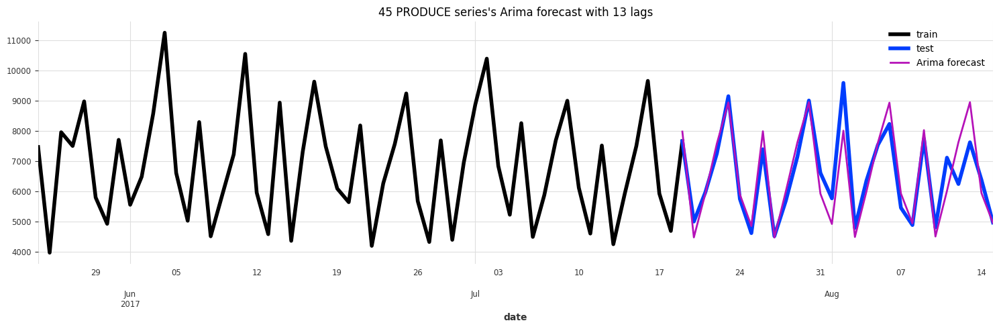

In [36]:
#performance_dict['Arima mape'] = []
for series in dict_diff_series.keys():
    performance_dict['Series'].append(series)
    diff_series = dict_diff_series[series][0]
    if 'PRODUCE'in series:
        diff_series = diff_series['2015-06-02':]
        print(len(diff_series))
    #lags_indexes = dict_diff_series[series][3]
    lags_indexes = lags_diff_series[series]
    print(lags_indexes)
    model_mape = functions.get_model_predictions(diff_series=diff_series, model_type='Arima', lags_indexes=lags_indexes,
                                                 fut_cov_days_only=True, to_scale=False)
    performance_dict['Arima mape cov days'].append(model_mape)

In [37]:
performance_dict['Arima mape cov days']

[19.57, 9.99, 6.62, 13.83, 7.89, 7.0]

In [38]:
#[19.57, 9.99, 6.56, 13.83, 7.89, 6.98]

**44 PRODUCE**

model AR without future covariates obtains MAPE: 20.13

model AR with future covariates obtains MAPE: 6.62

La serie sembra essere altamente dipendente dai giorni della settimana

In [39]:
for series in dict_diff_series.keys():
    print(dict_diff_series[series][3])

[-2, -4, -5, -6, -7, -12, -13]
[-1, -2, -3, -4, -5, -6, -12, -13]
[-1, -2, -3, -6, -7, -14]
[-2, -3, -4, -5, -6, -7, -13]
[-1, -2, -4, -5, -6, -12, -13]
[-1, -2, -3, -6, -7, -14]


**Scalatura della serie storica**

Il modello AR potrebbe giovare della scalatura dei dati, essendo un modello di regressione lineare, dunque scaliamo la serie prima di effettuare il training del modello.

scaler is fit on training set only to avoid leakage
(https://unit8co.github.io/darts/examples/01-multi-time-series-and-covariates.html)

model Arima obtains MAPE: 19.77


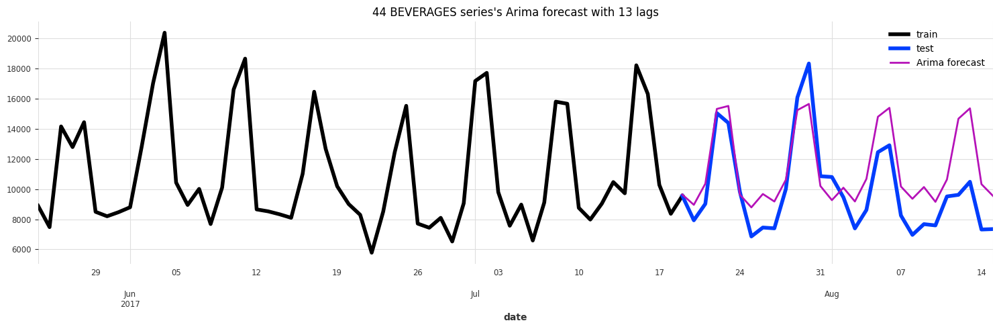

model Arima obtains MAPE: 11.00


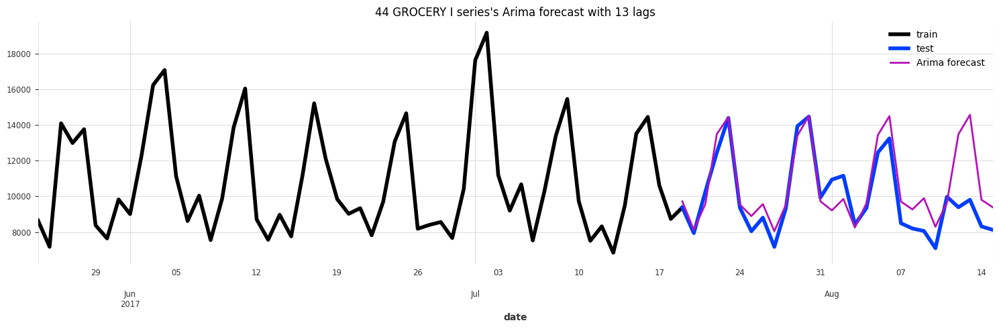

804
model Arima obtains MAPE: 6.50


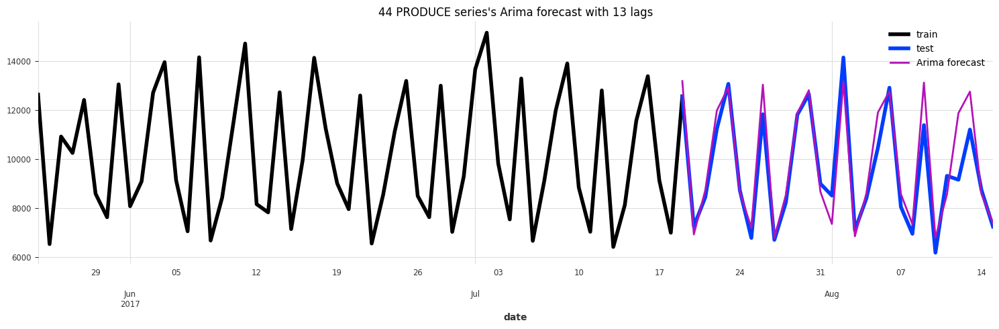

model Arima obtains MAPE: 13.76


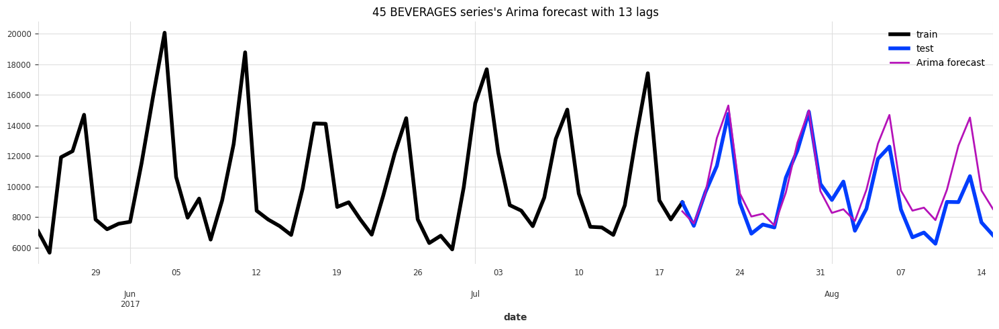

model Arima obtains MAPE: 8.17


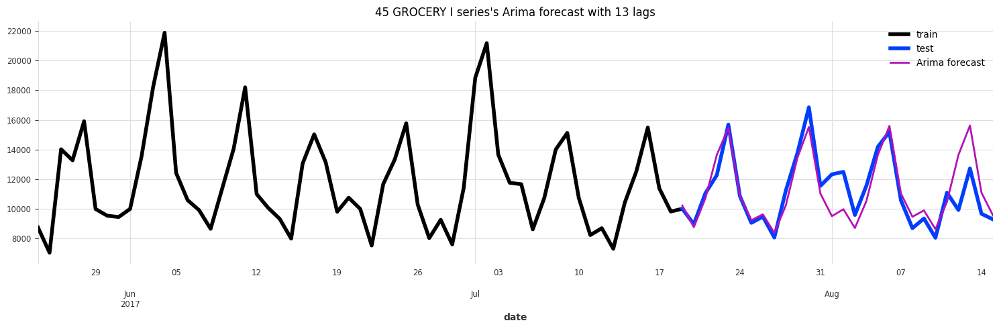

804
model Arima obtains MAPE: 7.09


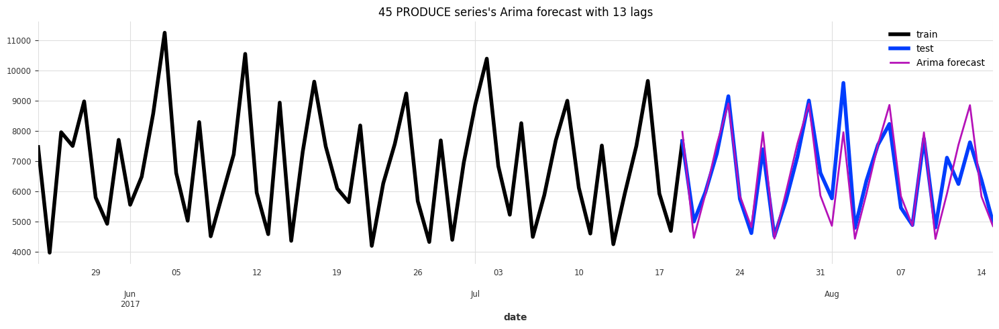

In [40]:
for series in dict_diff_series.keys():
    diff_series = dict_diff_series[series][0]
    if 'PRODUCE'in series:
        diff_series = diff_series['2015-06-02':]
        print(len(diff_series))
    #lags_indexes = dict_diff_series[series][3]
    lags_indexes = lags_diff_series[series]
    model_mape = functions.get_model_predictions(diff_series=diff_series, model_type='Arima',
                                       lags_indexes=lags_indexes, to_scale=True)
    performance_dict['Arima mape scaled data'].append(model_mape)

In [41]:
performance_dict['Arima mape scaled data']

[19.77, 11.0, 6.5, 13.76, 8.17, 7.09]

Aggiunta della settimana dell'anno come future covariate

settimane e giorni
model Arima obtains MAPE: 13.24


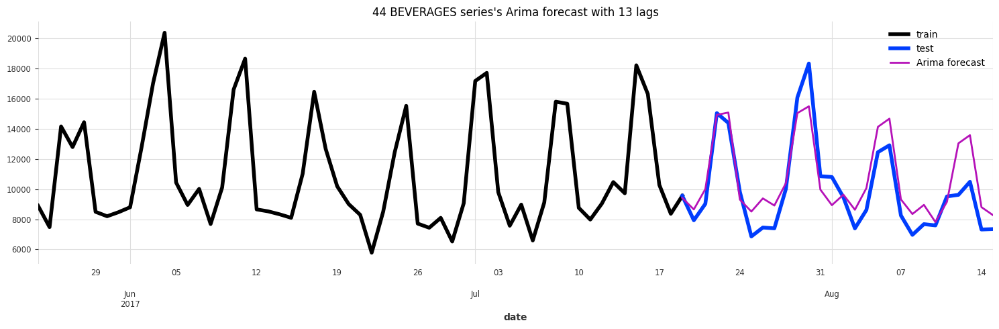

settimane e giorni
model Arima obtains MAPE: 10.35


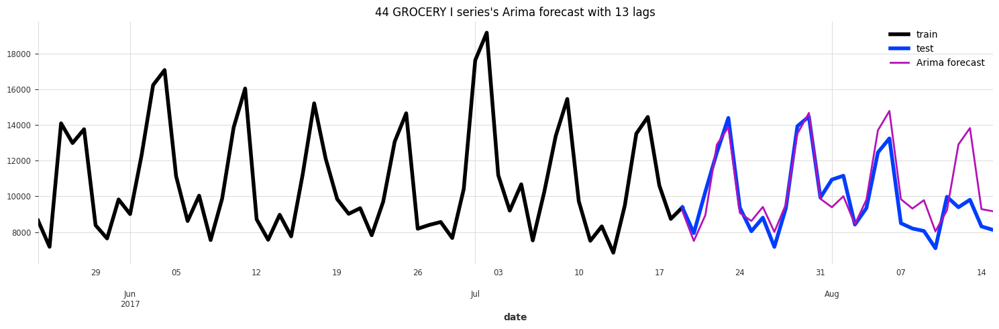

804
settimane e giorni
model Arima obtains MAPE: 6.38


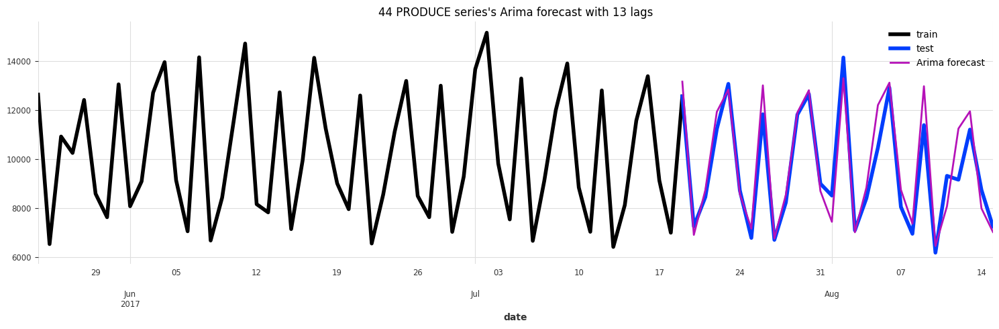

settimane e giorni
model Arima obtains MAPE: 7.86


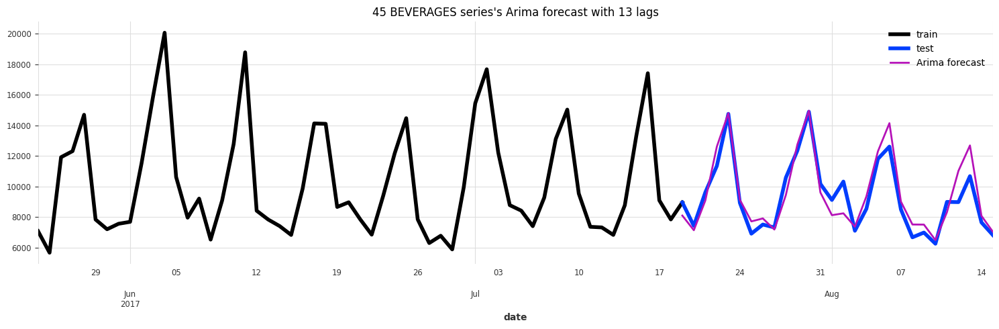

settimane e giorni
model Arima obtains MAPE: 8.95


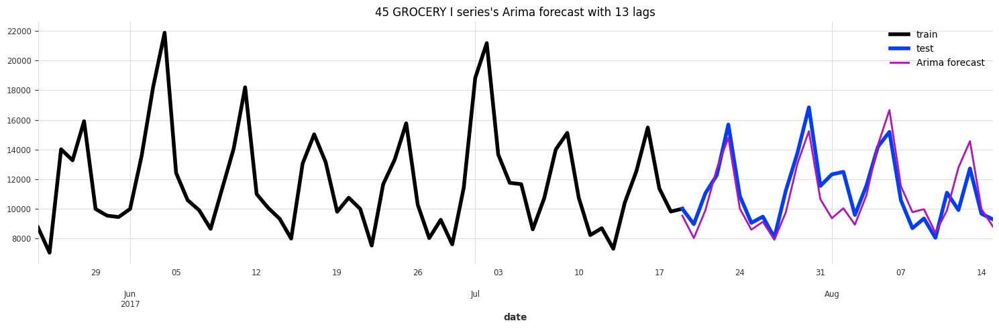

804
settimane e giorni
model Arima obtains MAPE: 7.99


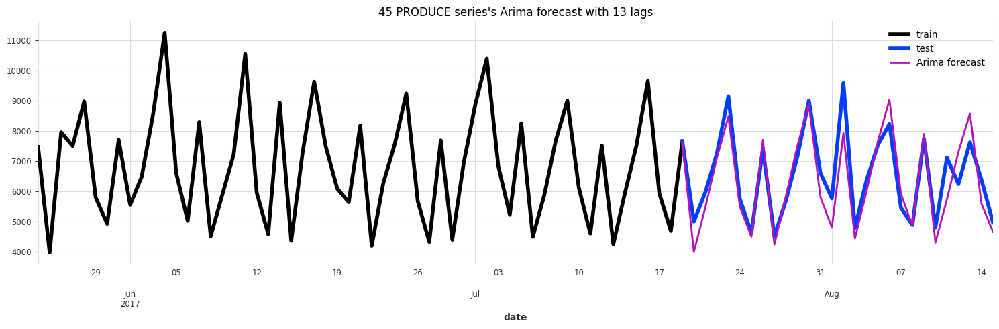

In [42]:
#performance_dict['Arima mape scaled data and weeks'] = []
for series in dict_diff_series.keys():
    diff_series = dict_diff_series[series][0]
    if 'PRODUCE'in series:
        diff_series = diff_series['2015-06-02':]
        print(len(diff_series))
    #lags_indexes = dict_diff_series[series][3]
    lags_indexes = lags_diff_series[series]
    model_mape = functions.get_model_predictions(diff_series=diff_series, model_type='Arima',
                                       lags_indexes=lags_indexes, to_scale=True, fut_cov_days_only=False, week_of_year=True)
    performance_dict['Arima mape scaled data and weeks'].append(model_mape)

In [43]:
print(performance_dict['Arima mape scaled data and weeks'],
      round(average(performance_dict['Arima mape scaled data and weeks']), 2))

[13.24, 10.35, 6.38, 7.86, 8.95, 7.99] 9.13


In [44]:
#[13.24, 10.35, 6.38, 7.86, 8.69, 7.99] 9.08

**RANDOM FOREST**

Per quanto riguarda il random forest non è necessario che la serie sia stazionaria, proveremo entrambe le casistiche.

Consideriamo la serie differenziata e solo i giorni della settimana come covariata futura: solamente i lag -1 e 0

In [45]:
# for series in dict_diff_series.keys():
#     diff_series = dict_diff_series[series][0]
#     if 'PRODUCE'in series:
#         diff_series = diff_series['2015-06-02':]
#         print(len(diff_series))
#     #lags_indexes = dict_diff_series[series][3]
#     lags_indexes = lags_diff_series[series]
#     print('Lags:', lags_indexes)
#     model_mape = functions.get_model_predictions(diff_series=diff_series, model_type='Random Forest', lags_indexes=lags_indexes)
#     performance_dict['Random forest diff mape'].append(model_mape)

In [46]:
# print(performance_dict['Random forest diff mape'],
#       round(average(performance_dict['Random forest diff mape']), 2))

**Random forest con un numero maggiore di lag per le future covariates che comprendono anche le settimane dell'anno**

settimane e giorni
model Random Forest obtains MAPE: 11.67


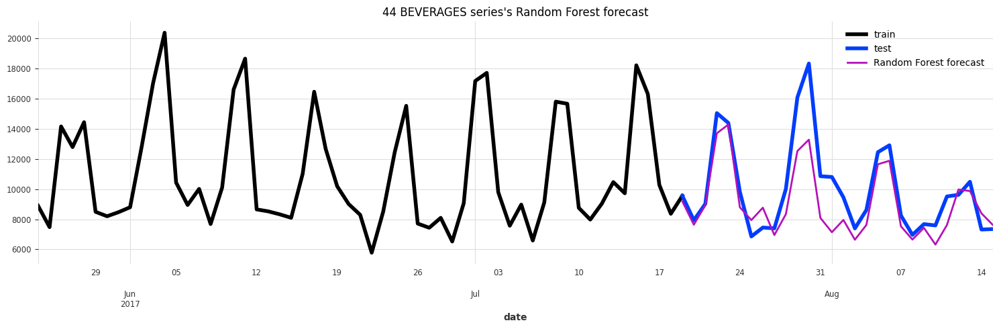

settimane e giorni
model Random Forest obtains MAPE: 18.99


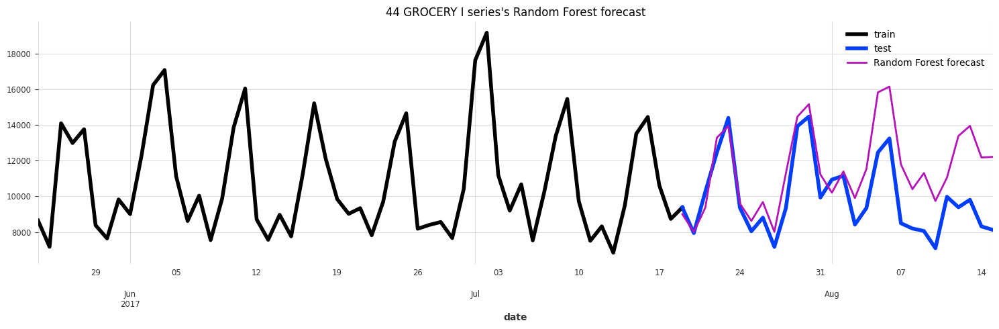

804
settimane e giorni
model Random Forest obtains MAPE: 7.45


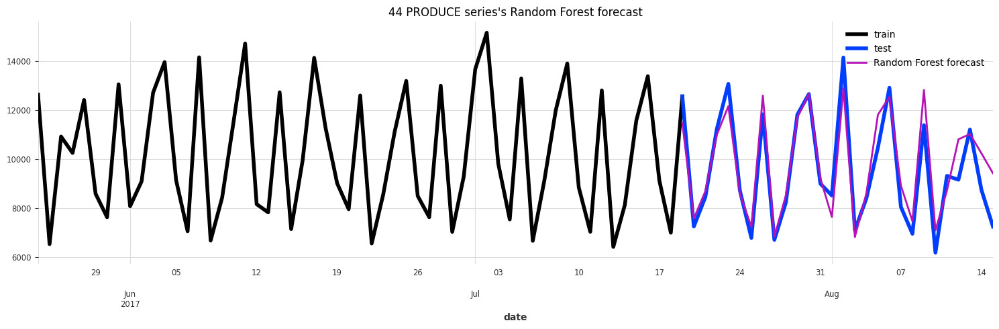

settimane e giorni
model Random Forest obtains MAPE: 22.61


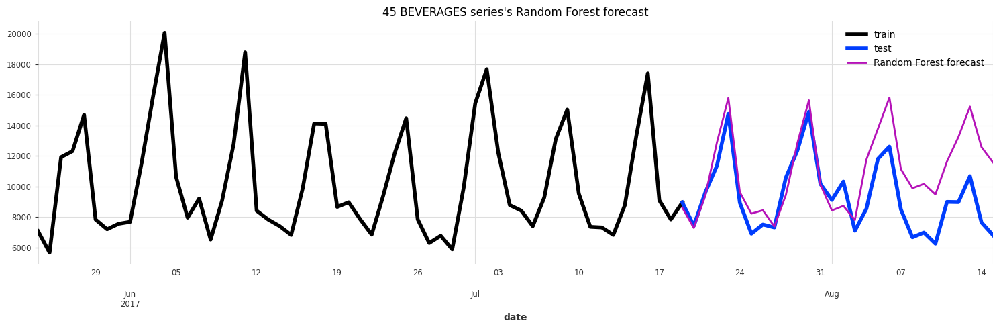

settimane e giorni
model Random Forest obtains MAPE: 10.03


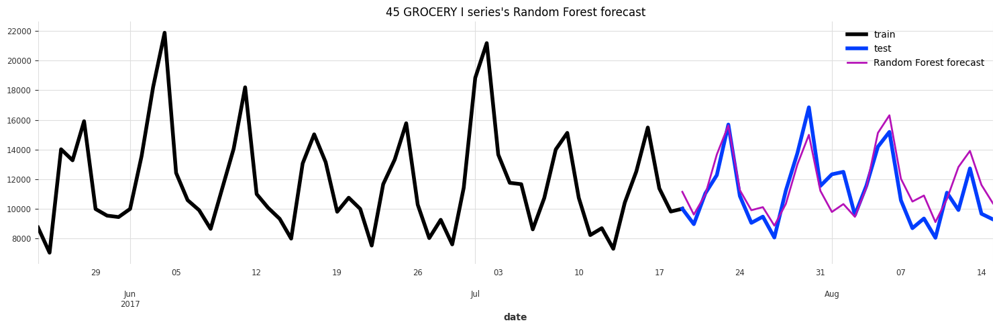

804
settimane e giorni
model Random Forest obtains MAPE: 6.03


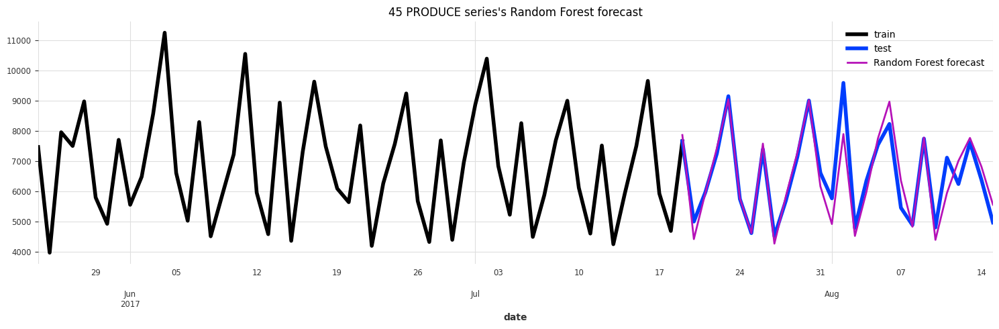

In [47]:
performance_dict['Random forest diff and weeks mape'] = []
for series in dict_diff_series.keys():
    diff_series = dict_diff_series[series][0]
    if 'PRODUCE'in series:
        diff_series = diff_series['2015-06-02':]
        print(len(diff_series))
    #lags_indexes = dict_diff_series[series][3]
    lags_indexes = lags_diff_series[series]
    #lags_future_covariates=[-13, -6, -2, 0]
    model_mape = functions.get_model_predictions(diff_series=diff_series, model_type='Random Forest', lags_indexes=lags_indexes,
                                       lags_future_covariates=[-2, -1, 0, +1, +2], fut_cov_days_only=False, week_of_year=True)
    performance_dict['Random forest diff and weeks mape'].append(model_mape)

In [48]:
print(performance_dict['Random forest diff and weeks mape'],
      round(average(performance_dict['Random forest diff and weeks mape']), 2))

[11.67, 18.99, 7.45, 22.61, 10.03, 6.03] 12.8


**Random Forest e serie non differenziate**

I lag presenti nel dizionario sono stati scelti in base all'autocorrelazione parziale delle serie storiche originali, non differenziate

In [49]:
# dict_series = {
#                 '44 BEVERAGES': [-1, -3, -5, -6, -7, -8, -13, -14],
#                 '44 GROCERY I': [-1, -6, -7, -14],
#                 '44 PRODUCE': [-1, -2, -3, -4, -7, -8, -15],
#                 '45 BEVERAGES': [-1, -5, -6, -7, -8, -14],
#                 '45 GROCERY I': [-1, -6, -7, -13],
#                 '45 PRODUCE': [-1, -2, -3, -7, -8, -15]}

# #pac > 0.20

{'44 BEVERAGES': [-1, -3, -6, -7, -8, -14],
 '44 GROCERY I': [-1, -6, -7],
 '44 PRODUCE': [-1, -2, -3, -4, -7, -8],
 '45 BEVERAGES': [-1, -5, -6, -7, -8, -14],
 '45 GROCERY I': [-1, -6, -7],
 '45 PRODUCE': [-1, -2, -3, -7, -8]}

pac >0.25

In [50]:
dict_series_rf = {}
for category in top_series.columns:
    series = top_series[category]
    if 'PRODUCE'in category:
        series = series['2015-06-01':]
    part_corr = functions.pacf(x=series, nlags=30)
    lags_pac = [(i+1, round(c, 3)) for i, c in enumerate(part_corr[1:]) if abs(c) > 0.125] # 0.25 o 0.2
    
    lags_indexes_pac = [int(t[0])*(-1) for t in lags_pac]
    dict_series_rf[category] = lags_indexes_pac
dict_series_rf

{'44 BEVERAGES': [-1, -2, -3, -5, -6, -7, -8, -13, -14],
 '44 GROCERY I': [-1, -2, -6, -7, -9, -13, -14, -21, -28],
 '44 PRODUCE': [-2, -3, -4, -5, -6, -7, -8, -14, -21, -28, -30],
 '45 BEVERAGES': [-1, -2, -3, -5, -6, -7, -8, -13, -14, -15, -22],
 '45 GROCERY I': [-1, -2, -5, -6, -7, -8, -9, -13, -14, -28],
 '45 PRODUCE': [-2, -3, -5, -7, -8, -14, -15, -21, -22]}

Lags: [-1, -2, -3, -5, -6, -7, -8, -13, -14]
settimane e giorni
model Random forest obtains MAPE: 17.13


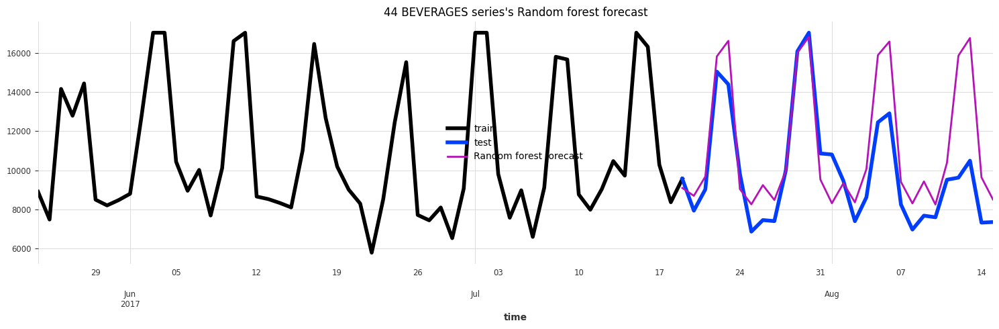

Lags: [-1, -2, -6, -7, -9, -13, -14, -21, -28]
settimane e giorni
model Random forest obtains MAPE: 11.38


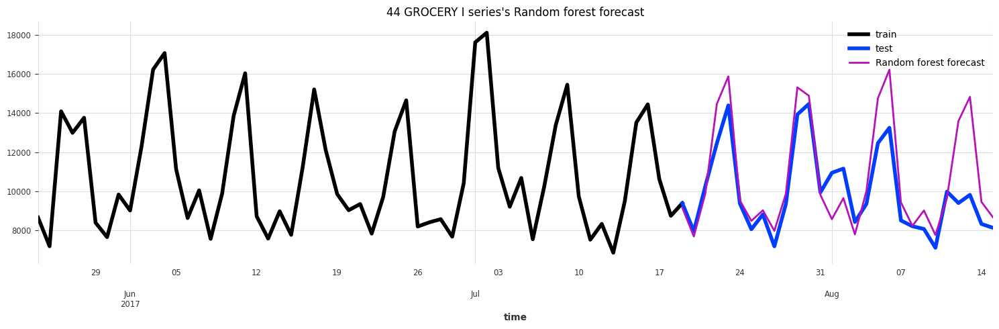

807
Lags: [-2, -3, -4, -5, -6, -7, -8, -14, -21, -28, -30]
settimane e giorni
model Random forest obtains MAPE: 6.87


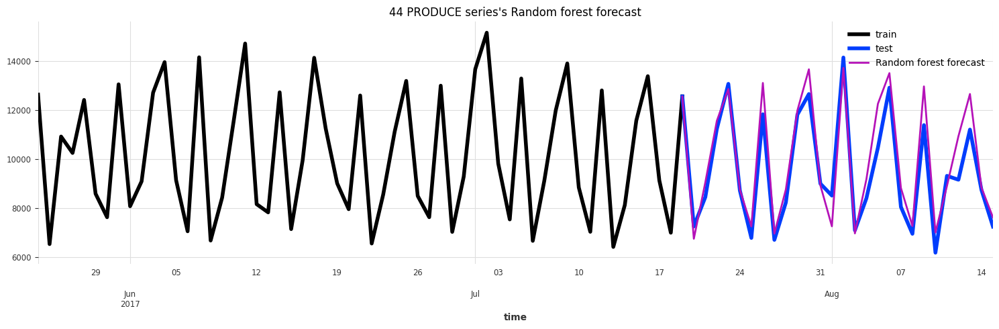

Lags: [-1, -2, -3, -5, -6, -7, -8, -13, -14, -15, -22]
settimane e giorni
model Random forest obtains MAPE: 12.93


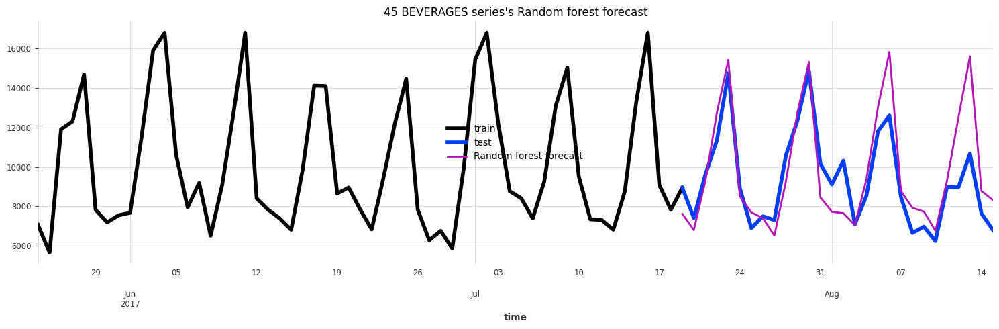

Lags: [-1, -2, -5, -6, -7, -8, -9, -13, -14, -28]
settimane e giorni
model Random forest obtains MAPE: 8.48


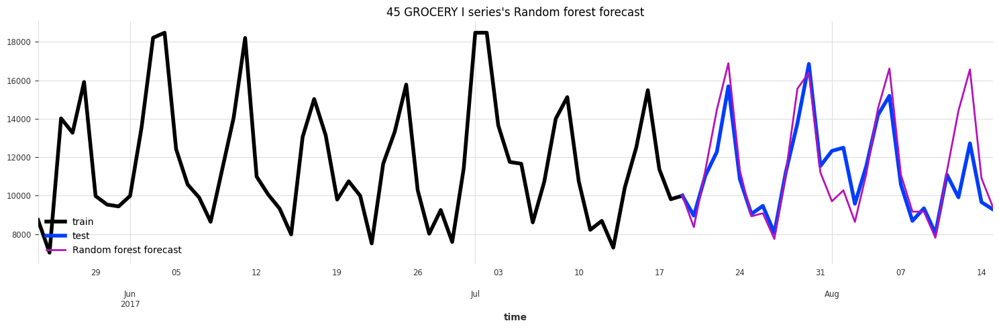

807
Lags: [-2, -3, -5, -7, -8, -14, -15, -21, -22]
settimane e giorni
model Random forest obtains MAPE: 7.24


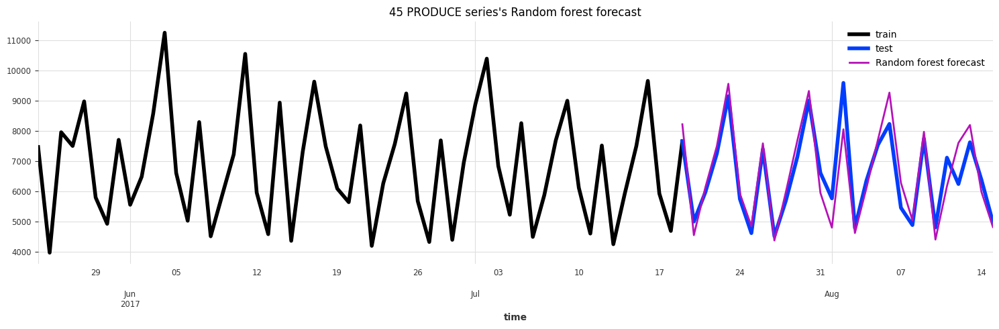

In [51]:
for product in dict_series_rf.keys():
    series = top_series[product]
    if 'PRODUCE'in product:
        series = series['2015-06-01':]
        print(len(series))
    lags_indexes = dict_series_rf[product]
    print('Lags:', lags_indexes)
    model_mape = functions.get_rf_predictions_no_diff(series=series, model_type='Bagging', lags_indexes=lags_indexes,
                                                     lags_future_covariates=[-2, -1, 0, +1, +2], fut_cov_days_only=False,
                                                      week_of_year=True)
    performance_dict['Bagging mape'].append(model_mape)

In [52]:
print(performance_dict['Bagging mape'],
      round(average(performance_dict['Bagging mape']), 2))

[17.13, 11.38, 6.87, 12.93, 8.48, 7.24] 10.67


settimane e giorni
model Random forest obtains MAPE: 9.44


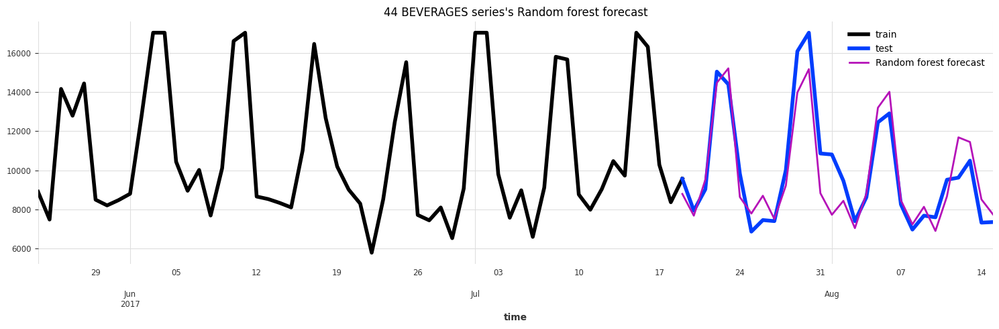

settimane e giorni
model Random forest obtains MAPE: 8.52


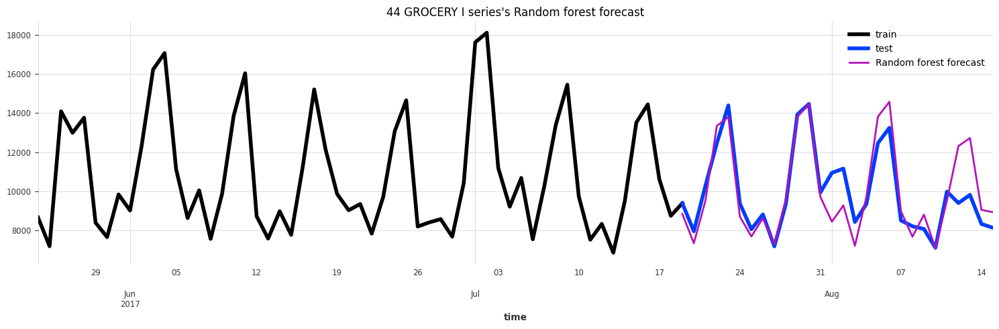

807
settimane e giorni
model Random forest obtains MAPE: 6.23


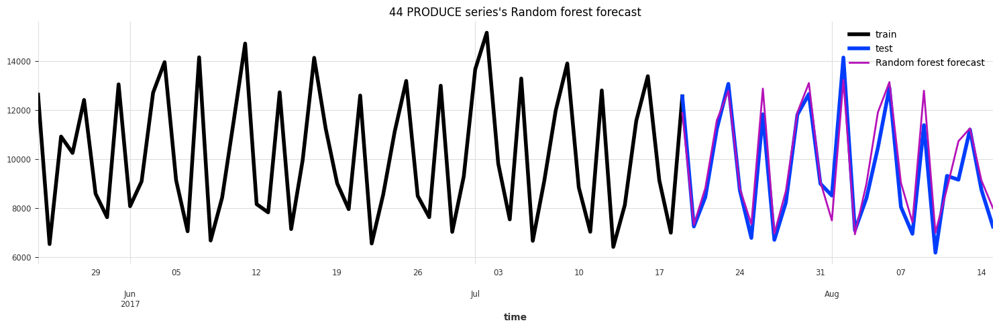

settimane e giorni
model Random forest obtains MAPE: 8.73


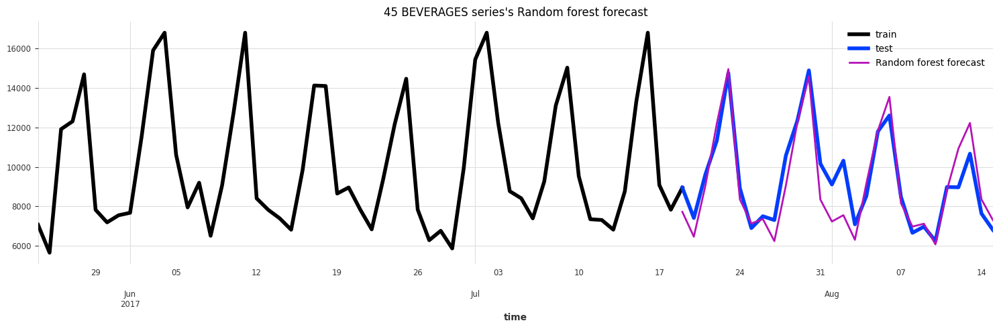

settimane e giorni
model Random forest obtains MAPE: 6.94


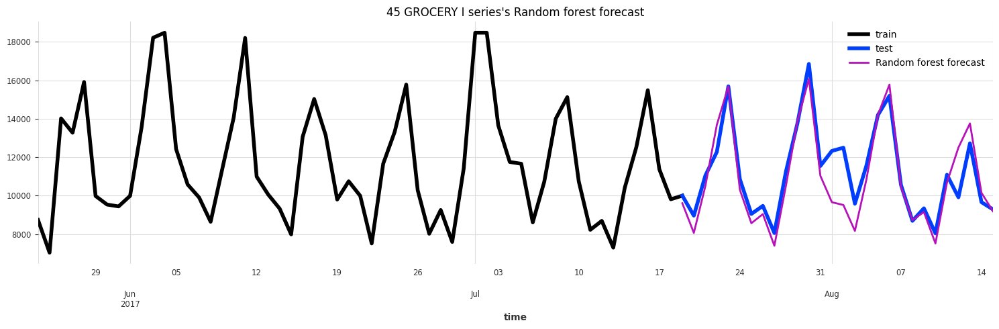

807
settimane e giorni
model Random forest obtains MAPE: 5.89


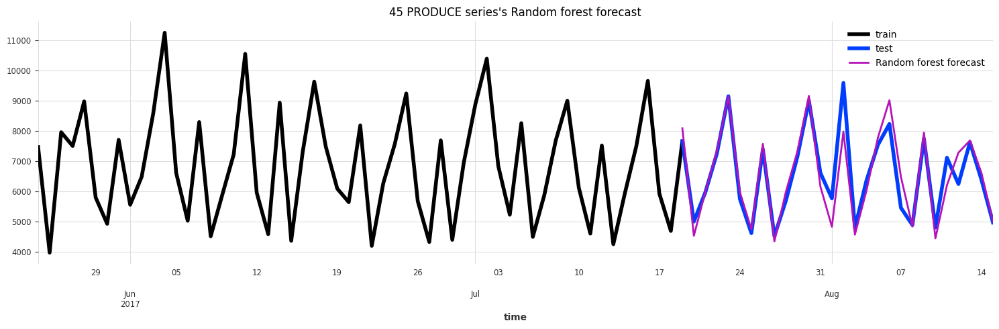

In [53]:
performance_dict['Random Forest mape'] = []
for product in dict_series_rf.keys():
    series = top_series[product]
    if 'PRODUCE'in product:
        series = series['2015-06-01':]
        print(len(series))
    lags_indexes = dict_series_rf[product]
    model_mape = functions.get_rf_predictions_no_diff(series=series, lags_indexes=lags_indexes,
                                       lags_future_covariates=[-2, -1, 0, +1, +2], fut_cov_days_only=False, week_of_year=True)
    performance_dict['Random Forest mape'].append(model_mape)

In [54]:
round(average(performance_dict['Random Forest mape']), 2)

7.62

In [55]:
performance_dict['Random Forest mape']

[9.44, 8.52, 6.23, 8.73, 6.94, 5.89]

**DATAFRAME DELLE PERFORMANCE**

In [56]:
df_performance = pd.DataFrame(performance_dict)
df_performance

,Series,Baseline mape,Arima mape cov days,Arima mape scaled data,Arima mape scaled data and weeks,Random forest diff and weeks mape,Bagging mape,Random Forest mape
0,44 BEVERAGES,23.47,19.57,19.77,13.24,11.67,17.13,9.44
1,44 GROCERY I,12.06,9.99,11.00,10.35,18.99,11.38,8.52
2,44 PRODUCE,7.33,6.62,6.50,6.38,7.45,6.87,6.23
3,45 BEVERAGES,15.54,13.83,13.76,7.86,22.61,12.93,8.73
4,45 GROCERY I,11.05,7.89,8.17,8.95,10.03,8.48,6.94
5,45 PRODUCE,8.72,7.00,7.09,7.99,6.03,7.24,5.89


In generale il mape raggiunto dopo aver scalato la serie è leggermente inferiore a quello senza scaling.

**Da quanto si evince dai valori di mape ottenuti dai diversi algoritmi non c'è un modello che performa meglio in assoluto**

**REGRESSIONE CON PAST COVARIATES**

Le past covariates possono essere sfruttate da alcuni modelli di darts come il Random Forest.
Come esempio useremo la serie che raggiunge il mape minore con il Random Forest: 44 PRODUCE.

In [57]:
round(corrcoef(top_series['44 PRODUCE'][7:], top_series['45 PRODUCE'].shift(7)[7:])[1][0], 2)

0.89

Creo una ts con valori riferiti allo store 45 e alla categoria di prodotto 'PRODUCE', infatti la serie laggata di un giorno ha correlazione all'81% con la '44 PRODUCE', quella laggata di una settimana dell'88%.

Utilizziamo '45 PRODUCE' come covariata.

Trasliamo la serie 45 PRODUCE di 28 giorni in modo tale da usare sempre valori certi per le previsioni.

**VALUTIAMO LA CORRELAZIONE**

In [58]:
prod_45_shift = top_series['45 PRODUCE'].shift(28)[28:]

In [59]:
prod_44_corr_prod_45 = round(corrcoef(top_series['44 PRODUCE'][28:], prod_45_shift)[1][0], 2)
prod_44_corr_prod_45

0.65

Prima otteniamo le previsioni per la serie da usare come past covariate in modo tale da usarla correttamente anche per i giorni previsti successivi al primo.
La miglior predizione in termini di mape di 45 PRODUCE è stata fatta dal modello Arima, perciò useremo nuovamente tale modello.

In [60]:
diff_series_45 = dict_diff_series['45 PRODUCE'][0]
lags_indexes = dict_diff_series['45 PRODUCE'][3]

pred_45 = functions.get_predictions_for_past_cov(diff_series=diff_series_45, model_type='Arima',
                                       lags_indexes=lags_indexes, to_scale=True)
#ora pred_45 è una serie differenziata

Calcoliamo la correlazione tra la serie 44 PRODUCE differenziata e la serie 45 PRODUCE differenziata e shiftata di 28 giorni, per capire se è utile usarla come covariata in base al valore della correlazione.

In [61]:
diff_series_44 = dict_diff_series['44 PRODUCE'][0]
diff_series_45_shift = diff_series_45.shift(7)[7:]
prod_44_corr_prod_45_diff = round(corrcoef(diff_series_44[7:], diff_series_45_shift)[1][0], 2)
prod_44_corr_prod_45_diff

0.77

La correlazione con shift di 28 giorni è abbastanza bassa: 0.56

La correlazione con shift di 14 giorni aumenta: 0.68

La correlazione con shift di 7 giorni è ancora maggiore: 0.73

In [62]:
prod_44_diff_corr_prod_45_shift = round(corrcoef(diff_series_44[23:], prod_45_shift)[1][0], 2)
prod_44_diff_corr_prod_45_shift

#diff_series_44[27:] dà errore

0.03

La correlazione è minima, dunque useremo come past covariate la serie 45 PRODUCE differenziata e shiftata di 28, 14 e 7 giorni.

Creazione past covariate series

In [63]:
series_45_diff = TimeSeries.from_series(diff_series_45, freq='D', fill_missing_dates=True)

In [64]:
past_cov = series_45_diff[:-28].concatenate(other=pred_45)

**RANDOM FOREST WITH PAST COVARIATES**

model Random Forest obtains MAPE: 8.68


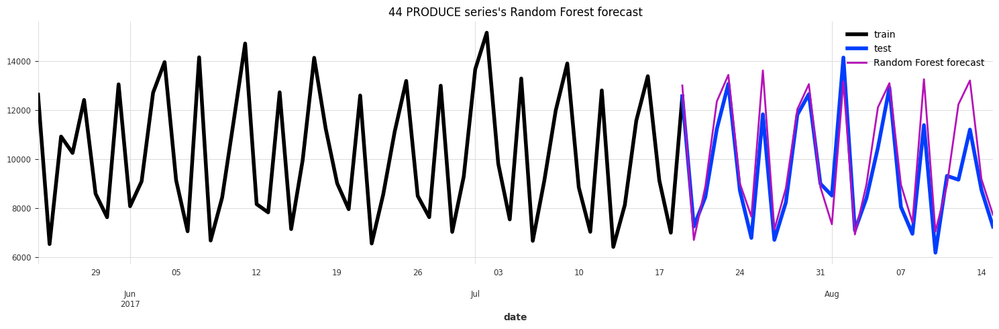

In [65]:
diff_series = dict_diff_series['44 PRODUCE'][0]
lags_indexes = dict_diff_series['44 PRODUCE'][3]

model_mape = functions.get_model_predictions(diff_series=diff_series, model_type='Random Forest', lags_indexes=lags_indexes,
                                   lags_past_covariates=[-28, -14, -7], past_covariates=past_cov)

model Random Forest obtains MAPE: 6.34


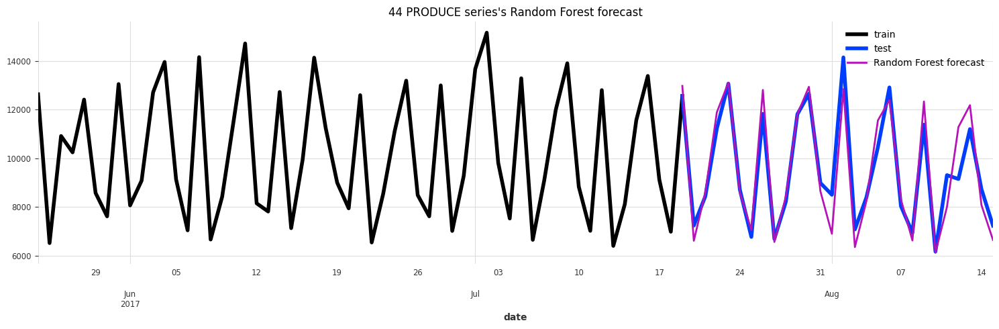

In [66]:
model_mape = functions.get_model_predictions(diff_series=diff_series, model_type='Random Forest', lags_indexes=lags_indexes,
                                   lags_past_covariates=[-14, -7], past_covariates=past_cov)

anno e giorni
model Random Forest obtains MAPE: 7.08


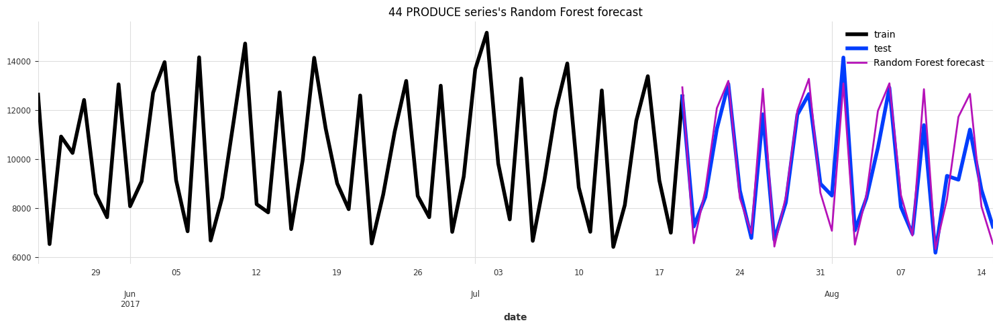

In [67]:
model_mape = functions.get_model_predictions(diff_series=diff_series, model_type='Random Forest', lags_indexes=lags_indexes,
                                   lags_future_covariates=[-7, 0], fut_cov_days_only=False,
                                   lags_past_covariates=[-7], past_covariates=past_cov)

Usare lag della serie più correlata come covariate non aiuta a migliorare la predizione dato che il mape aumenta nel caso migliore da 7.07 a 7.56

**RECURRENT NEURAL NETWORK**

RNNModel is fully recurrent in the sense that, at prediction time, an output is computed using these inputs:

RNNModel which always uses an output_chunk_length of 1

*the previous target value, which will be set to the last known target value for the first prediction, and for all other predictions it will be set to the previous prediction*

*the previous hidden state*

*the current covariates (if the model was trained with covariates)*

A prediction with forecasting horizon n is created in n iterations of RNNModel predictions and requires n future covariates to be known. This model is suited for forecasting problems where the target series is highly dependent on covariates that are known in advance.

Knowing the month tells us a lot about the seasonal component, whereas the year determines the effect of the trend component. Both of these covariates are known in the future, and thus the RNNModel class is the preferred choice for this problem.

Training di una rete neurale LSTM

per quanto riguarda max_samples_per_ts:
Having “long” target series can result in a very large number of training sequences / samples. You can set an upper bound for the number of sequences / samples per target that the model should be trained on with fit() parameter max_samples_per_ts. This will take the most recent sequences for every target series (sequences closest to target end).

**E' meglio differenziare la serie per la rete neurale**

Usually neural networks tend to work better on normalised/standardised data. Here we’ll use the Scaler class to normalise both of our time series between 0 and 1: [https://unit8co.github.io/darts/examples/01-multi-time-series-and-covariates.html]

I parametri batch_size e n_epochs controllano l'apprendimento in maniera inversa, se aumenta uno è meglio diminuire l'altro

In [68]:
performance_dict['LSTM no val mape'] = []
performance_dict['LSTM mape'] = []

2023-04-03 11:51:26 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:51:26 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:51:26 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:51:26 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:51:26 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

2023-04-03 11:51:35 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 11it [00:00, ?it/s]

model LSTM obtains MAPE: 14.26


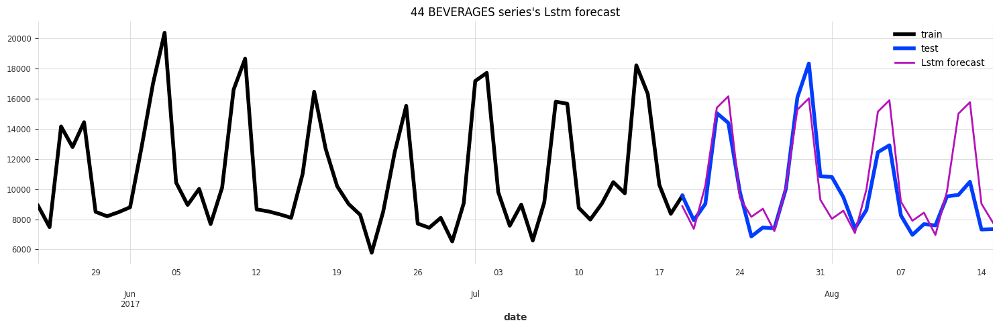

2023-04-03 11:51:35 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:51:35 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:51:35 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:51:35 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:51:35 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

2023-04-03 11:51:44 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 11it [00:00, ?it/s]

model LSTM obtains MAPE: 14.75


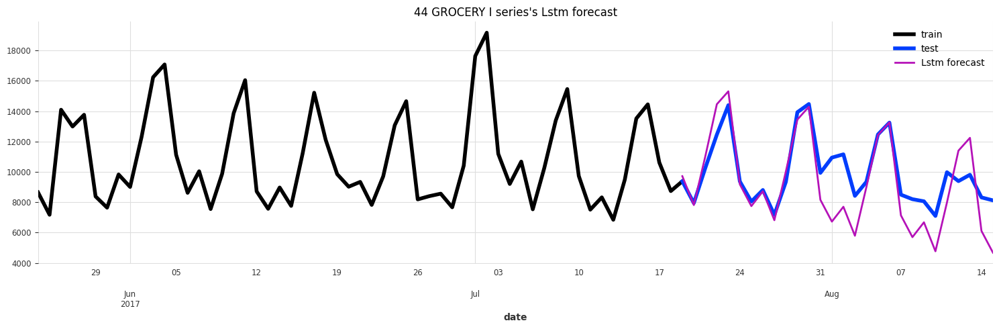

2023-04-03 11:51:45 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:51:45 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:51:45 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:51:45 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:51:45 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


804


Training: 0it [00:00, ?it/s]

2023-04-03 11:51:49 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

model LSTM obtains MAPE: 17.32


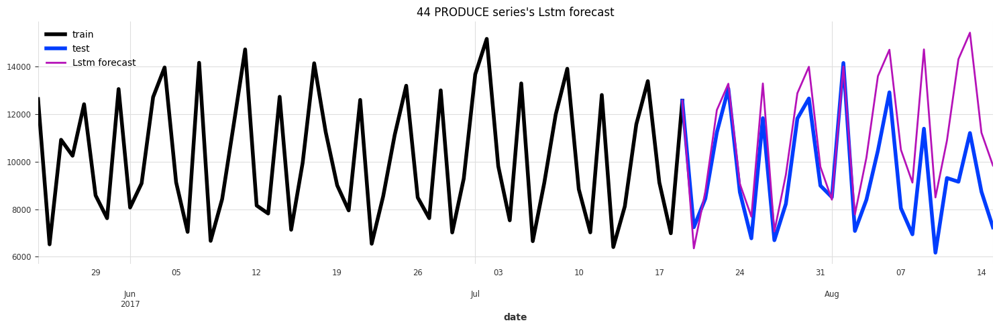

2023-04-03 11:51:50 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:51:50 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:51:50 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:51:50 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:51:50 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

2023-04-03 11:51:58 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 11it [00:00, ?it/s]

model LSTM obtains MAPE: 12.73


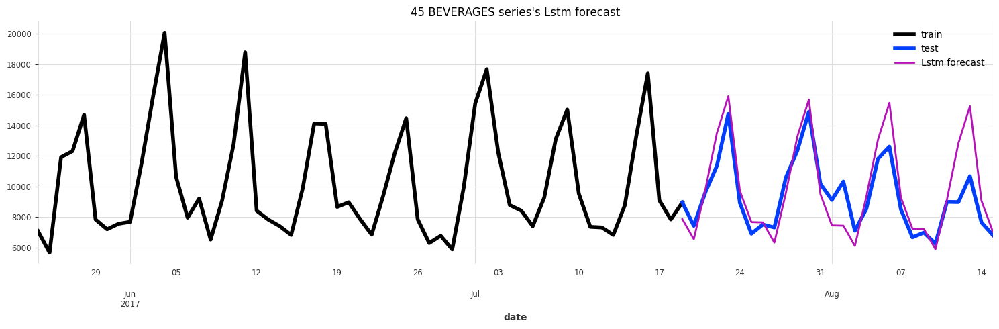

2023-04-03 11:51:59 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:51:59 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:51:59 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:51:59 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:51:59 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

2023-04-03 11:52:07 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 11it [00:00, ?it/s]

model LSTM obtains MAPE: 24.92


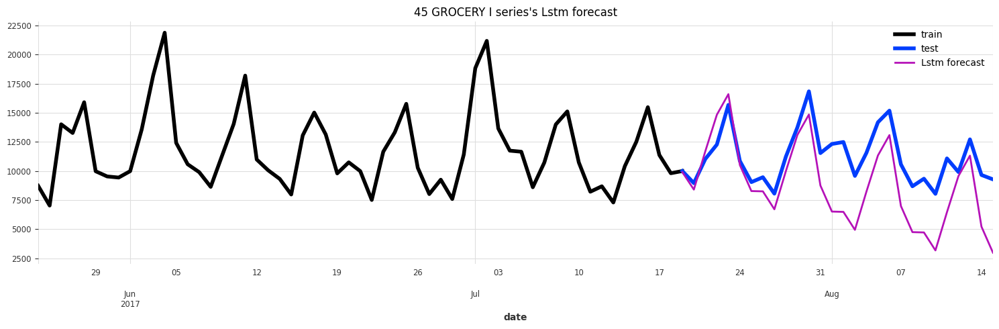

2023-04-03 11:52:08 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:52:08 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:52:08 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:52:08 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:52:08 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


804


Training: 0it [00:00, ?it/s]

2023-04-03 11:52:12 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

model LSTM obtains MAPE: 31.34


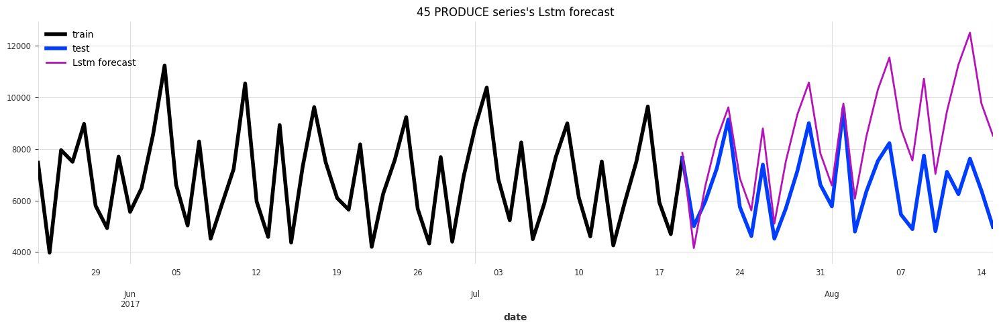

In [69]:
for series in dict_diff_series.keys():
    diff_series = dict_diff_series[series][0]
    if 'PRODUCE'in series:
        diff_series = diff_series['2015-06-02':]
        print(len(diff_series))
    #lags_indexes = dict_diff_series[series][3]
    lags_indexes = lags_diff_series[series]

    lstm_mape = functions.get_rnn_predictions_diff(diff_series=diff_series, model_type='lstm', lags_indexes=lags_indexes,
                                      fut_cov_days_only=True, to_scale=True)
    performance_dict['LSTM no val mape'].append(lstm_mape)

**FARE IL TRAINING DELLA LSTM CON UN VALIDATION SET**

2023-04-03 11:52:13 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:52:13 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:52:13 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:52:13 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:52:13 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


13
88


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

2023-04-03 11:52:30 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.
2023-04-03 11:52:30 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:52:30 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:52:30 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:52:30 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

model LSTM obtains MAPE: 13.71


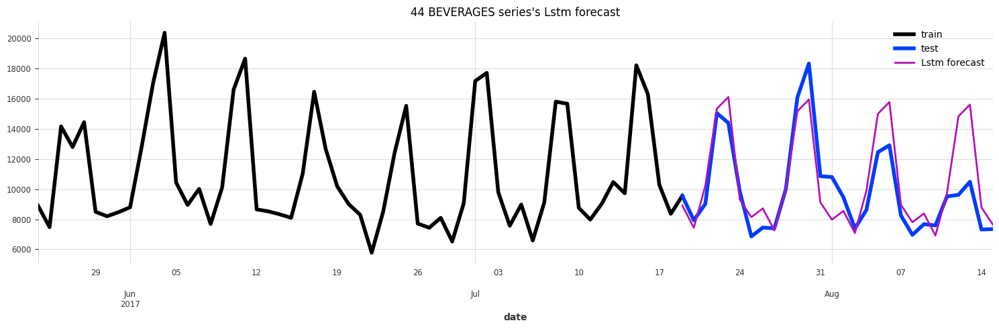

2023-04-03 11:52:31 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:52:31 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:52:31 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:52:31 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:52:31 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


13
88


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

2023-04-03 11:52:49 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.
2023-04-03 11:52:49 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:52:49 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:52:49 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:52:49 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

model LSTM obtains MAPE: 12.83


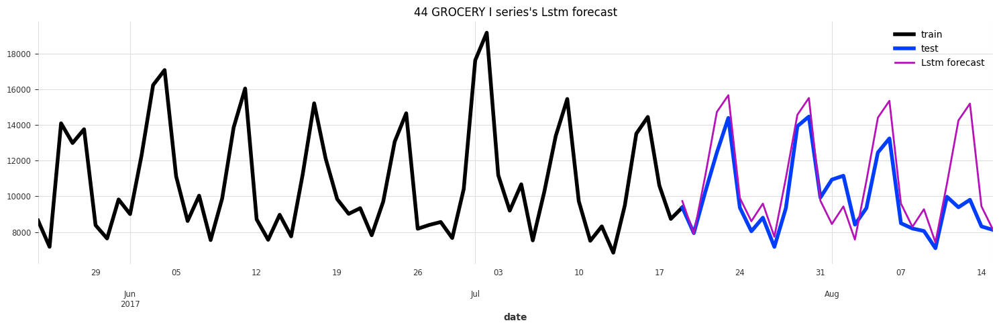

2023-04-03 11:52:49 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:52:49 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:52:49 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:52:49 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:52:49 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


804
13
88


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

2023-04-03 11:53:07 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.
2023-04-03 11:53:07 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:53:07 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:53:07 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:53:07 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

model LSTM obtains MAPE: 6.55


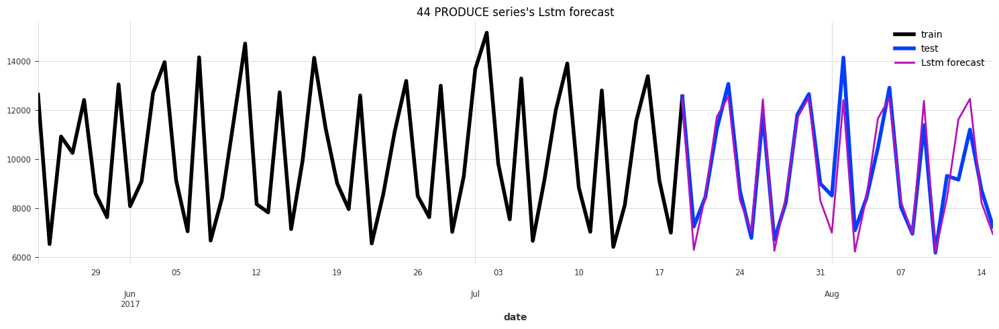

2023-04-03 11:53:07 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:53:07 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:53:07 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:53:07 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:53:07 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


13
88


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

2023-04-03 11:53:25 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.
2023-04-03 11:53:25 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:53:25 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:53:25 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:53:25 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

model LSTM obtains MAPE: 12.81


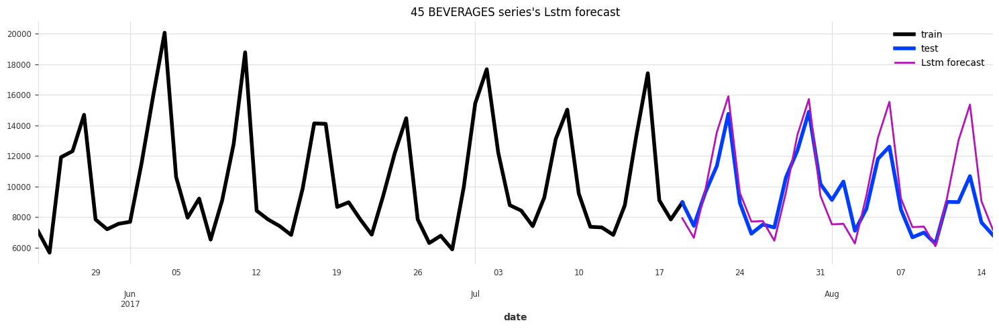

2023-04-03 11:53:26 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:53:26 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:53:26 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:53:26 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:53:26 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


13
88


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

2023-04-03 11:53:43 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.
2023-04-03 11:53:43 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:53:43 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:53:43 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:53:43 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

model LSTM obtains MAPE: 9.14


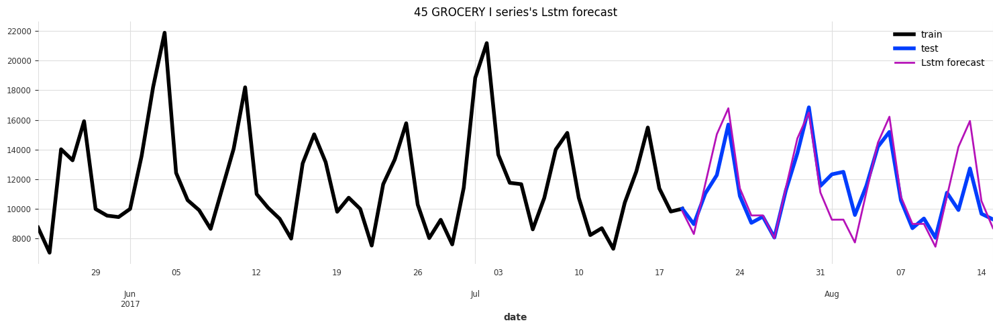

2023-04-03 11:53:44 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:53:44 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:53:44 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:53:44 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:53:44 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


804
13
88


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

2023-04-03 11:54:01 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.
2023-04-03 11:54:01 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:54:01 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:54:01 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:54:01 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

model LSTM obtains MAPE: 9.28


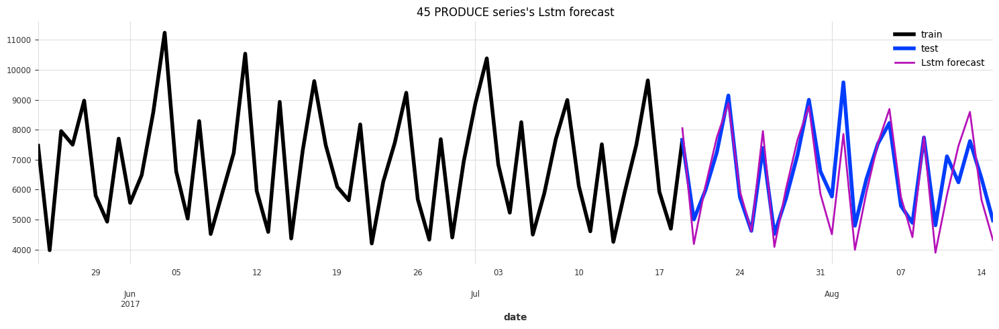

In [70]:
mape_lstm = []
for series in dict_diff_series.keys():
    diff_series = dict_diff_series[series][0]
    if 'PRODUCE'in series:
        diff_series = diff_series['2015-06-02':]
        print(len(diff_series))
    #lags_indexes = dict_diff_series[series][3]
    lags_indexes = lags_diff_series[series]
    mape = functions.get_rnn_predictions_val(diff_series=diff_series, model_type='lstm', lags_indexes=lags_indexes,
                                    fut_cov_days_only=True, week_of_year=False, to_scale=True)
    mape_lstm.append(mape)

In [71]:
#[15.53, 12.9, 8.31, 14.57, 10.79, 9.14] 11.87 serie non differenziata

In [72]:
print(mape_lstm, round(average(mape_lstm), 2))

[13.71, 12.83, 6.55, 12.81, 9.14, 9.28] 10.72


In [73]:
performance_dict['LSTM mape'] = mape_lstm

In [74]:
def get_rnn_predictions_val(diff_series: pd.Series, lags_indexes: list,
                            model_type: str = 'lstm', to_scale: bool = True, fut_cov_days_only: bool = True,
                            week_of_year: bool = False, return_pred: bool = False,
                            past_covariates: TimeSeries = None):
    # nome serie
    name = diff_series.name

    # Creazione ts darts
    series = TimeSeries.from_series(diff_series, freq='D', fill_missing_dates=True)

    # serie non differenziata
    original_series = TimeSeries.from_dataframe(df=top_series, value_cols=name, freq='D', fill_missing_dates=True)

    # Divisione train e test
    #train = series[-392:-28]  # un anno di dati = 52 settimane; /4 per trovare max_samples
    train = series[:-28]
    test = series[-28:]
    #validation = series[-42:-14]  # un mese di validation #-42
    validation = series[-28:]
    
    # Scalatura dei dati, è meglio fare il fit solo sul train
    if to_scale == True:
        scaler = Scaler()
        train = scaler.fit_transform(train)
        validation = scaler.transform(validation)

    # Aggiunta covariate future
    fut_cov = functions.get_datetime_series(series=series, days_only=fut_cov_days_only, week_of_year=week_of_year)

    # Previsione RNN
    chunk_lenght = abs(lags_indexes[-1])
    print(chunk_lenght)

    model_type = model_type.upper()
    rnn = RNNModel(model=model_type,
                   hidden_dim=20,  # 20, 25
                   n_rnn_layers=1,  # 2
                   dropout=0.025,  # 0.1
                   batch_size=8,  # 16
                   n_epochs=60,  # 60, 30
                   # loss_fn=nn.L1Loss(),
                   loss_fn=nn.MSELoss(),
                   optimizer_kwargs={"lr": 1e-3},
                   random_state=42,
                   input_chunk_length=chunk_lenght,
                   output_chunk_length=1,
                   model_name="Sales_RNN",
                   log_tensorboard=True,
                   force_reset=True,
                   save_checkpoints=True
                   )

    # consideriamo solo gli ultimi 80 samples circa per il training
    max_samples = int(((len(train) + 1) - chunk_lenght) / 20)  # 20 se train = series[:-28] #4
    #max_samples = None
    print(max_samples)

    # fit e predict
    rnn.fit(train, future_covariates=fut_cov, max_samples_per_ts=max_samples,
            val_series=validation, val_future_covariates=fut_cov, verbose=True)

    # Use the best model obtained over training, according to validation loss:
    best_model = RNNModel.load_from_checkpoint(model_name="Sales_RNN", best=True)

    pred = best_model.predict(n=28, future_covariates=fut_cov)

    # Invertire la scalatura dei dati
    if to_scale == True:
        pred = scaler.inverse_transform(pred)

    # Predizioni non differenziate
    pred = functions.get_not_diff_predictions(pred=pred, series_name=name)

    # Calcolo mape come metrica di errore
    test = original_series[-28:]
    model_mape = functions.measure_mape(model=model_type, test=test, pred=pred)

    # Rappresentazione grafica
    functions.plot_predictions(series=original_series, test=test, pred=pred, model='Lstm')

    if return_pred == True:
        return pred.pd_series()

    return model_mape

In [75]:
# mape_lstm = []
# for series in dict_diff_series.keys():
#     diff_series = dict_diff_series[series][0]
# #     if 'PRODUCE'in series:
# #         diff_series = diff_series['2015-06-02':]
# #         print(len(diff_series))
#     lags_indexes = dict_diff_series[series][3]
#     #lags_indexes = lags_diff_series[series]
#     mape = get_rnn_predictions_val(diff_series=diff_series, model_type='lstm', lags_indexes=lags_indexes,
#                                     fut_cov_days_only=True, week_of_year=False, to_scale=True)
#     mape_lstm.append(mape)

In [76]:
print(mape_lstm, round(average(mape_lstm), 2))

[13.71, 12.83, 6.55, 12.81, 9.14, 9.28] 10.72


[13.71, 12.83, 6.55, 12.81, 9.14, 9.28] 10.72

In [77]:
# performance_dict['Series'] = [
#    '44 BEVERAGES',
#   '44 GROCERY I',
#   '44 PRODUCE',
#   '45 BEVERAGES',
#   '45 GROCERY I',
#   '45 PRODUCE']

In [78]:
df_performance = pd.DataFrame(performance_dict)
df_performance

,Series,Baseline mape,Arima mape cov days,Arima mape scaled data,Arima mape scaled data and weeks,Random forest diff and weeks mape,Bagging mape,Random Forest mape,LSTM no val mape,LSTM mape
0,44 BEVERAGES,23.47,19.57,19.77,13.24,11.67,17.13,9.44,14.26,13.71
1,44 GROCERY I,12.06,9.99,11.00,10.35,18.99,11.38,8.52,14.75,12.83
2,44 PRODUCE,7.33,6.62,6.50,6.38,7.45,6.87,6.23,17.32,6.55
3,45 BEVERAGES,15.54,13.83,13.76,7.86,22.61,12.93,8.73,12.73,12.81
4,45 GROCERY I,11.05,7.89,8.17,8.95,10.03,8.48,6.94,24.92,9.14
5,45 PRODUCE,8.72,7.00,7.09,7.99,6.03,7.24,5.89,31.34,9.28


In [79]:
pd.DataFrame(df_performance.mean().rename('Mean')).rename_axis('Model').sort_values(by='Mean', ascending=True).reset_index()

,Model,Mean
0,Random Forest mape,7.62
1,Arima mape scaled data and weeks,9.13
2,Bagging mape,10.67
3,LSTM mape,10.72
4,Arima mape cov days,10.82
5,Arima mape scaled data,11.05
6,Random forest diff and weeks mape,12.80
7,Baseline mape,13.03
8,LSTM no val mape,19.22


Mediamente il modello che performa meglio è il Random Forest che utilizza anche le settimane come covariate.

**PREDIZIONE CON LA SHORT SERIES**

Consideriamo solo i dati del 2017

In [80]:
#dict_diff_last_months = {}
dict_last_months = {}

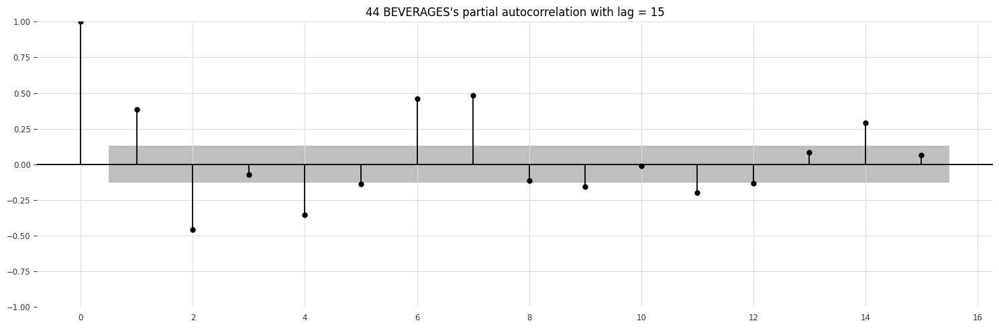

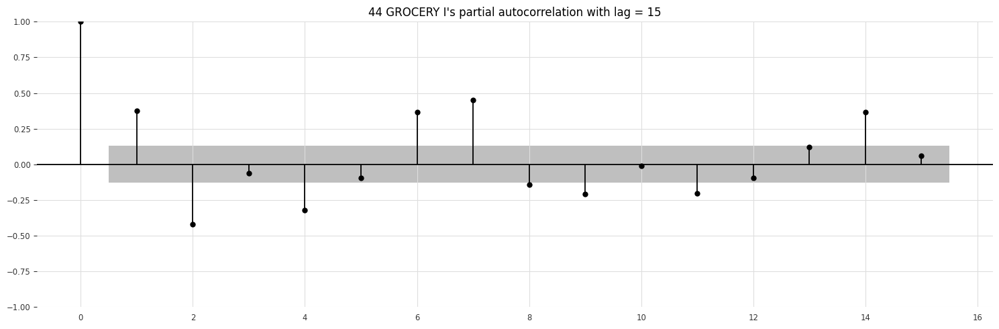

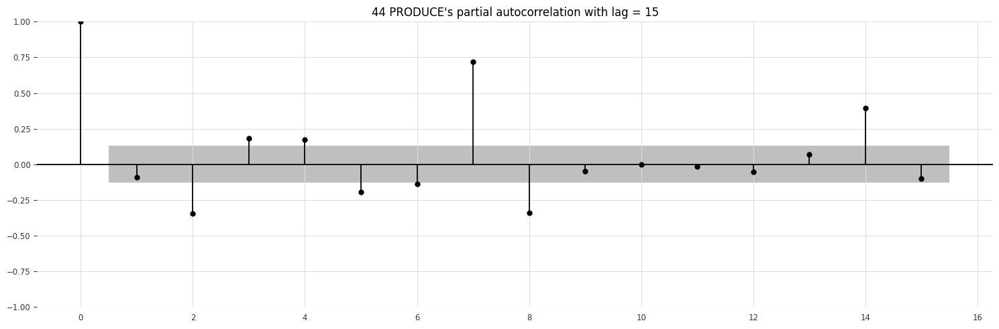

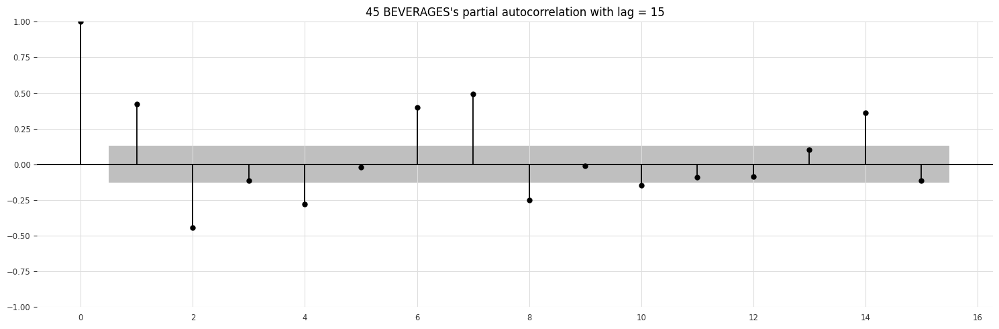

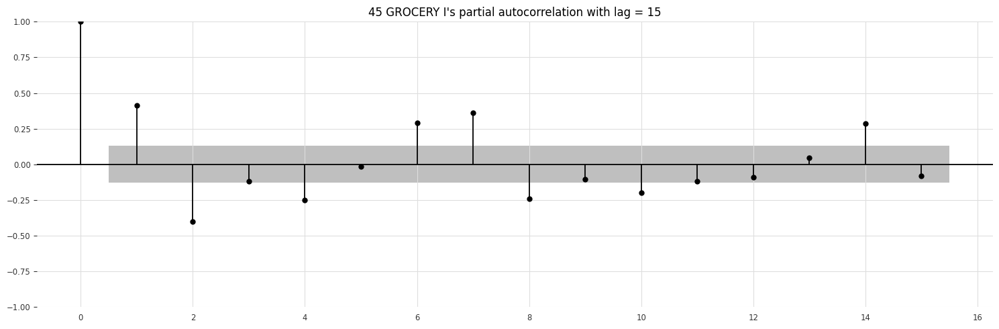

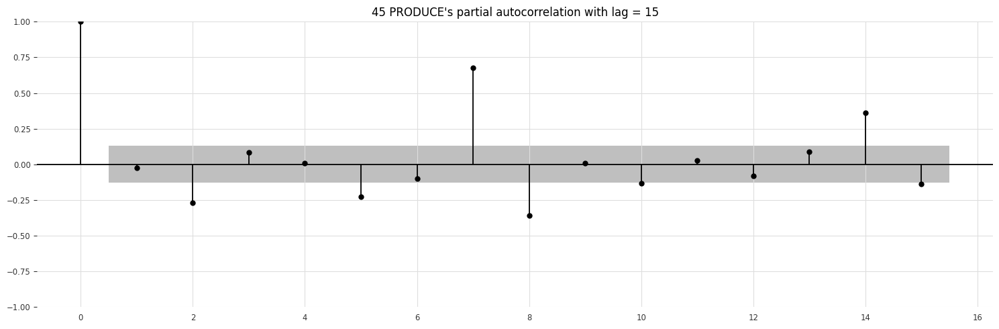

In [81]:
for product in top_series.columns:
    short_series, lags_ac, lags_pac, lags_indexes_pac = functions.check_autocorrelation_short_series(series=product)
    dict_last_months[product] = (short_series, lags_ac, lags_pac, lags_indexes_pac)

In [82]:
#performance_dict['short series arima mape'] = []
#performance_dict['short series rf mape'] = []

[-1, -2, -4, -6, -7, -14]
settimane e giorni
model Random forest obtains MAPE: 15.62


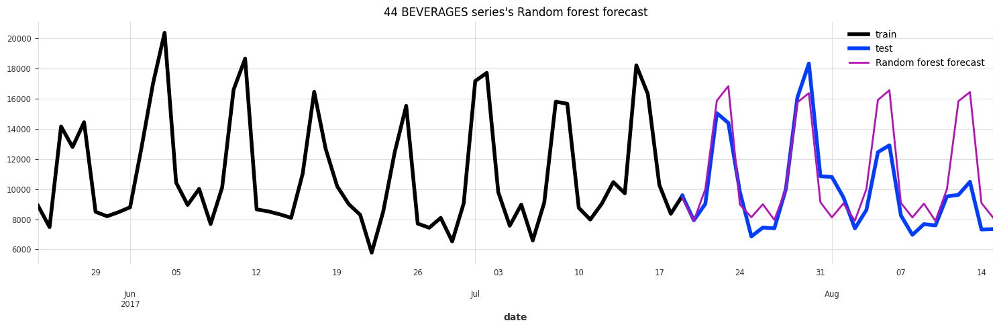

[-1, -2, -4, -6, -7, -14]
settimane e giorni
model Random forest obtains MAPE: 10.99


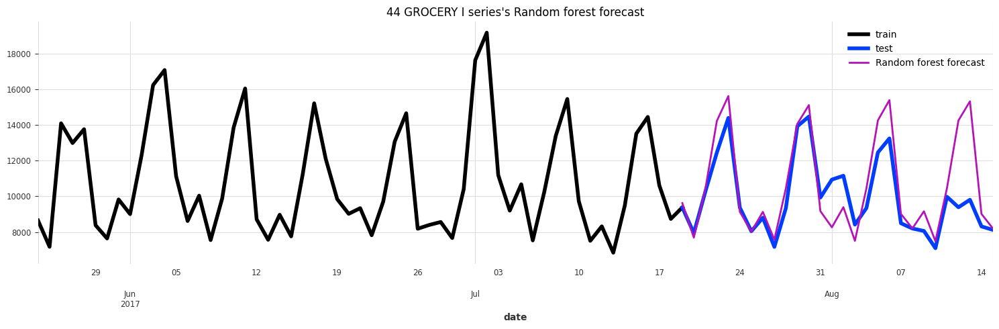

[-2, -7, -8, -14]
settimane e giorni
model Random forest obtains MAPE: 8.23


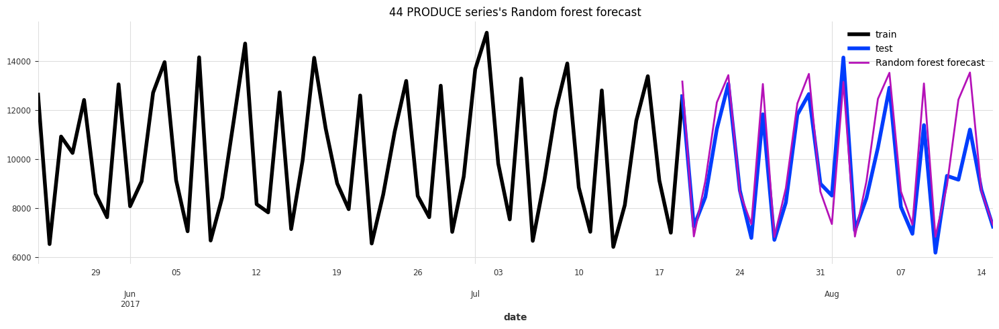

[-1, -2, -4, -6, -7, -14]
settimane e giorni
model Random forest obtains MAPE: 12.07


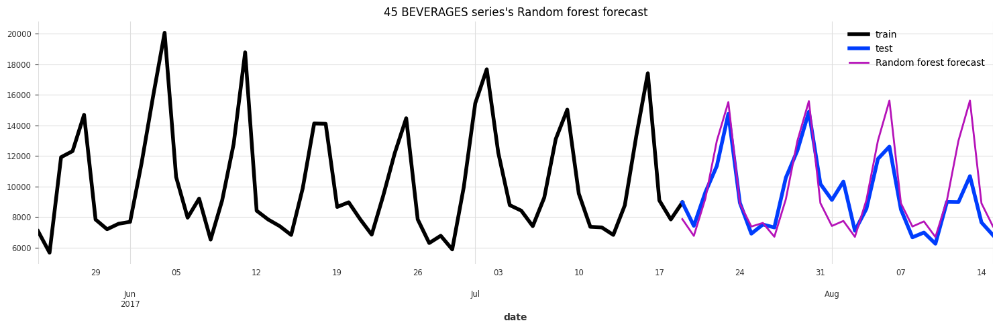

[-1, -2, -6, -7, -14]
settimane e giorni
model Random forest obtains MAPE: 8.85


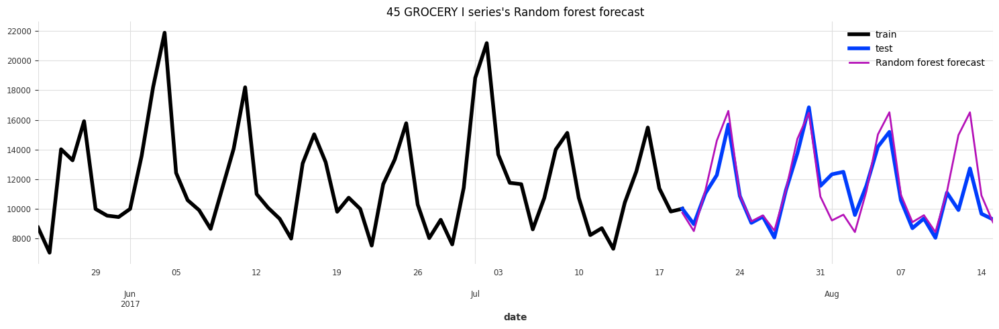

[-2, -7, -8, -14]
settimane e giorni
model Random forest obtains MAPE: 8.94


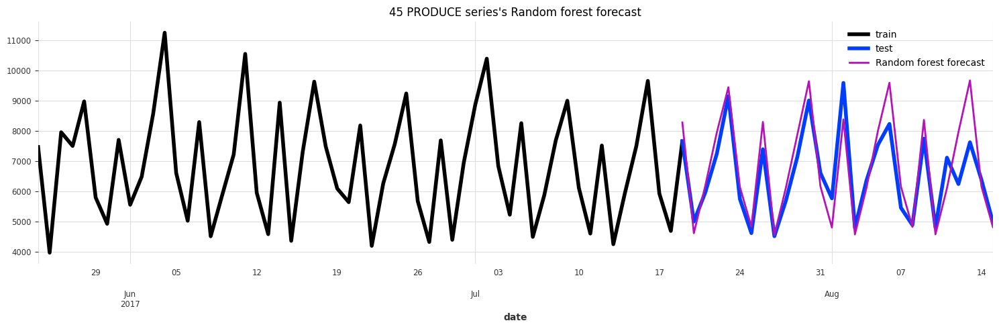

In [83]:
short_series_rf_mape = []
for series in dict_last_months.keys():
    short_series = dict_last_months[series][0]

    lags_indexes = dict_last_months[series][3]
    print(lags_indexes)

    mape = functions.get_rf_predictions_no_diff(series=short_series, model_type='random forest', lags_indexes=lags_indexes,
                                      lags_future_covariates=[-2, -1, 0, +1, +2], fut_cov_days_only=False, week_of_year=True, to_scale=False)
    short_series_rf_mape.append(mape)
    #performance_dict['short series rf mape'].append(mape)

In [84]:
# print(performance_dict['short series rf mape'],
#       round(average(performance_dict['short series rf mape']), 2))
print(short_series_rf_mape,
      round(average(short_series_rf_mape), 2))

[15.62, 10.99, 8.23, 12.07, 8.85, 8.94] 10.78


short series arima mape: [16.77, 10.39, 6.81, 12.65, 11.72, 9.23] 11.26

**SEASONAL ARIMA CON PARAMENTRI SELEZIONATI DA AUTO ARIMA**

ValueError: Invalid model: autoregressive lag(s) {7} are in both the seasonal and non-seasonal autoregressive components.

In [85]:
for series in dict_diff_series.keys():
    lags_idx = dict_diff_series[series][3]
    #lags_idx = lags_diff_series[series]
    print(series, lags_idx)

44 BEVERAGES [-2, -4, -5, -6, -7, -12, -13]
44 GROCERY I [-1, -2, -3, -4, -5, -6, -12, -13]
44 PRODUCE [-1, -2, -3, -6, -7, -14]
45 BEVERAGES [-2, -3, -4, -5, -6, -7, -13]
45 GROCERY I [-1, -2, -4, -5, -6, -12, -13]
45 PRODUCE [-1, -2, -3, -6, -7, -14]


In [86]:
# from sklearn.preprocessing import MinMaxScaler
# from sklearn.preprocessing import OneHotEncoder
# scaler = MinMaxScaler()
# encoder = OneHotEncoder()

# auto_best_params_dict = {}
# for series in dict_diff_series.keys():
#     diff_series = dict_diff_series[series][0]
#     if 'PRODUCE' in series:
#         diff_series = diff_series['2015-06-02':]
#         print(len(diff_series))
#     train = diff_series[:-28]
#     date = pd.Series(data=pd.to_datetime(train.index), index=train.index, name=train.name)
#     weekofyear = date.dt.isocalendar().week
#     dayofweek = date.dt.dayofweek
#     covariates = pd.concat([weekofyear, dayofweek], axis=1)
#     #print(covariates[:2])
#     covariates = covariates.to_numpy()
#     #print(covariates[:2])
#     covariates = encoder.fit_transform(covariates).toarray()
#     #print(covariates[:2])
#     #print(type(covariates))
    
#     train = train.to_numpy()
#     train = train.reshape(-1, 1)
#     train = scaler.fit_transform(train)
#     print(train[:2])
#     lags_indexes = dict_diff_series[series][3]
#     max_lag = abs(lags_indexes[-1])
    
    
#     arima = auto_arima(y=train, X=covariates, error_action='ignore', start_p=1, d=None, start_q=1, max_p=max_lag,
#                       max_d=2, max_q=max_lag, start_P=1, D=None, start_Q=1, max_P=3,
#                       max_D=1, max_Q=4, max_order=None, m=7, seasonal=True, stationary=True,
#                       stepwise=False, random=True, random_state=42, n_fits=10, trace=False
#                       )

#     s = str(arima.params)
#     n = re.findall("\d+", s)
#     n = list(map(int, n))
#     auto_best_params_dict[series] = n

In [87]:
# best_params_dict = {
#                     '44 BEVERAGES': [6, 0, 4, 2, 0, 1, 7],
#                     '44 GROCERY I': [6, 0, 4, 2, 0, 1, 7],
#                     '44 PRODUCE': [6, 0, 4, 2, 0, 1, 7],
#                     '45 BEVERAGES': [6, 0, 4, 2, 0, 1, 7],
#                     '45 GROCERY I': [6, 0, 4, 2, 0, 1, 7],
#                     '45 PRODUCE': [6, 0, 4, 2, 0, 1, 7]
# }

# best_params_dict

In [88]:
# auto_best_params_dict = {
#                     '44 BEVERAGES': [6, 0, 2, 2, 0, 1, 7],
#                     '44 GROCERY I': [6, 0, 2, 2, 0, 1, 7],
#                     '44 PRODUCE': [6, 0, 2, 2, 0, 1, 7],
#                     '45 BEVERAGES': [6, 0, 3, 2, 0, 2, 7],
#                     '45 GROCERY I': [6, 0, 3, 2, 0, 2, 7],
#                     '45 PRODUCE': [6, 0, 4, 2, 0, 1, 7]
# }

# auto_best_params_dict

In [89]:
#auto_best_params_dict con covariate X non codificate
# {'44 BEVERAGES': [5, 0, 4, 1, 0, 3, 7],
#  '44 GROCERY I': [5, 0, 4, 1, 0, 3, 7],
#  '44 PRODUCE': [5, 0, 4, 1, 0, 3, 7],
#  '45 BEVERAGES': [2, 0, 6, 1, 0, 0, 7],
#  '45 GROCERY I': [2, 0, 1, 1, 0, 2, 7],
#  '45 PRODUCE': [0, 0, 3, 1, 0, 2, 7]}

In [90]:
auto_best_params_dict = {'44 BEVERAGES': [4, 0, 6, 3, 0, 0, 7],
 '44 GROCERY I': [2, 0, 6, 1, 0, 0, 7],
 '44 PRODUCE': [2, 0, 6, 1, 0, 0, 7],
 '45 BEVERAGES': [4, 0, 6, 3, 0, 0, 7],
 '45 GROCERY I': [2, 0, 6, 1, 0, 0, 7],
 '45 PRODUCE': [2, 0, 6, 1, 0, 0, 7]}
auto_best_params_dict

{'44 BEVERAGES': [4, 0, 6, 3, 0, 0, 7],
 '44 GROCERY I': [2, 0, 6, 1, 0, 0, 7],
 '44 PRODUCE': [2, 0, 6, 1, 0, 0, 7],
 '45 BEVERAGES': [4, 0, 6, 3, 0, 0, 7],
 '45 GROCERY I': [2, 0, 6, 1, 0, 0, 7],
 '45 PRODUCE': [2, 0, 6, 1, 0, 0, 7]}

settimane e giorni
model best arima obtains MAPE: 14.66


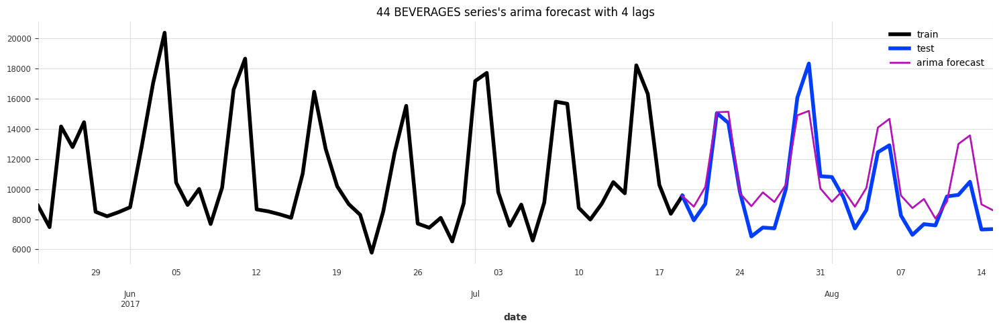

settimane e giorni
model best arima obtains MAPE: 10.36


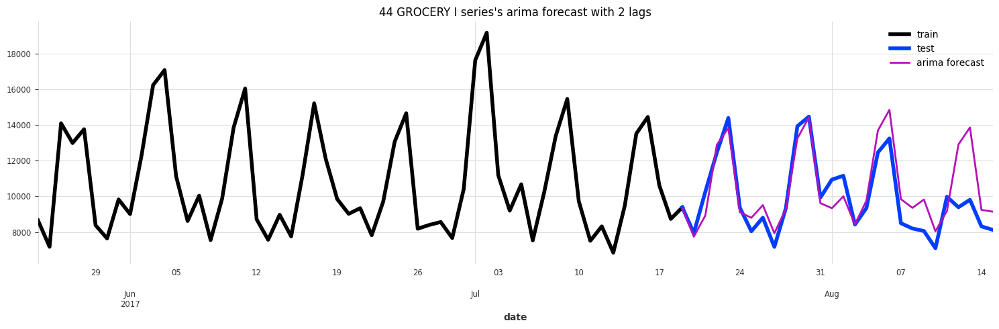

804
settimane e giorni
model best arima obtains MAPE: 6.54


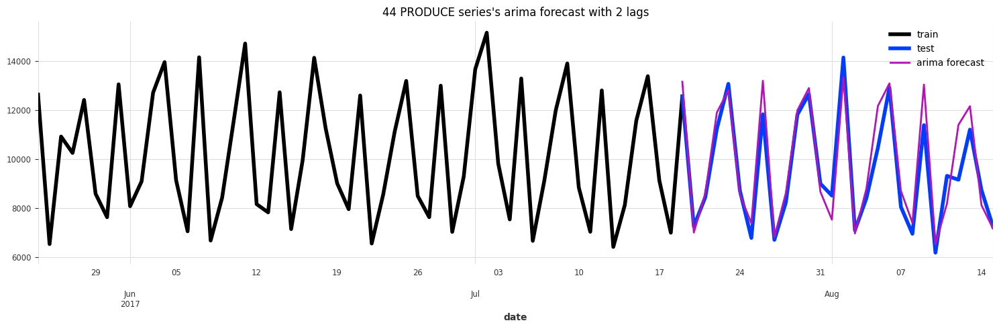

settimane e giorni
model best arima obtains MAPE: 9.32


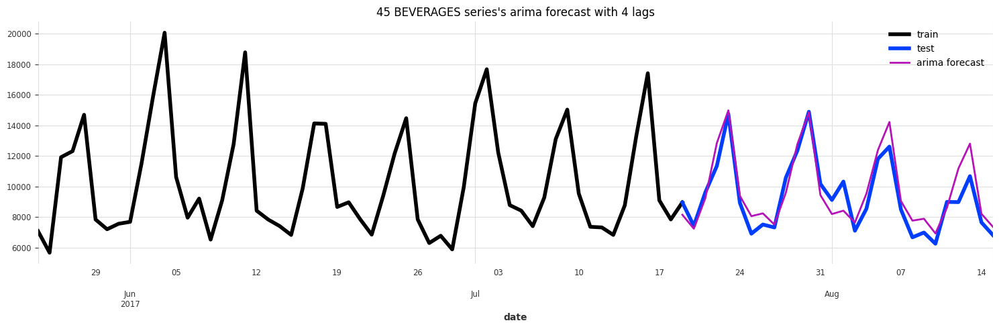

settimane e giorni
model best arima obtains MAPE: 8.41


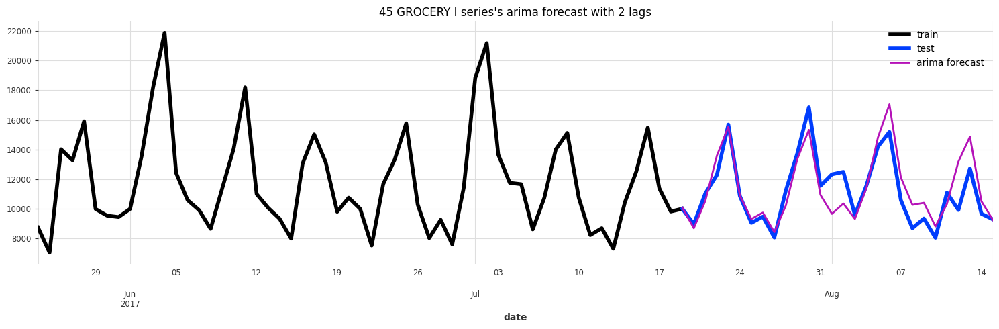

804
settimane e giorni
model best arima obtains MAPE: 7.43


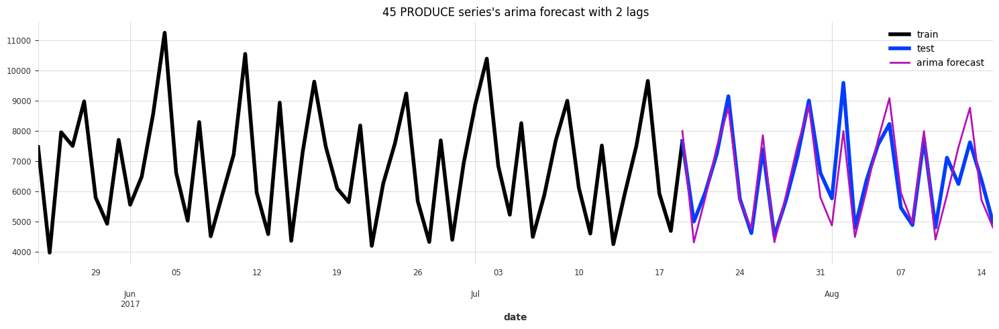

In [91]:
mape_auto_arima_7 = []
for series in dict_diff_series.keys():
    diff_series = dict_diff_series[series][0]
    if 'PRODUCE'in series:
        diff_series = diff_series['2015-06-02':]
        print(len(diff_series))
    #lags_indexes = dict_diff_last_months[series][3]
    
    best_params = auto_best_params_dict[series]
    mape = functions.get_arima_predictions(diff_series=diff_series, best_params=best_params,
                                           fut_cov_days_only=False, week_of_year=True, to_scale=True)
    mape_auto_arima_7.append(mape)

In [92]:
print(mape_auto_arima_7, round(average(mape_auto_arima_7), 2))

[14.66, 10.36, 6.54, 9.32, 8.41, 7.43] 9.45


In [93]:
performance_dict['auto arima mape'] = mape_auto_arima_7

In [94]:
df_performance = pd.DataFrame(performance_dict)

In [95]:
pd.DataFrame(df_performance.mean().rename('Mean')).rename_axis('Model') \
            .sort_values(by='Mean', ascending=True).reset_index()

,Model,Mean
0,Random Forest mape,7.62
1,Arima mape scaled data and weeks,9.13
2,auto arima mape,9.45
3,Bagging mape,10.67
4,LSTM mape,10.72
5,Arima mape cov days,10.82
6,Arima mape scaled data,11.05
7,Random forest diff and weeks mape,12.80
8,Baseline mape,13.03
9,LSTM no val mape,19.22


In [96]:
df_performance

,Series,Baseline mape,Arima mape cov days,Arima mape scaled data,Arima mape scaled data and weeks,Random forest diff and weeks mape,Bagging mape,Random Forest mape,LSTM no val mape,LSTM mape,auto arima mape
0,44 BEVERAGES,23.47,19.57,19.77,13.24,11.67,17.13,9.44,14.26,13.71,14.66
1,44 GROCERY I,12.06,9.99,11.00,10.35,18.99,11.38,8.52,14.75,12.83,10.36
2,44 PRODUCE,7.33,6.62,6.50,6.38,7.45,6.87,6.23,17.32,6.55,6.54
3,45 BEVERAGES,15.54,13.83,13.76,7.86,22.61,12.93,8.73,12.73,12.81,9.32
4,45 GROCERY I,11.05,7.89,8.17,8.95,10.03,8.48,6.94,24.92,9.14,8.41
5,45 PRODUCE,8.72,7.00,7.09,7.99,6.03,7.24,5.89,31.34,9.28,7.43


**XGBOOST**

In [97]:
#import lightgbm
#from xgboost import XGBRegressor

[-2, -4, -5, -6, -7, -12, -13] [-2, -4, -5, -6, -7, -12]
settimane e giorni
model Xgboost obtains MAPE: 18.80


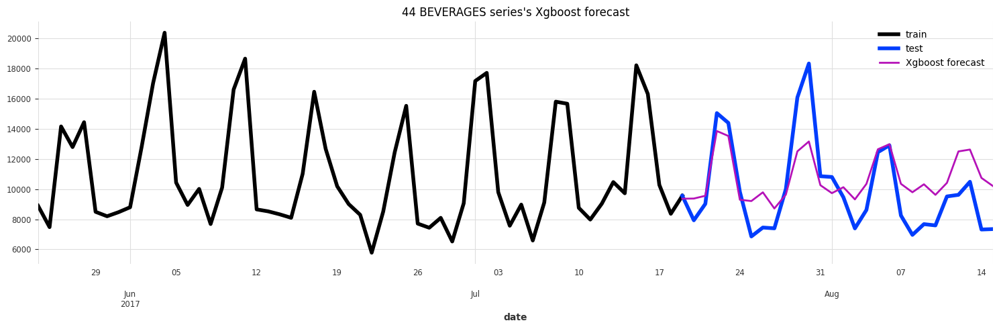

[-1, -2, -3, -4, -5, -6, -12, -13] [-1, -2, -3, -4, -5, -6, -12]
settimane e giorni
model Xgboost obtains MAPE: 25.54


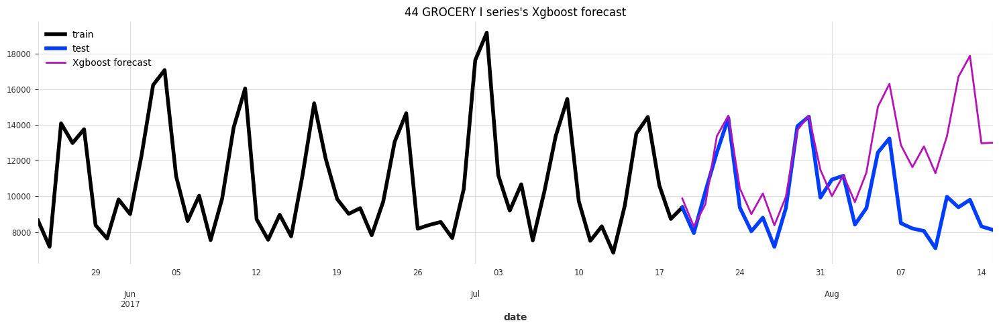

[-1, -2, -3, -6, -7, -13] [-1, -2, -3, -6, -7]
settimane e giorni
model Xgboost obtains MAPE: 8.42


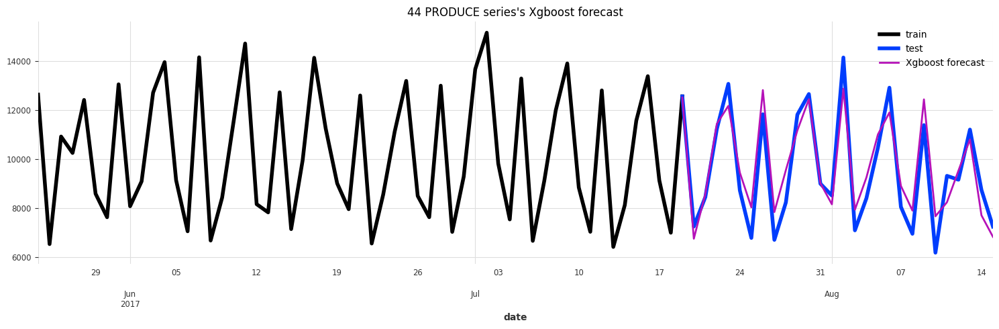

[-2, -3, -4, -5, -6, -7, -13] [-2, -3, -4, -5, -6, -7]
settimane e giorni
model Xgboost obtains MAPE: 28.97


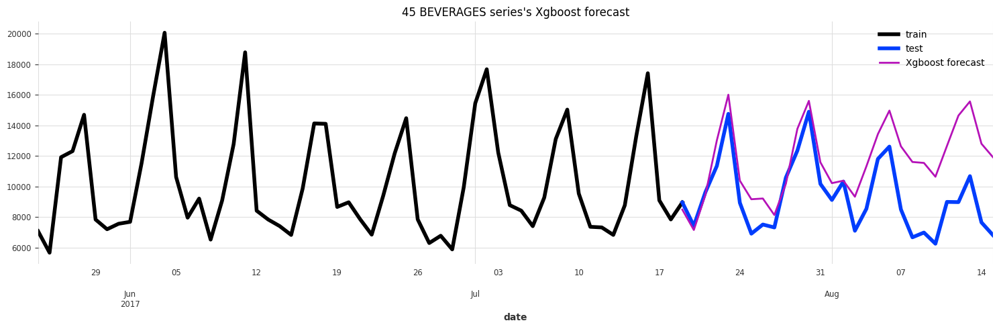

[-1, -2, -4, -5, -6, -12, -13] [-1, -2, -4, -5, -6, -12]
settimane e giorni
model Xgboost obtains MAPE: 13.95


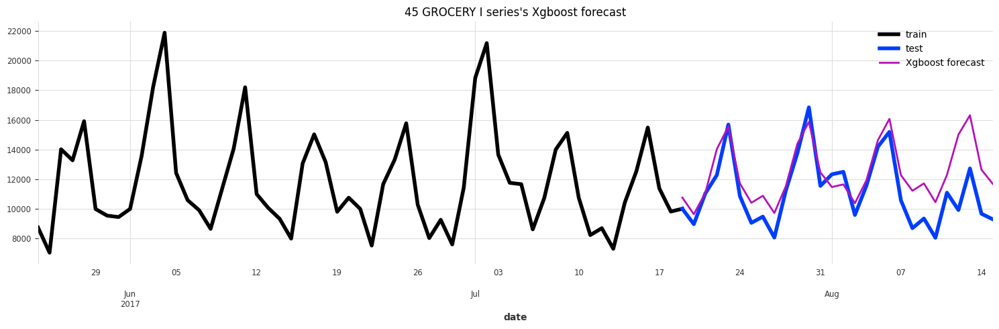

[-1, -2, -3, -5, -6, -7, -13] [-1, -2, -3, -5, -6, -7]
settimane e giorni
model Xgboost obtains MAPE: 24.92


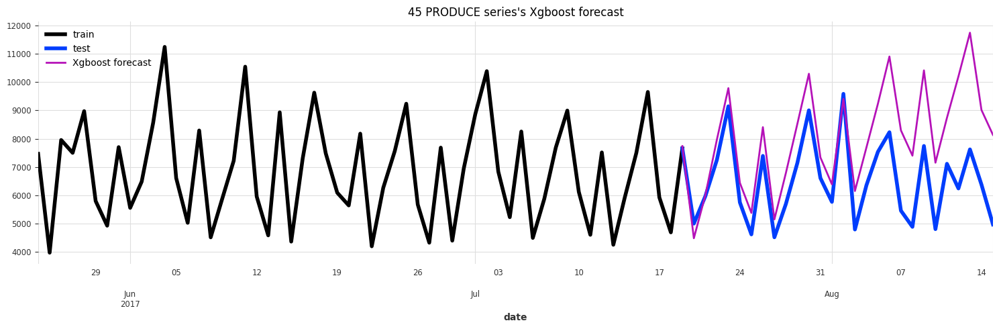

In [98]:
predizioni_light = []
for series in dict_diff_series.keys():
    diff_series = dict_diff_series[series][0]
    if 'PRODUCE'in diff_series:
        diff_series = diff_series['2015-06-02':]
        print(len(diff_series))
    #print(len(diff_series))
    #lags_indexes = dict_diff_series[series][3]
    lags_indexes = lags_diff_series[series]
    #lags_indexes=lags_indexes[:-1]
    
    print(lags_indexes, lags_indexes[:-1])
    mape = functions.get_xgboost_predictions_diff(diff_series=diff_series, lags_indexes=lags_indexes, model_type='lightgboost',
                                   to_scale=False, fut_cov_days_only=False, week_of_year=True, lags_future_covariates=[-2, -1, 0, +1, +2])
    predizioni_light.append(mape)

In [99]:
print(predizioni_light, round(average(predizioni_light), 2))

[18.8, 25.54, 8.42, 28.97, 13.95, 24.92] 20.1


[14.25, 14.95, 7.34, 12.24, 10.56, 14.89] 12.37 Con serie corte

In [100]:
#performance_dict['lightgbm diff mape'] = predizioni_light

Non differenziare le serie e non scalare i dati

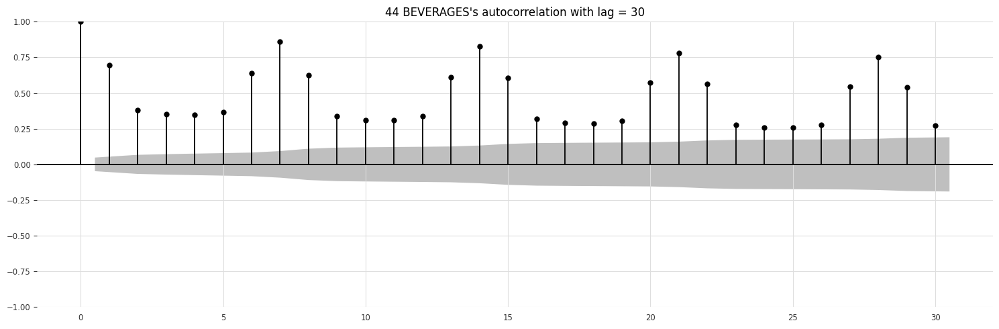

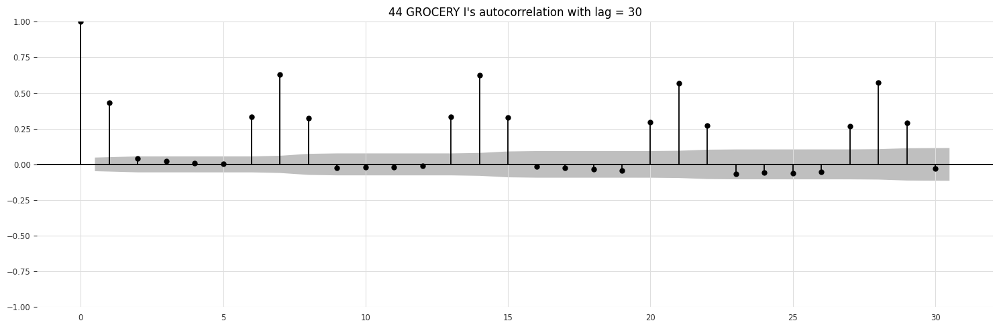

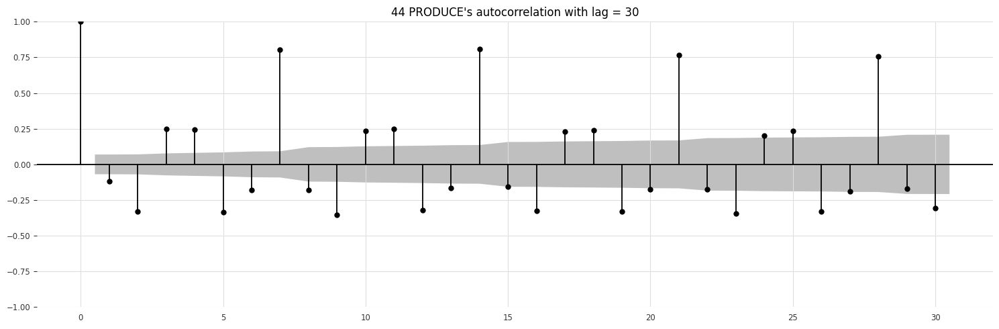

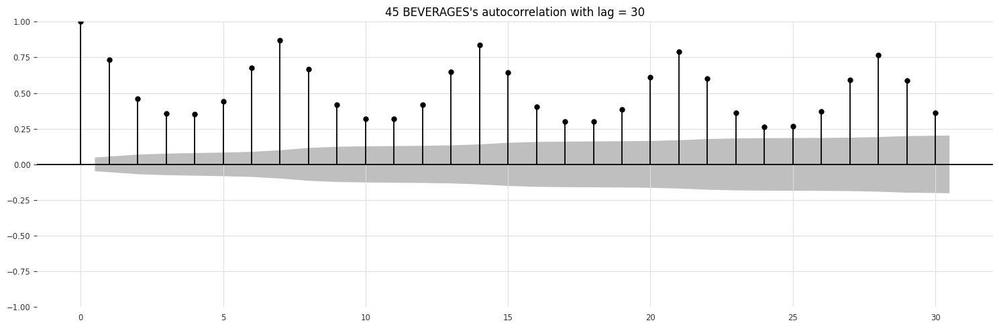

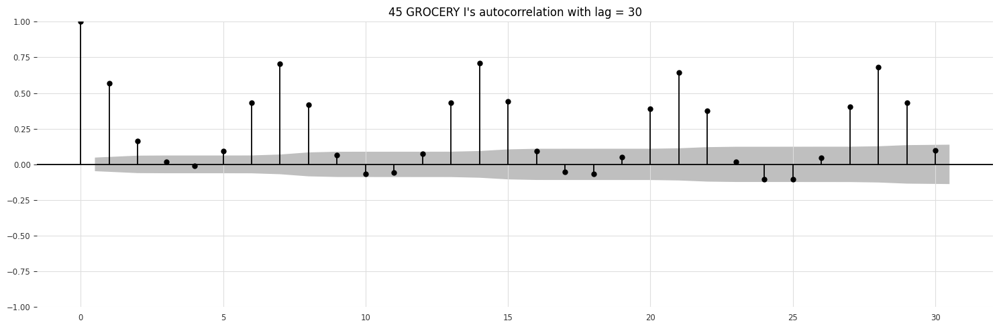

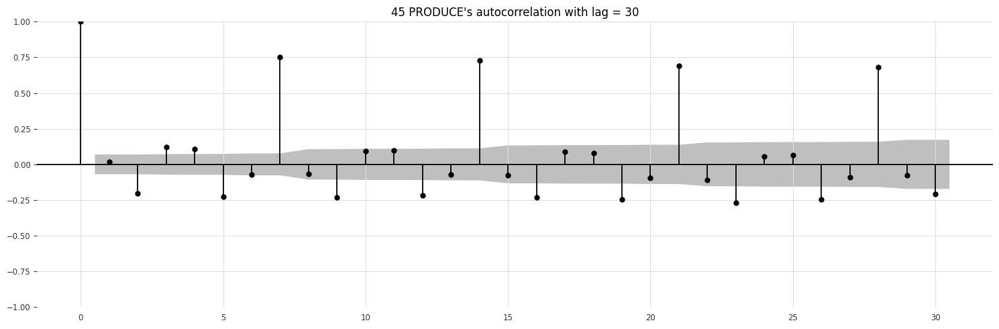

In [101]:
for category in top_series.columns:
    series = top_series[category]
    if 'PRODUCE'in category:
        series = series['2015-06-01':]
    functions.plot_autocorr(series=series, lags=30)

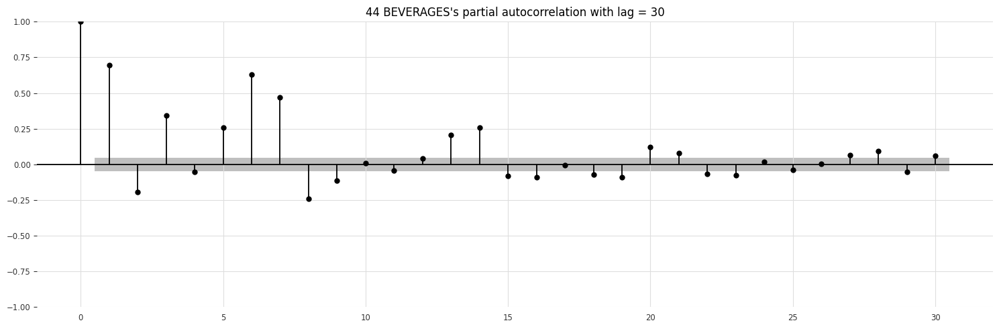

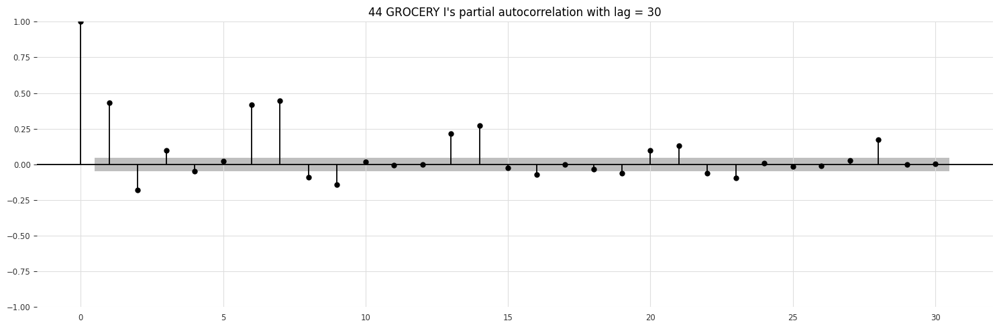

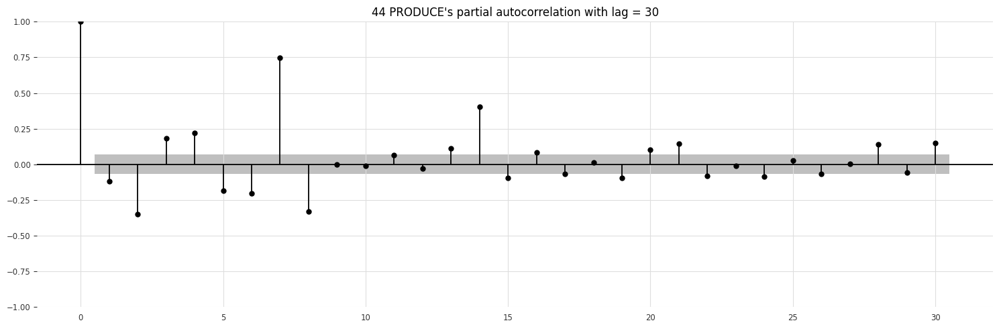

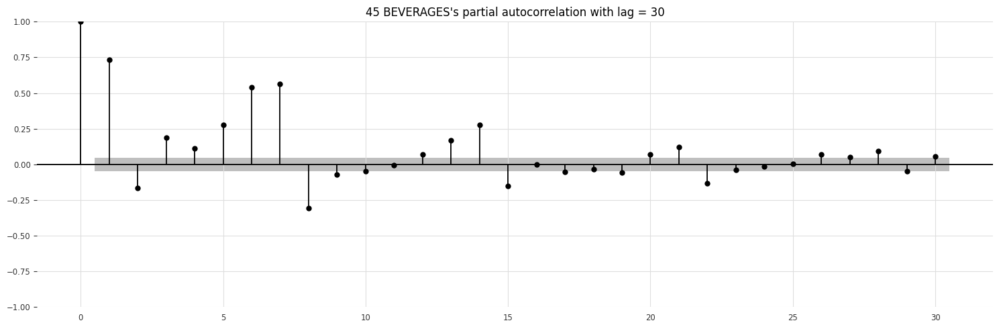

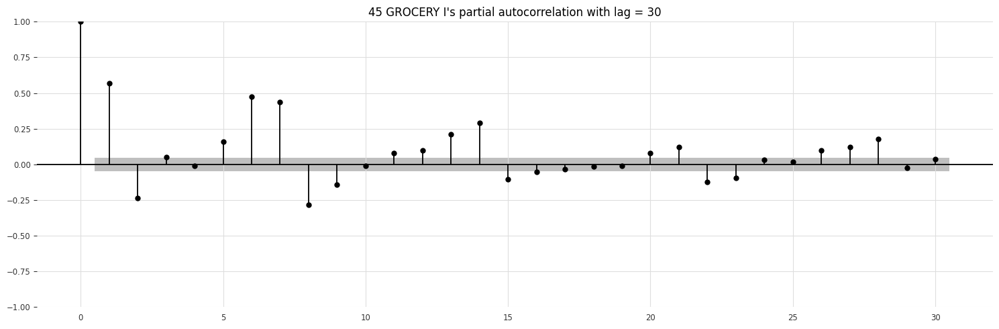

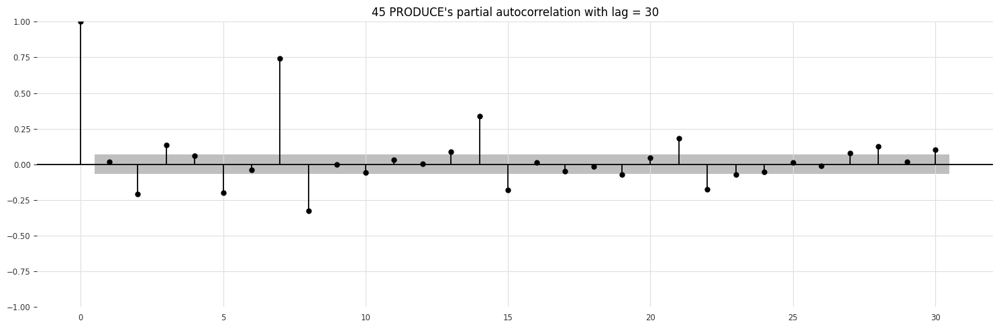

In [102]:
for category in top_series.columns:
    series = top_series[category]
    if 'PRODUCE'in category:
        series = series['2015-06-01':]
    functions.plot_partial_autocorr(series=series, lags=30)

In [103]:
dict_series = {}
for category in top_series.columns:
    series = top_series[category]
    if 'PRODUCE'in category:
        series = series['2015-06-01':]
    part_corr = functions.pacf(x=series, nlags=30)
    lags_pac = [(i+1, round(c, 3)) for i, c in enumerate(part_corr[1:]) if abs(c) > 0.20] # 0.25 o 0.125
    
    lags_indexes_pac = [int(t[0])*(-1) for t in lags_pac]
    dict_series[category] = lags_indexes_pac

In [104]:
dict_series

{'44 BEVERAGES': [-1, -3, -5, -6, -7, -8, -13, -14],
 '44 GROCERY I': [-1, -6, -7, -13, -14],
 '44 PRODUCE': [-2, -4, -6, -7, -8, -14],
 '45 BEVERAGES': [-1, -5, -6, -7, -8, -14],
 '45 GROCERY I': [-1, -2, -6, -7, -8, -13, -14],
 '45 PRODUCE': [-2, -7, -8, -14]}

lags = [-1, -3, -5, -6, -7, -8, -13, -14] 44 PRODUCE backtesting

{'44 BEVERAGES': [-1, -3, -6, -7, -8, -14],
 '44 GROCERY I': [-1, -6, -7],
 '44 PRODUCE': [-1, -2, -3, -4, -7, -8],
 '45 BEVERAGES': [-1, -5, -6, -7, -8, -14],
 '45 GROCERY I': [-1, -6, -7],
 '45 PRODUCE': [-1, -2, -3, -7, -8]}

pac > 0,25 EFFETTIVAMENTE UTILIZZATA

[-1, -3, -5, -6, -7, -8, -13, -14]
settimane e giorni
model Xgboost obtains MAPE: 14.18


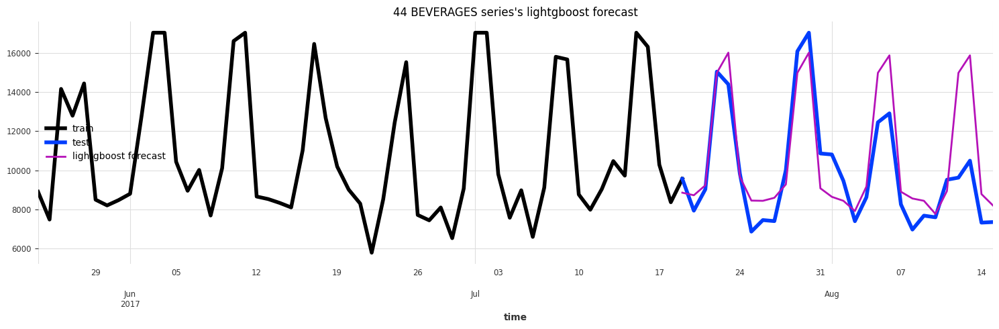

[-1, -6, -7, -13, -14]
settimane e giorni
model Xgboost obtains MAPE: 11.33


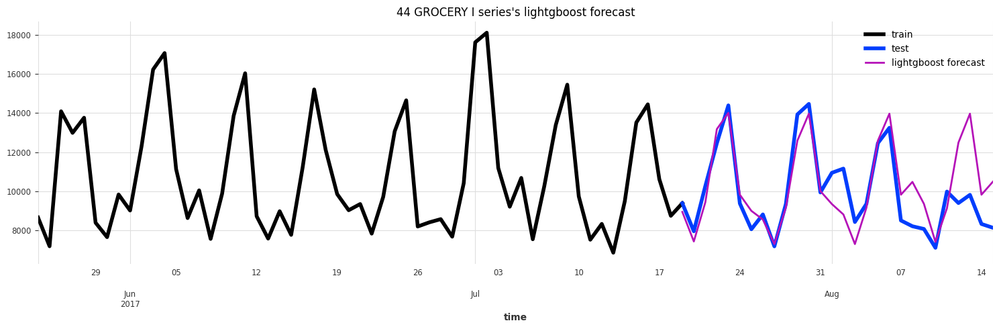

807
[-2, -4, -6, -7, -8, -14]
settimane e giorni
model Xgboost obtains MAPE: 9.30


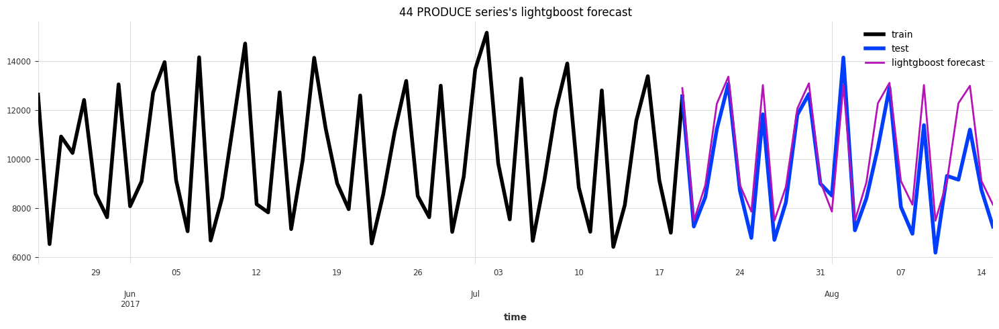

[-1, -5, -6, -7, -8, -14]
settimane e giorni
model Xgboost obtains MAPE: 10.58


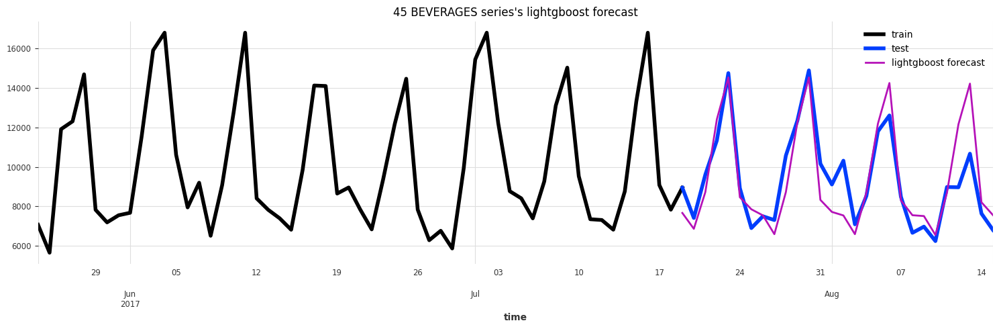

[-1, -2, -6, -7, -8, -13, -14]
settimane e giorni
model Xgboost obtains MAPE: 9.44


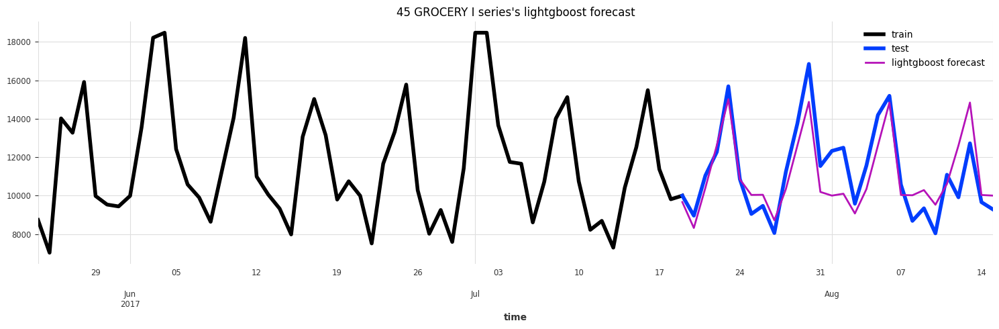

807
[-2, -7, -8, -14]
settimane e giorni
model Xgboost obtains MAPE: 7.65


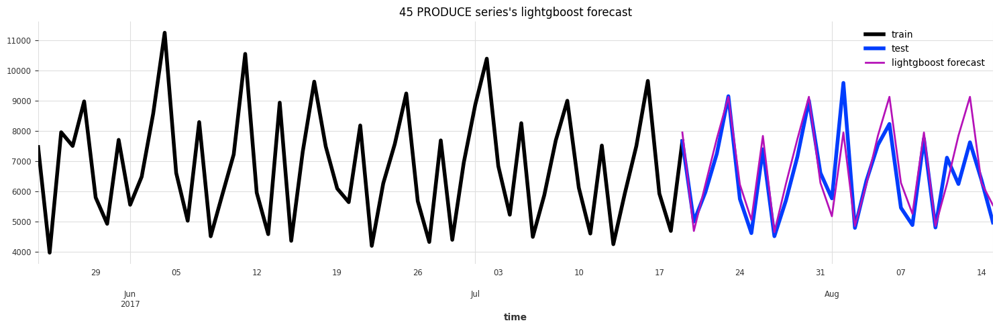

In [105]:
pred_no_diff = []
for category in top_series.columns:
    series = top_series[category]
    if 'PRODUCE'in category:
        series = series['2015-06-01':]
        print(len(series))
    lags_indexes=[i for i in dict_series[category] if abs(i) <= 28]
    #lags_indexes.append(-21)
    print(lags_indexes)
    mape = functions.get_xgboost_predictions(series=series, lags_indexes=lags_indexes, model_type='lightgboost',
                                             to_scale=False, fut_cov_days_only=False, week_of_year=True,
                                             lags_future_covariates=[-2, -1, 0, +1, +2])
    pred_no_diff.append(mape)

In [106]:
# predizioni_no_diff = []
# for series in dict_diff_series.keys():
#     series = top_series[series]
#     #lags_indexes=[-1, -6, -7, -14]
#     mape = functions.get_xgboost_predictions(series=series, lags_indexes=[-1, -2, -6, -7, -13, -14, -21], model_type='lightgboost',
#                                              to_scale=False, fut_cov_days_only=True, week_of_year=False,
#                                              lags_future_covariates=[-7, -6, -1, 0])
#     predizioni_no_diff.append(mape)

In [107]:
#print(predizioni_no_diff, round(average(predizioni_no_diff), 2))
#[13.93, 10.76, 6.64, 11.03, 9.04, 6.73] 9.69 con lags [-1, -6, -7, -14] e fut cov lags [-1, 0, 1]

In [108]:
print(pred_no_diff, round(average(pred_no_diff), 2))

[14.18, 11.33, 9.3, 10.58, 9.44, 7.65] 10.41


[15.58, 8.67, 7.16, 12.48, 9.11, 6.44] 9.91

In [109]:
performance_dict['lightgbm mape'] = pred_no_diff

In [110]:
df_performance = pd.DataFrame(performance_dict)

In [111]:
pd.DataFrame(df_performance.mean().rename('Mean')).rename_axis('Model') \
            .sort_values(by='Mean', ascending=True).reset_index()

,Model,Mean
0,Random Forest mape,7.62
1,Arima mape scaled data and weeks,9.13
2,auto arima mape,9.45
3,lightgbm mape,10.41
4,Bagging mape,10.67
5,LSTM mape,10.72
6,Arima mape cov days,10.82
7,Arima mape scaled data,11.05
8,Random forest diff and weeks mape,12.80
9,Baseline mape,13.03


**ENSEMBLE METHOD**

Si fa una predizione media (ensemble) tra i modelli mediamente più performanti: 'lightgbm', 'lstm' e 'arima'

In [112]:
predictions_dict = {}

**Random Forest**

settimane e giorni
model Random forest obtains MAPE: 9.44


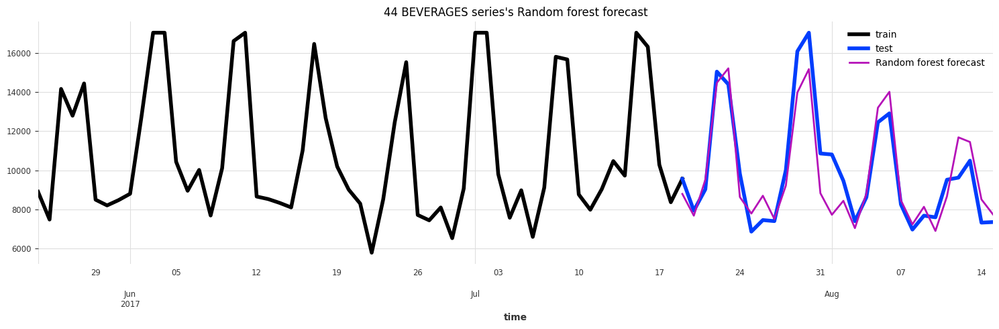

settimane e giorni
model Random forest obtains MAPE: 8.52


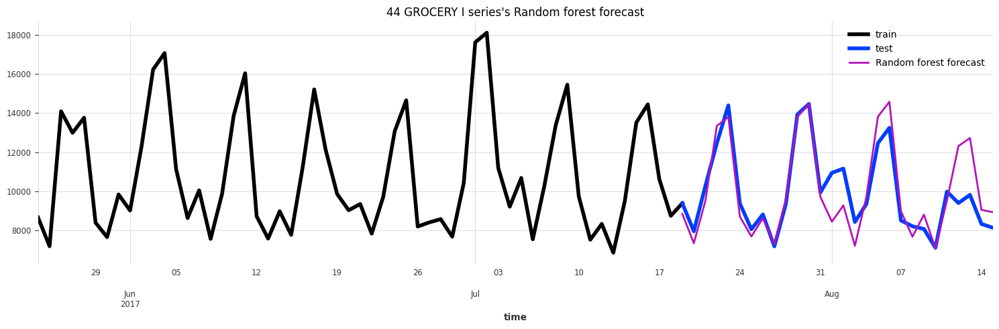

807
settimane e giorni
model Random forest obtains MAPE: 6.23


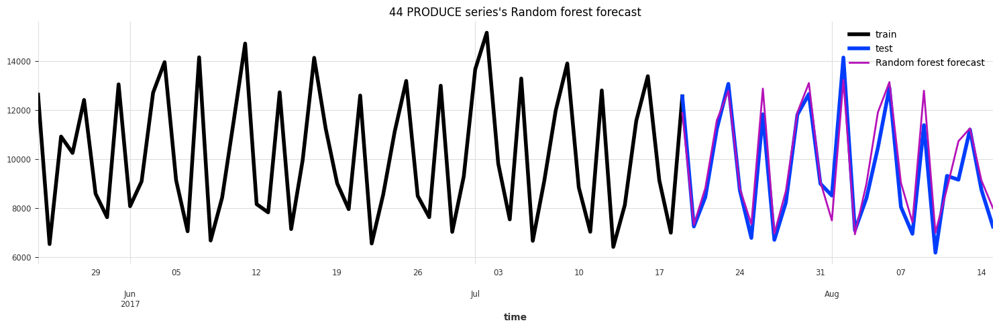

settimane e giorni
model Random forest obtains MAPE: 8.73


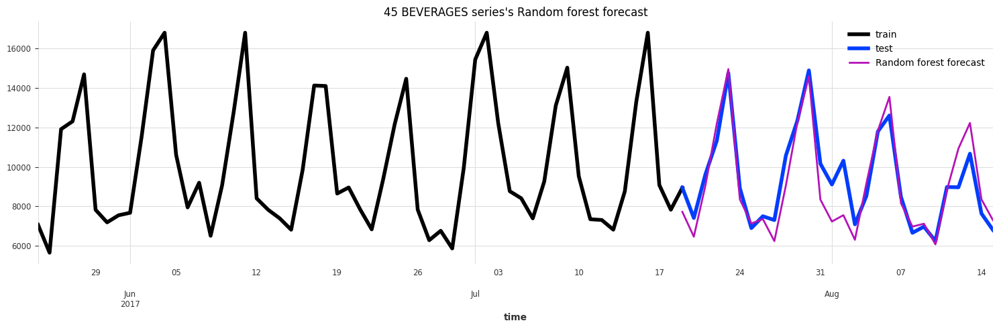

settimane e giorni
model Random forest obtains MAPE: 6.94


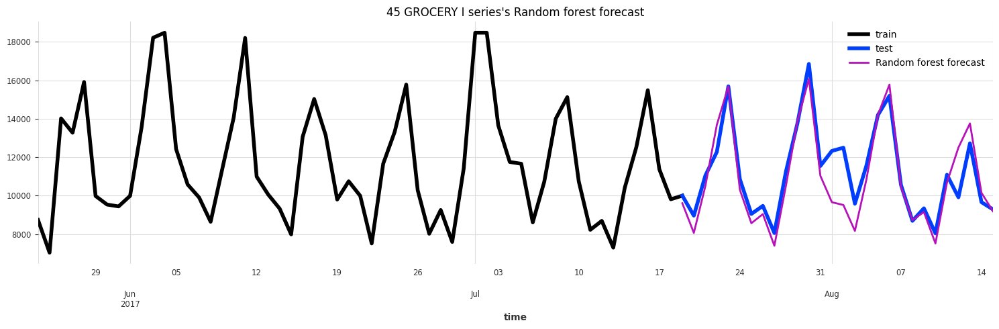

807
settimane e giorni
model Random forest obtains MAPE: 5.89


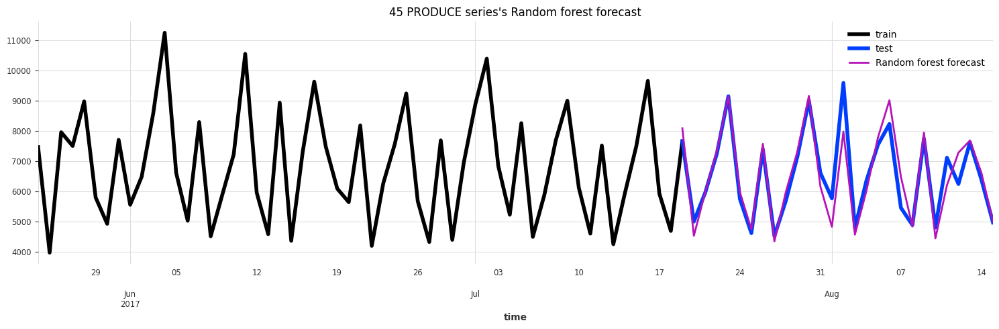

In [113]:
for product in dict_series_rf.keys():
    series = top_series[product]
    if 'PRODUCE'in product:
        series = series['2015-06-01':]
        print(len(series))
    lags_indexes = dict_series_rf[product]
    preds = functions.get_rf_predictions_no_diff(series=series, lags_indexes=lags_indexes,
                                       lags_future_covariates=[-2, -1, 0, +1, +2], fut_cov_days_only=False, week_of_year=True,
                                                return_pred=True)
    predictions_dict['{} rf'.format(product)] = preds

**Arima**

settimane e giorni
model Arima obtains MAPE: 13.24


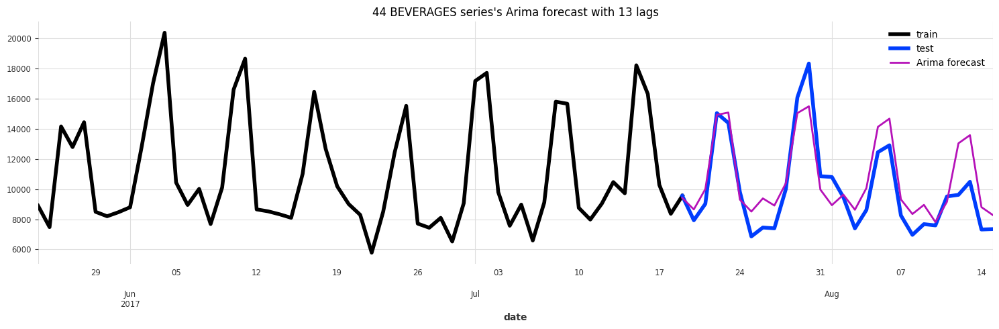

settimane e giorni
model Arima obtains MAPE: 10.35


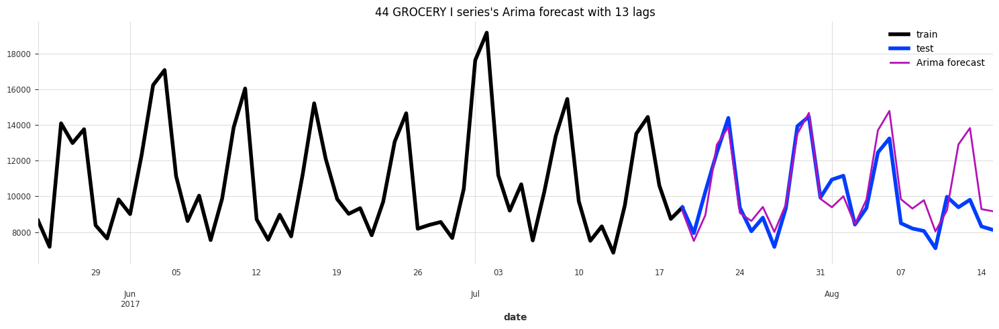

804
settimane e giorni
model Arima obtains MAPE: 6.38


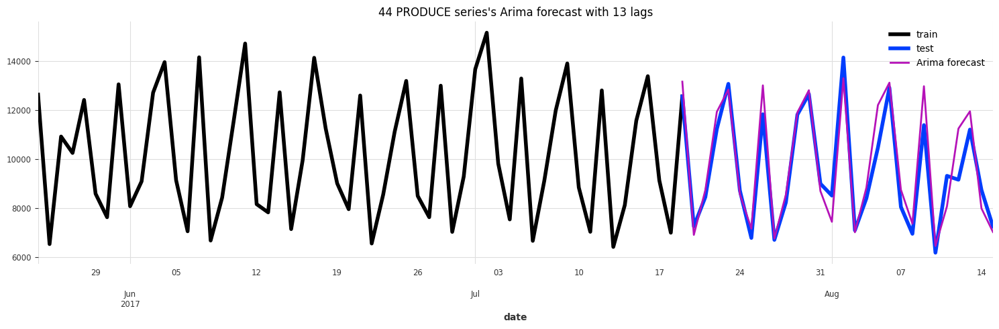

settimane e giorni
model Arima obtains MAPE: 7.86


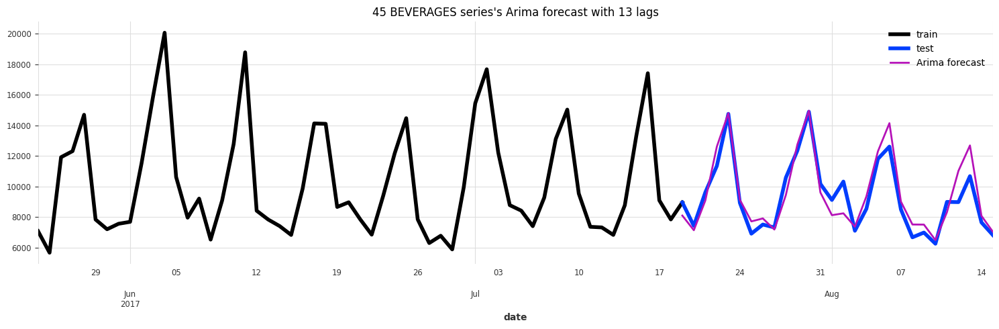

settimane e giorni
model Arima obtains MAPE: 8.95


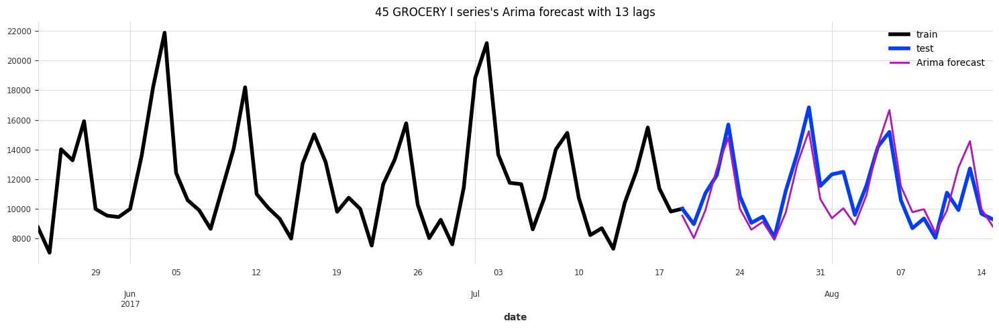

804
settimane e giorni
model Arima obtains MAPE: 7.99


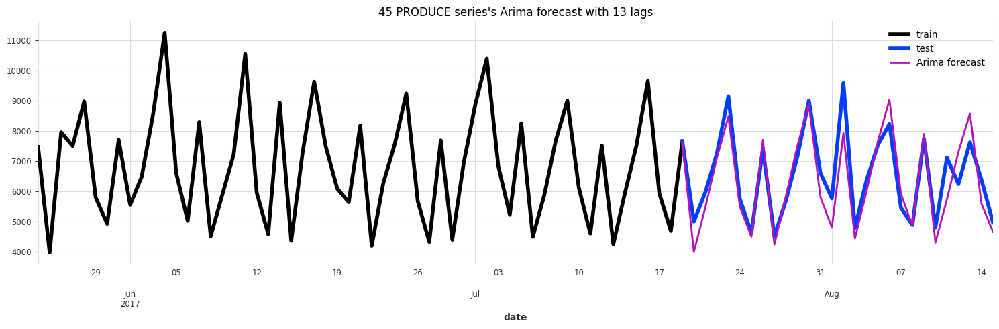

In [114]:
for series in dict_diff_series.keys():
    diff_series = dict_diff_series[series][0]
    #lags_indexes = dict_diff_series[series][3]
    if 'PRODUCE'in series:
        diff_series = diff_series['2015-06-02':]
        print(len(diff_series))
    lags_indexes = lags_diff_series[series]

    preds = functions.get_model_predictions(diff_series=diff_series, model_type='Arima',
                                            lags_indexes=lags_indexes, fut_cov_days_only=False,
                                            week_of_year=True, to_scale=True, return_pred=True)
    predictions_dict['{} arima'.format(series)] = preds

**Auto arima**

In [115]:
# for series in dict_diff_series.keys():
#     diff_series = dict_diff_series[series][0]
#     if 'PRODUCE'in series:
#         diff_series = diff_series['2015-06-02':]
#         print(len(diff_series))
#     best_params = auto_best_params_dict[series]
#     preds = functions.get_arima_predictions(diff_series=diff_series, best_params=best_params,
#                                            fut_cov_days_only=True, to_scale=True, return_pred=True)
#     predictions_dict['{} arima'.format(series)] = preds

**LSTM**

2023-04-03 11:58:36 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:58:36 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:58:36 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:58:36 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:58:36 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


13
88


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

2023-04-03 11:58:58 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.
2023-04-03 11:58:58 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:58:58 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:58:58 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:58:58 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

model LSTM obtains MAPE: 13.71


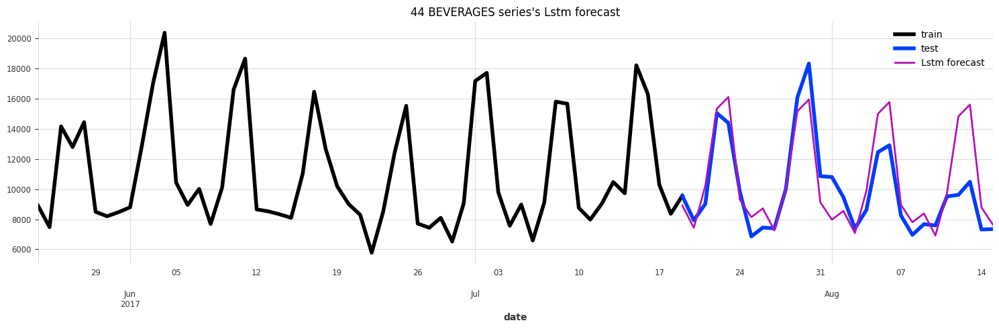

2023-04-03 11:58:59 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:58:59 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:58:59 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:58:59 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:58:59 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


13
88


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

2023-04-03 11:59:21 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.
2023-04-03 11:59:21 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:59:21 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:59:21 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:59:21 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

model LSTM obtains MAPE: 12.83


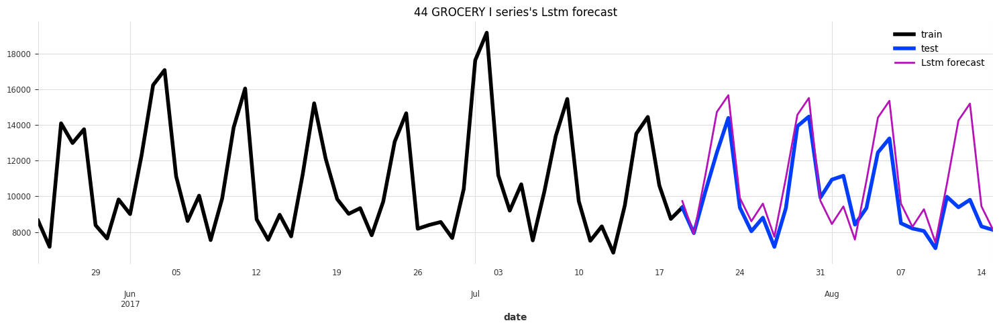

2023-04-03 11:59:22 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:59:22 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:59:22 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:59:22 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:59:22 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


804
13
88


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

2023-04-03 11:59:40 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.
2023-04-03 11:59:40 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:59:40 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:59:40 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:59:40 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

model LSTM obtains MAPE: 6.55


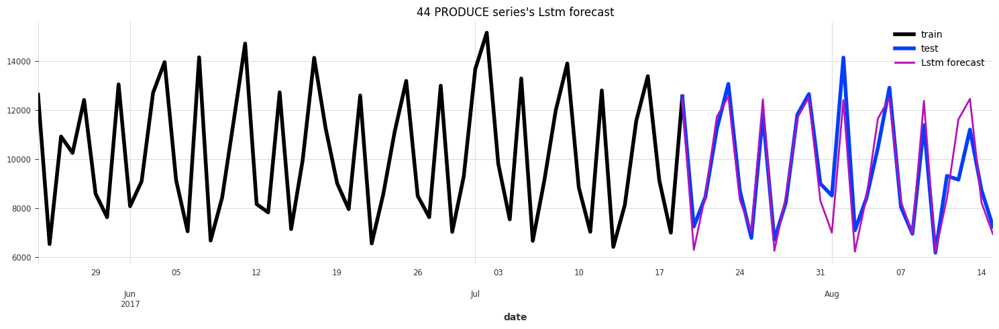

2023-04-03 11:59:41 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:59:41 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:59:41 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:59:41 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 11:59:41 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


13
88


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

2023-04-03 11:59:59 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.
2023-04-03 11:59:59 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 11:59:59 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 11:59:59 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 11:59:59 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

model LSTM obtains MAPE: 12.81


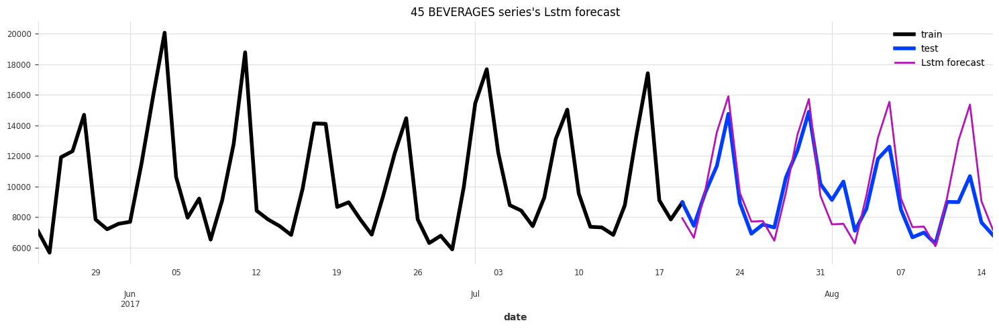

2023-04-03 12:00:00 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:00:00 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:00:00 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:00:00 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:00:00 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


13
88


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

2023-04-03 12:00:18 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.
2023-04-03 12:00:18 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:00:18 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:00:18 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:00:18 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

model LSTM obtains MAPE: 9.14


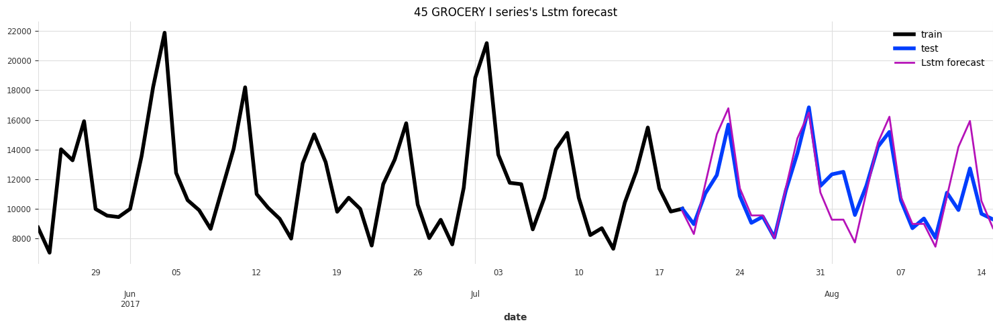

2023-04-03 12:00:18 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:00:18 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:00:18 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:00:18 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:00:18 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


804
13
88


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

2023-04-03 12:00:36 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.
2023-04-03 12:00:36 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:00:36 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:00:36 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:00:36 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs


Predicting: 0it [00:00, ?it/s]

model LSTM obtains MAPE: 9.28


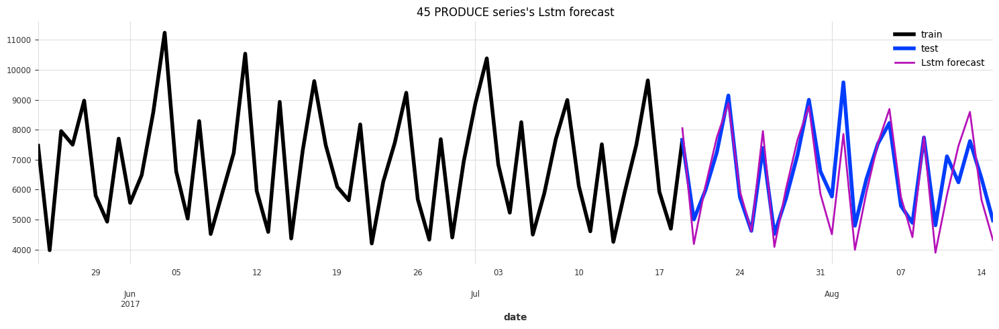

In [116]:
for series in dict_diff_series.keys():
    diff_series = dict_diff_series[series][0]
    if 'PRODUCE'in series:
        diff_series = diff_series['2015-06-02':]
        print(len(diff_series))
    #lags_indexes = dict_diff_series[series][3]
    lags_indexes = lags_diff_series[series]
    preds = functions.get_rnn_predictions_val(diff_series=diff_series, model_type='lstm', lags_indexes=lags_indexes,
                                      fut_cov_days_only=True, to_scale=True, return_pred=True)
    predictions_dict['{} lstm'.format(series)] = preds

**Lightgbm**

settimane e giorni
model Xgboost obtains MAPE: 14.18


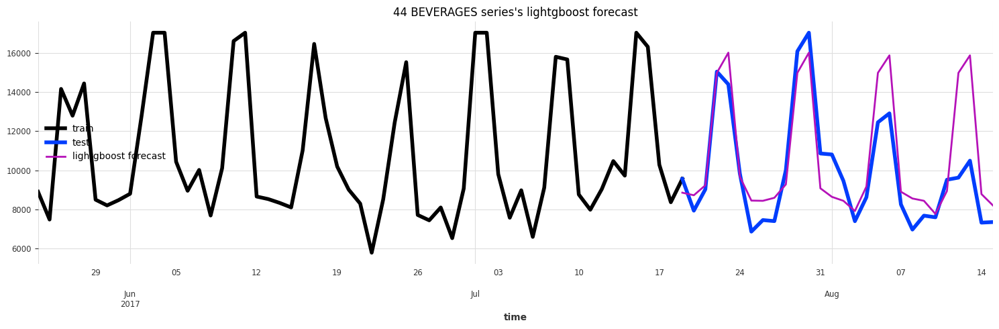

settimane e giorni
model Xgboost obtains MAPE: 11.33


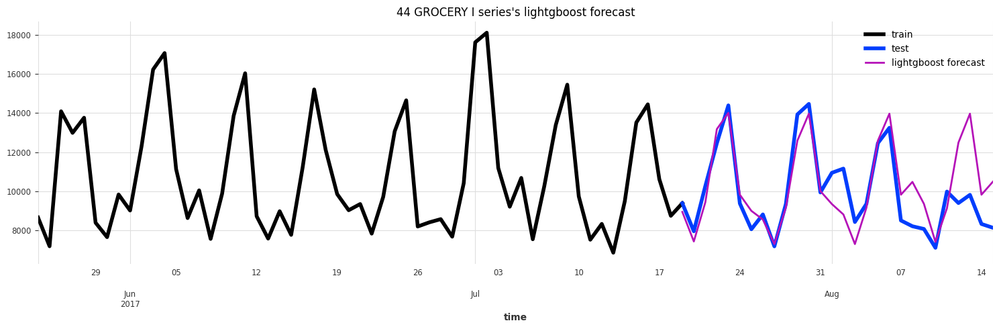

settimane e giorni
model Xgboost obtains MAPE: 9.30


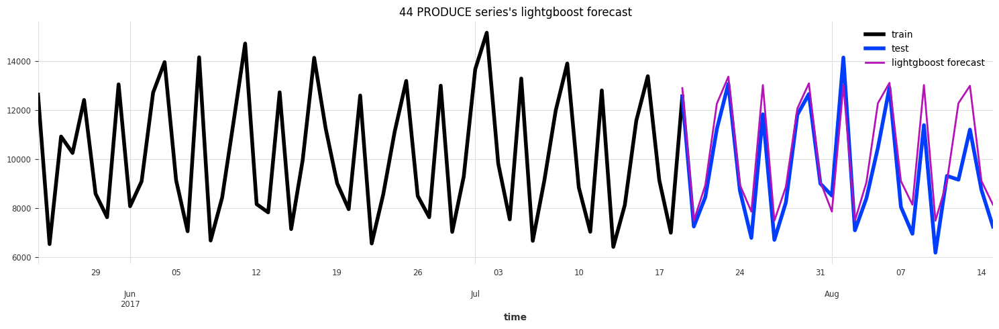

settimane e giorni
model Xgboost obtains MAPE: 10.58


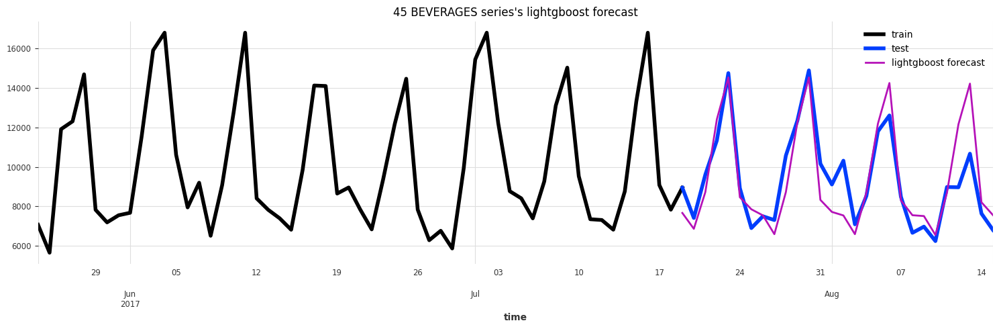

settimane e giorni
model Xgboost obtains MAPE: 9.44


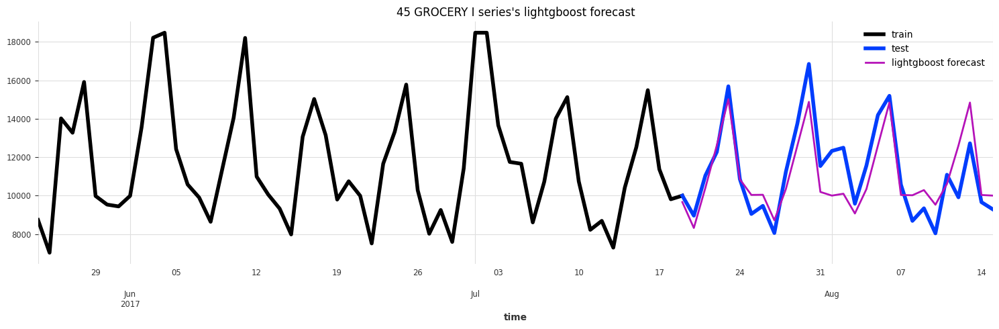

settimane e giorni
model Xgboost obtains MAPE: 7.65


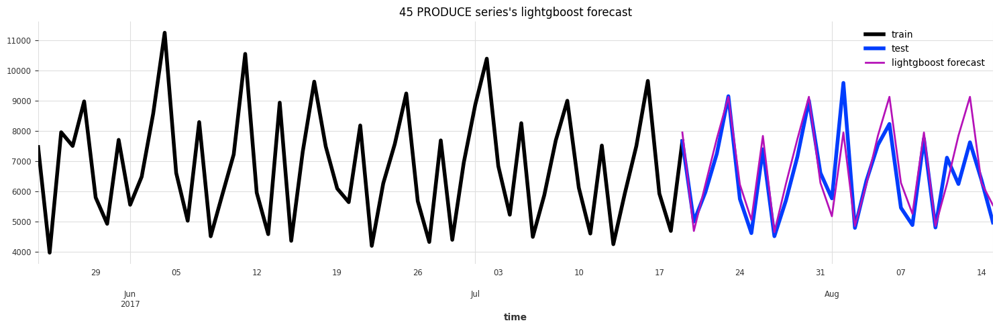

In [117]:
for series in top_series.keys():
    series_no_diff = top_series[series]
    if 'PRODUCE'in series:
        series_no_diff = series_no_diff['2015-06-01':]
    lags_indexes = [i for i in dict_series[series] if abs(i) <= 28]
    preds = functions.get_xgboost_predictions(series=series_no_diff, lags_indexes=lags_indexes, model_type='lightgboost',
                                              to_scale=False, fut_cov_days_only=False, week_of_year=True,
                                              lags_future_covariates=[-2, -1, 0, +1, +2], return_pred=True)
    predictions_dict['{} lightgbm'.format(series)] = preds

In [118]:
predictions_df = pd.DataFrame(predictions_dict)

**Calcoliamo la media ponderata delle predizioni**

In [276]:
#predictions_df = predictions_df.iloc[:, :-6]
#far girere se si vogiono cambiare i pesi della media ensemble

In [277]:
#weights = [0.92, 0.05, 0.013, 0.017]
weights = [0.5, 0.425, 0.075, 0.0]
for series in dict_diff_series.keys():
    cols = ['{} rf'.format(series), '{} arima'.format(series), '{} lstm'.format(series), '{} lightgbm'.format(series)]
    if 'PRODUCE' in series:
        weights = [0.95, 0.0, 0.05, 0.0]
    predictions_df['{} ensemble'.format(series)] = average(predictions_df[cols], weights=weights, axis=1)

In [278]:
predictions_df.head(2)

,44 BEVERAGES rf,44 GROCERY I rf,44 PRODUCE rf,45 BEVERAGES rf,45 GROCERY I rf,45 PRODUCE rf,44 BEVERAGES arima,44 GROCERY I arima,44 PRODUCE arima,45 BEVERAGES arima,45 GROCERY I arima,45 PRODUCE arima,44 BEVERAGES lstm,44 GROCERY I lstm,44 PRODUCE lstm,45 BEVERAGES lstm,45 GROCERY I lstm,45 PRODUCE lstm,44 BEVERAGES lightgbm,44 GROCERY I lightgbm,44 PRODUCE lightgbm,45 BEVERAGES lightgbm,45 GROCERY I lightgbm,45 PRODUCE lightgbm,44 BEVERAGES ensemble,44 GROCERY I ensemble,44 PRODUCE ensemble,45 BEVERAGES ensemble,45 GROCERY I ensemble,45 PRODUCE ensemble
2017-07-19,8790.65,8837.88,11878.99,7725.45,9609.18,8084.59,9416.82,9188.02,13159.30,8087.40,9537.34,7617.68,8916.57,9737.10,12446.61,7912.15,9840.93,8050.24,8853.81,8936.59,12895.29,7669.00,9668.76,7944.84,9066.22,9054.13,11907.38,7734.78,9620.76,8082.88
2017-07-20,7677.33,7328.85,7306.93,6466.17,8068.81,4531.78,8655.72,7504.22,6899.54,7127.23,8029.03,3996.94,7439.28,7890.87,6288.30,6631.08,8297.72,4183.57,8722.70,7422.41,7478.46,6864.85,8324.04,4691.98,8075.29,7445.53,7256.00,6474.41,8080.26,4514.37


In [294]:
def plot_predictions(test: pd.Series, pred: pd.Series):
    name = test.name
    print(name)
    series = top_series[name]
    test = series[-28:]
    fig, ax = plt.subplots(figsize=(15, 5))
    #series[-84:-27].pd_series().plot(lw=4, label="train", ax=ax)
    series[-84:-27].plot(lw=4, label="train", ax=ax)
    test.plot(lw=4, label="test", ax=ax)
    pred.plot(lw=2, label="{} forecast".format('Ensemble'), ax=ax)
    title = r"{} series's {} forecast".format(name, 'Ensemble')
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

44 BEVERAGES


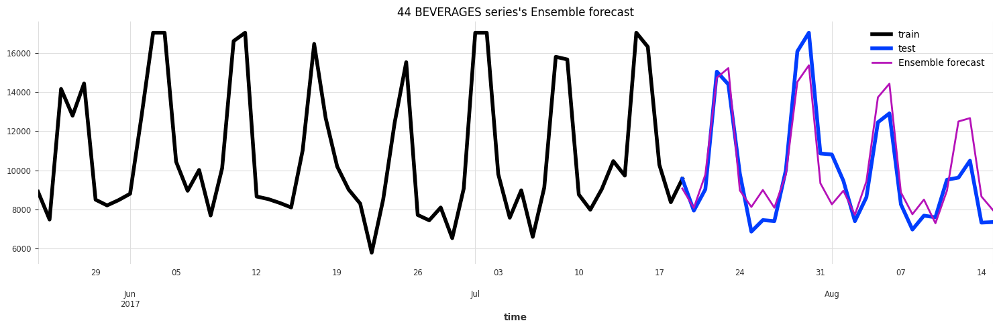

44 GROCERY I


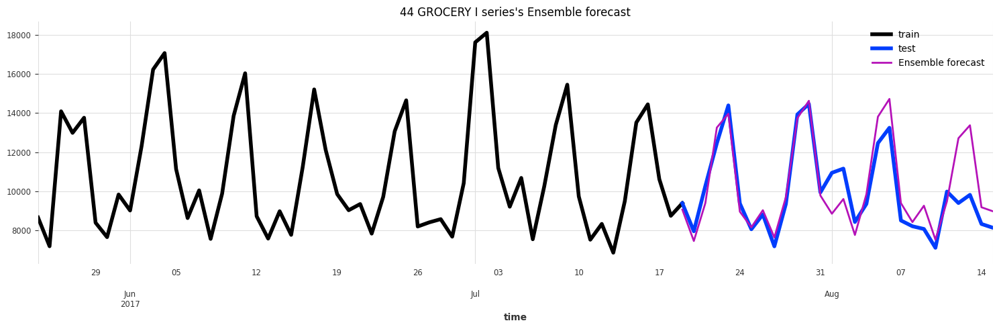

44 PRODUCE


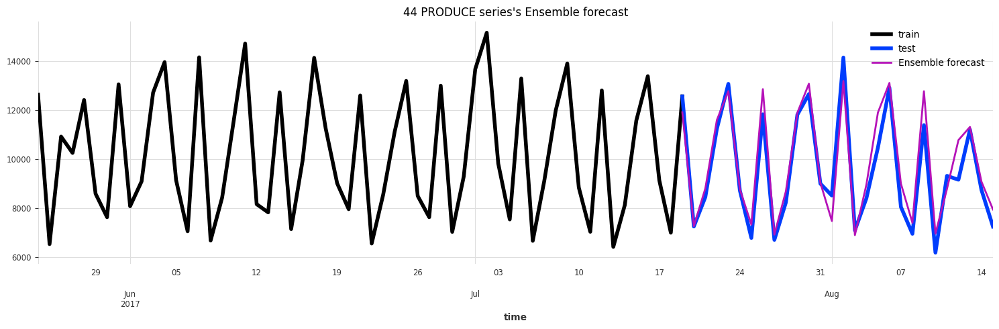

45 BEVERAGES


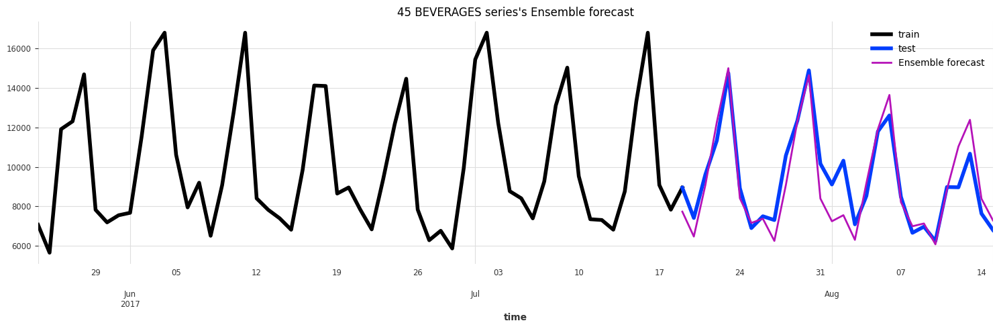

45 GROCERY I


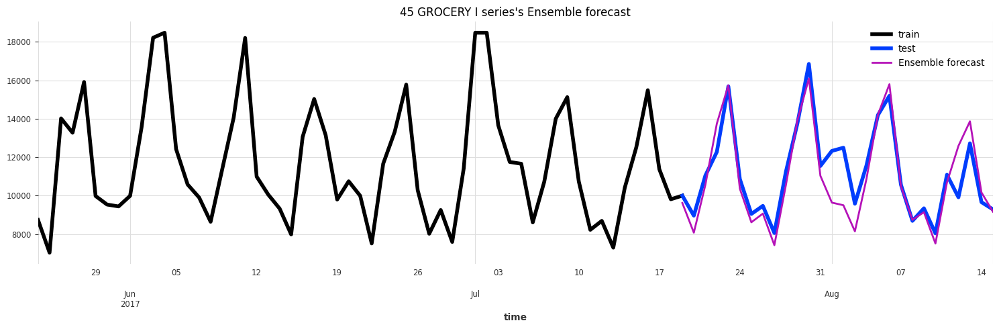

45 PRODUCE


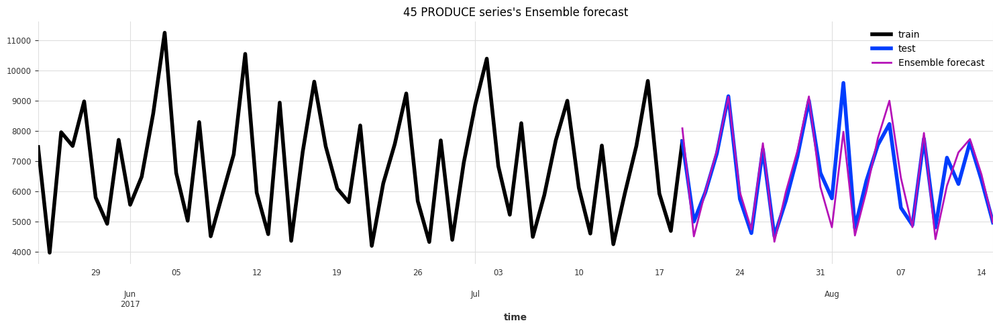

In [295]:
for series in dict_diff_series.keys():
    pred = predictions_df['{} ensemble'.format(series)]
    test = top_series[series][-28:]
    plot_predictions(test=test, pred=pred)

In [279]:
performance_dict['ensemble mape'] = []

In [280]:
for series in dict_diff_series.keys():
    pred = predictions_df['{} ensemble'.format(series)]
    test = top_series[series][-28:]
    mape = mean_absolute_percentage_error(y_true=test, y_pred=pred) * 100
    performance_dict['ensemble mape'].append(round(mape, 2))

In [281]:
print(performance_dict['ensemble mape'], round(average(performance_dict['ensemble mape']), 2))

[10.62, 8.92, 6.08, 8.8, 6.97, 5.96] 7.89


In [282]:
df_performance = pd.DataFrame(performance_dict)

In [283]:
pd.DataFrame(df_performance.mean().rename('Mean')).rename_axis('Model') \
             .sort_values(by='Mean', ascending=True).reset_index()

,Model,Mean
0,Random Forest mape,7.62
1,ensemble mape,7.89
2,Arima mape scaled data and weeks,9.13
3,auto arima mape,9.45
4,lightgbm mape,10.41
5,Bagging mape,10.67
6,LSTM mape,10.72
7,Arima mape cov days,10.82
8,Arima mape scaled data,11.05
9,Random forest diff and weeks mape,12.80


In [284]:
df_performance

,Series,Baseline mape,Arima mape cov days,Arima mape scaled data,Arima mape scaled data and weeks,Random forest diff and weeks mape,Bagging mape,Random Forest mape,LSTM no val mape,LSTM mape,auto arima mape,lightgbm mape,ensemble mape
0,44 BEVERAGES,23.47,19.57,19.77,13.24,11.67,17.13,9.44,14.26,13.71,14.66,14.18,10.62
1,44 GROCERY I,12.06,9.99,11.00,10.35,18.99,11.38,8.52,14.75,12.83,10.36,11.33,8.92
2,44 PRODUCE,7.33,6.62,6.50,6.38,7.45,6.87,6.23,17.32,6.55,6.54,9.30,6.08
3,45 BEVERAGES,15.54,13.83,13.76,7.86,22.61,12.93,8.73,12.73,12.81,9.32,10.58,8.80
4,45 GROCERY I,11.05,7.89,8.17,8.95,10.03,8.48,6.94,24.92,9.14,8.41,9.44,6.97
5,45 PRODUCE,8.72,7.00,7.09,7.99,6.03,7.24,5.89,31.34,9.28,7.43,7.65,5.96


In [285]:
df_performance[['Baseline mape', 'LSTM mape', 'lightgbm mape', 'Arima mape scaled data and weeks', 'Random Forest mape', 'ensemble mape']]

,Baseline mape,LSTM mape,lightgbm mape,Arima mape scaled data and weeks,Random Forest mape,ensemble mape
0,23.47,13.71,14.18,13.24,9.44,10.62
1,12.06,12.83,11.33,10.35,8.52,8.92
2,7.33,6.55,9.30,6.38,6.23,6.08
3,15.54,12.81,10.58,7.86,8.73,8.80
4,11.05,9.14,9.44,8.95,6.94,6.97
5,8.72,9.28,7.65,7.99,5.89,5.96


Per ciascuna delle sei serie storiche il modello ensemble performa decisamente meglio del modello base.

In [286]:
diff = df_performance['Baseline mape'] - df_performance['ensemble mape']
improvement = diff / df_performance['Baseline mape']
avg_improvement = round(average(improvement), 2)
avg_improvement

0.35

**MEDIAMENTE SI HA UN INCREMENTO DEL 35% NELL'ACCURATEZZA DELLE PREDIZIONI DEL MODELLO ENSEMBLE RISPETTO AL BASELINE MODEL**

**CROSS VALIDATION**

Nel caso delle serie storiche la cross validation va fatta tramite training windows crescenti (expanding windows). In generale la capacità predittiva del modello migliora all'aumentare della numerosità del training set, ma non necessariamente.
La cross validation permette di capire quale sarà la performance media del modello su dati nuovi e permette di individuare il punto di minimo della curva della loss function (mape) in modo tale da non overfittare i dati.

I modelli predittivi di Darts hanno il metodo 'backtest' che permette di fare la cross validation.

In [130]:
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import plotly.express as px

from darts.metrics import mape
from darts.utils.statistics import plot_residuals_analysis

from darts.models import NaiveSeasonal
from darts.models.forecasting.gradient_boosted_model import LightGBMModel
from darts.models.forecasting.random_forest import RandomForest

In [131]:
def naive_seasonal_backtest(series: pd.Series, lag_indx: int = 7):
    # nome serie
    name = series.name

    # Creazione serie NON differenziata di darts
    series = TimeSeries.from_series(series, freq='D', fill_missing_dates=True)
    
    #start parameter = where to start predicting
    start = len(series) - 15*(28-14)
    print(start)
    
    naive_model = NaiveSeasonal(K=lag_indx)
    
    backtest_mape = naive_model.backtest(series=series, num_samples=1,
                                   train_length=None, start=start, forecast_horizon=28, stride=14, retrain=True,
                                   overlap_end=True, last_points_only=False, metric=mape,
                                   reduction=None, verbose=False)
    
    if 'PRODUCE' in name:
        series_for_resid = series[582:] #cioè da '2017-01-03:'
    else:
        series_for_resid = series[1463:] #cioè da '2017-01-03:'
    residuals = naive_model.residuals(series=series_for_resid, forecast_horizon=28, retrain=True)
    res = residuals.pd_series()

    print("Residuals' mean:", round(res.mean(), 2))

    return backtest_mape, res, residuals

In [132]:
series_to_backtest = ['44 GROCERY I', '44 PRODUCE']

In [133]:
naive_backtesting = {}
for product in series_to_backtest:
    series = top_series[product]
    if product == '44 PRODUCE':
        series = series['2015-06-01':]
    naive_backtest, naive_pd_res, naive_darts_res = naive_seasonal_backtest(series=series)
    naive_pd_res.name = "{}'s residuals".format(product)
        
    naive_backtest = [round(i, 2) for i in naive_backtest]
    naive_backtesting[product] = [naive_backtest, naive_pd_res, naive_darts_res]

1478
Residuals' mean: -202.68
597
Residuals' mean: -213.01


In [134]:
naive_mape_gro = pd.Series(naive_backtesting['44 GROCERY I'][0])
naive_mape_gro = naive_mape_gro.describe().to_frame().rename(columns={0:'Naive seasonal mape 44 GROCERY I'})
naive_mape_gro

,Naive seasonal mape 44 GROCERY I
count,15.00
mean,14.01
std,4.67
min,9.93
25%,10.91
50%,12.06
75%,15.41
max,27.39


In [135]:
naive_mape_pro = pd.Series(naive_backtesting['44 PRODUCE'][0])
naive_mape_pro = naive_mape_pro.describe().to_frame().rename(columns={0:'Naive seasonal mape 44 PRODUCE'})
naive_mape_pro

,Naive seasonal mape 44 PRODUCE
count,15.00
mean,11.81
std,3.69
min,7.33
25%,9.21
50%,11.40
75%,13.11
max,21.40


In [136]:
fig = px.line(x=naive_backtesting['44 GROCERY I'][2].time_index, y=naive_backtesting['44 GROCERY I'][2].pd_series(),
              title="Naive Seasonal: residuals'time series of 44 GROCERY I", width=700, height=350)
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='44 GROCERY I residuals',
    legend_title='Time series')
fig.show()

In [137]:
fig = px.line(x=naive_backtesting['44 PRODUCE'][2].time_index, y=naive_backtesting['44 PRODUCE'][2].pd_series(),
              title="Naive Seasonal: residuals'time series of 44 PRODUCE", width=700, height=350)
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='44 PRODUCE residuals',
    legend_title='Time series')
fig.show()

In [138]:
naive_backtesting['44 GROCERY I'][1].describe().to_frame()

,44 GROCERY I's residuals
count,191.00
mean,-202.68
std,2109.14
min,-8941.00
25%,-1124.00
50%,-57.00
75%,845.00
max,8919.00


In [139]:
naive_backtesting['44 PRODUCE'][1].describe().to_frame()

,44 PRODUCE's residuals
count,191.00
mean,-213.01
std,1806.16
min,-6360.95
25%,-1019.22
50%,-89.99
75%,657.10
max,7749.08


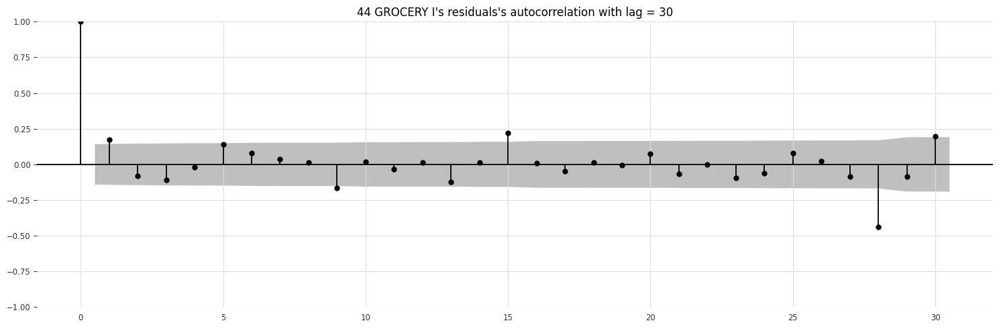

In [140]:
functions.plot_autocorr(series=naive_backtesting['44 GROCERY I'][1], lags=30)

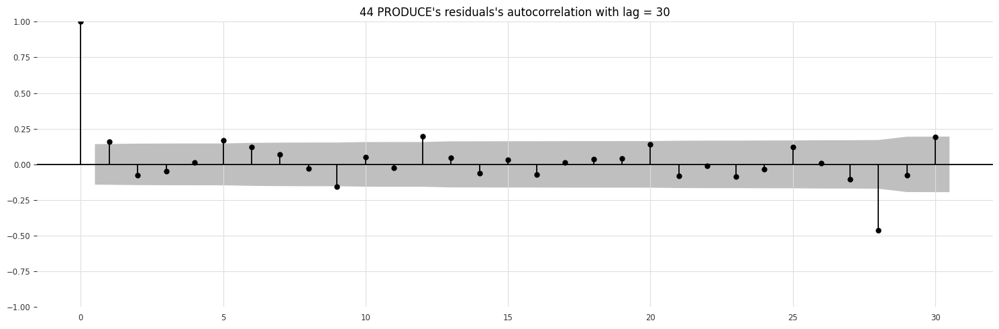

In [141]:
functions.plot_autocorr(series=naive_backtesting['44 PRODUCE'][1], lags=30)

<Figure size 640x480 with 0 Axes>

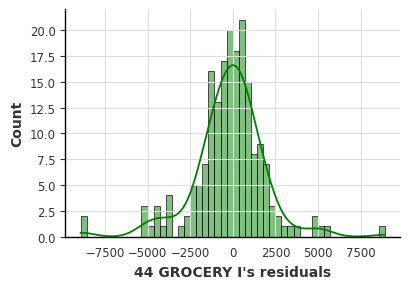

In [142]:
import seaborn as sns
#sns.displot(rf_backtesting['44 PRODUCE'][1], kde=True, bins=30)
color = 'green'
plt.figure()
sns.displot(naive_backtesting['44 GROCERY I'][1], kde=True, bins=50, color=color, height=3, aspect=1.4)
#plt.title("Residuals' distribution of 44 PRODUCE")
plt.xlabel("44 GROCERY I's residuals")
plt.tight_layout()
plt.show()

<Figure size 640x480 with 0 Axes>

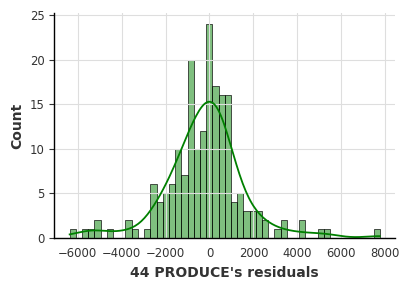

In [143]:
import seaborn as sns
#sns.displot(rf_backtesting['44 PRODUCE'][1], kde=True, bins=30)
color = 'green'
plt.figure()
sns.displot(naive_backtesting['44 PRODUCE'][1], kde=True, bins=50, color=color, height=3, aspect=1.4)
#plt.title("Residuals' distribution of 44 PRODUCE")
plt.xlabel("44 PRODUCE's residuals")
plt.tight_layout()
plt.show()

In [144]:
def rf_backtest(series: pd.Series, lags_indexes: list, model_type: str = 'Random forest',
                               to_scale: bool = False, fut_cov_days_only: bool = False, week_of_year: bool = True,
                               lags_future_covariates: list = [-1, 0], lags_past_covariates: list = None,
                               past_covariates: TimeSeries = None):
    # nome serie
    name = series.name

    # Creazione serie NON differenziata di darts
    series = TimeSeries.from_series(series, freq='D', fill_missing_dates=True)

    # Scalatura dei dati, è meglio fare il fit solo sul train
    if to_scale == True:
        scaler = Scaler()
        series = scaler.fit_transform(series)

    # Aggiunta covariate future
    covariates = functions.get_datetime_series(series=series, days_only=fut_cov_days_only, week_of_year=week_of_year)
    
    #start parameter = where to start predicting
    start = len(series) - 15*(28-14)
    print(start)
    
    if model_type.lower() == 'random forest':
        model = RandomForest(lags=lags_indexes, lags_future_covariates=lags_future_covariates,
                             lags_past_covariates=lags_past_covariates, n_estimators=500, random_state=3,
                             oob_score=True, max_features='sqrt')
    
    backtest_mape = model.backtest(series=series, past_covariates=None, future_covariates=covariates, num_samples=1,
                                   train_length=None, start=start, forecast_horizon=28, stride=14, retrain=True,
                                   overlap_end=True, last_points_only=False, metric=mape,
                                   reduction=None, verbose=False)
    
    if 'PRODUCE' in name:
        #series_for_resid = series[414:] #cioè da '2016-07-19':
        series_for_resid = series[582:] #cioè da '2017-01-03:'
    else:
        #series_for_resid = series[1295:] #cioè da '2016-07-19':
        series_for_resid = series[1463:] #cioè da '2017-01-03:'
    residuals = model.residuals(series=series_for_resid, future_covariates=covariates, forecast_horizon=28, retrain=True)
    res = residuals.pd_series()

    print("Residuals' mean:", round(res.mean(), 2))

    return backtest_mape, res, residuals

In [145]:
colors = {'AR':'blue', 'SARIMA':'green',
          'lightgbm':'purple', 'lstm':'orange', 'rf':'lightblue'}

In [146]:
rf_backtesting = {}
for category in series_to_backtest: #dict_series_rf.keys():
    series = top_series[category]
    if category == '44 PRODUCE':
        series = series['2015-06-01':] #if series == '44 PRODUCE':

    lags = dict_series_rf[category]
    lags_future_covariates=[-2, -1, 0, +1, +2]

    rf_mape, rf_pd_res, rf_darts_res = rf_backtest(series=series, model_type='random forest', lags_indexes=lags,
                                to_scale=False, fut_cov_days_only=False, week_of_year=True, lags_future_covariates=lags_future_covariates)
    rf_pd_res.name = "{}'s residuals".format(category)

    rf_mape = [round(i, 2) for i in rf_mape]
    #rf_backtesting['44 PRODUCE'] = [rf_backtest, rf_pd_res, rf_darts_res]
    rf_backtesting[category] = [rf_mape, rf_pd_res, rf_darts_res]

settimane e giorni
1478
Residuals' mean: -109.33
settimane e giorni
597
Residuals' mean: -179.1


In [147]:
dict_series_rf

{'44 BEVERAGES': [-1, -2, -3, -5, -6, -7, -8, -13, -14],
 '44 GROCERY I': [-1, -2, -6, -7, -9, -13, -14, -21, -28],
 '44 PRODUCE': [-2, -3, -4, -5, -6, -7, -8, -14, -21, -28, -30],
 '45 BEVERAGES': [-1, -2, -3, -5, -6, -7, -8, -13, -14, -15, -22],
 '45 GROCERY I': [-1, -2, -5, -6, -7, -8, -9, -13, -14, -28],
 '45 PRODUCE': [-2, -3, -5, -7, -8, -14, -15, -21, -22]}

In [148]:
print(len(rf_backtesting['44 PRODUCE'][0]), min(rf_backtesting['44 PRODUCE'][0]),
      round(average(rf_backtesting['44 PRODUCE'][0]), 2), max(rf_backtesting['44 PRODUCE'][0]))

15 4.63 8.73 14.26


In [149]:
def calculate_index(start=582, pred=28, stride=14, n_mape=15):
    indexes = []
    start = start
    for i in range(0, 18):
        indexes.append(start+28)
        start = start+14
    return indexes
#indexes = calculate_index()
#indexes
# for i in indexes:
#     print(series[i:i+1])

In [150]:
rf_backtesting['44 PRODUCE'][0]

[9.47,
 14.26,
 12.11,
 7.69,
 13.58,
 13.7,
 8.0,
 9.01,
 7.7,
 6.18,
 5.67,
 4.93,
 4.63,
 6.23,
 7.78]

In [151]:
rf_mape_gro = pd.Series(rf_backtesting['44 GROCERY I'][0])
rf_mape_gro = rf_mape_gro.describe().to_frame().rename(columns={0:'Random forest mape'})
rf_mape_gro

,Random forest mape
count,15.00
mean,10.62
std,2.55
min,6.09
25%,8.67
50%,10.28
75%,12.82
max,15.26


In [152]:
rf_mape_pro = pd.Series(rf_backtesting['44 PRODUCE'][0])
rf_mape_pro = rf_mape_pro.describe().to_frame().rename(columns={0:'Random forest mape'})
rf_mape_pro

,Random forest mape
count,15.00
mean,8.73
std,3.25
min,4.63
25%,6.21
50%,7.78
75%,10.79
max,14.26


2023-04-03 12:07:52 matplotlib.legend WARNING: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


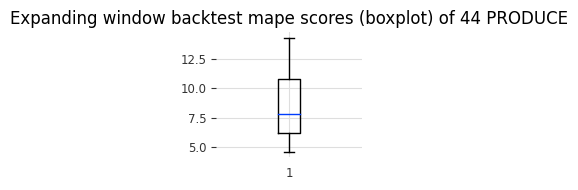

In [153]:
fig, ax = plt.subplots(figsize=(2, 2))
plt.boxplot(x=rf_backtesting['44 PRODUCE'][0])
plt.title("Expanding window backtest mape scores (boxplot) of 44 PRODUCE")
plt.legend()
plt.tight_layout()
plt.show()

In [154]:
#rf_backtesting['44 PRODUCE'][2].plot()
fig = px.line(x=rf_backtesting['44 GROCERY I'][2].time_index, y=rf_backtesting['44 GROCERY I'][2].pd_series(),
              title="Random forest: residuals'time series of 44 GROCERY I", width=700, height=350)
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='44 GROCERY I residuals',
    legend_title='Time series')
fig.show()

In [155]:
rf_backtesting['44 GROCERY I'][1].describe().to_frame()

,44 GROCERY I's residuals
count,167.00
mean,-109.33
std,1763.54
min,-5229.80
25%,-1099.06
50%,-388.74
75%,755.97
max,8220.22


In [156]:
rf_backtesting['44 PRODUCE'][1].describe().to_frame()

,44 PRODUCE's residuals
count,165.00
mean,-179.10
std,1313.94
min,-3946.59
25%,-903.10
50%,-274.68
75%,482.22
max,5750.18


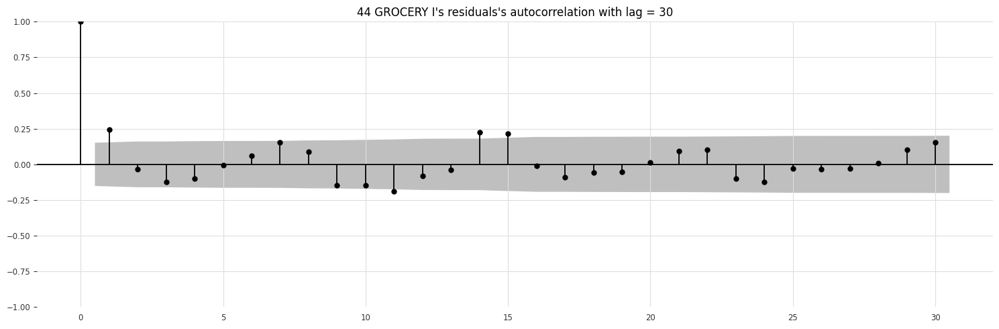

In [157]:
functions.plot_autocorr(series=rf_backtesting['44 GROCERY I'][1], lags=30)

<Figure size 640x480 with 0 Axes>

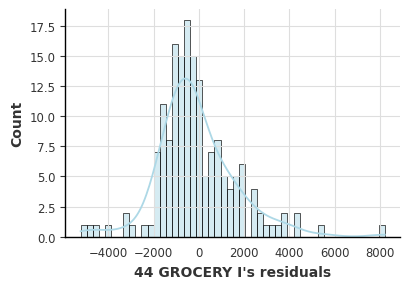

In [158]:
#import seaborn as sns
#sns.displot(rf_backtesting['44 PRODUCE'][1], kde=True, bins=30)
color = colors['rf']
plt.figure()
sns.displot(rf_backtesting['44 GROCERY I'][1], kde=True, bins=50, color=color, height=3, aspect=1.4)
#plt.title("Residuals' distribution of 44 PRODUCE")
plt.xlabel("44 GROCERY I's residuals")
plt.tight_layout()
plt.show()

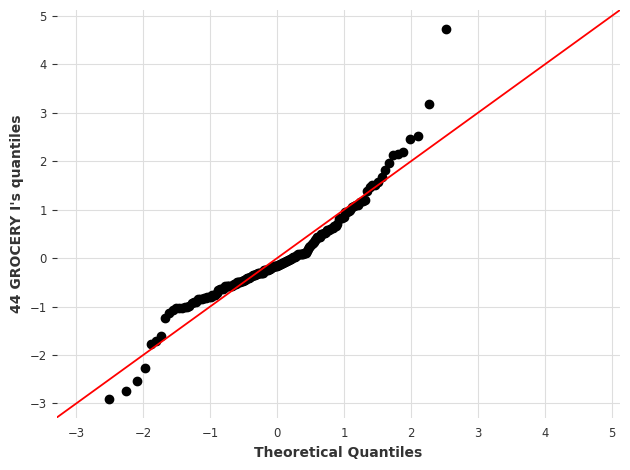

In [159]:
#create Q-Q plot with 45-degree line added to plot
fig = sm.qqplot(data=rf_backtesting['44 GROCERY I'][1], fit=True, line="45")
plt.ylabel("44 GROCERY I's quantiles")
plt.tight_layout()
plt.show()

In [160]:
def xgboost_backtest(series: pd.Series, lags_indexes: list,
                            model_type: str, to_scale: bool = False,
                            fut_cov_days_only: bool = True, week_of_year: bool = False,
                            lags_future_covariates: list = [-1, 0], lags_past_covariates: list = None,
                            past_covariates: TimeSeries = None):
    # nome serie
    name = series.name

    # Creazione serie NON differenziata di darts
    series = TimeSeries.from_series(series, freq='D', fill_missing_dates=True)

    # Scalatura dei dati
    if to_scale == True:
        scaler = Scaler()
        series = scaler.fit_transform(series)

    # Aggiunta covariate future
    covariates = functions.get_datetime_series(series=series, days_only=fut_cov_days_only, week_of_year=week_of_year)
    
    #minimum train_lenght
    lenght = abs(lags_indexes[-1])
    
    #start parameter = where to start predicting
    start = len(series) - 15*(28-14)
    print(start)

    if model_type.lower() == 'lightgboost':
        model = LightGBMModel(lags=lags_indexes, lags_past_covariates=lags_past_covariates,
                              lags_future_covariates=lags_future_covariates,
                              output_chunk_length=1, random_state=42,
                              num_leaves=5, learning_rate=0.005, n_estimators=850)
        
    backtest_mape = model.backtest(series=series, past_covariates=None, future_covariates=covariates, num_samples=1,
                                   train_length=None, start=start, forecast_horizon=28, stride=14, retrain=True,
                                   overlap_end=True, last_points_only=False, metric=mape,
                                   reduction=None, verbose=False)
    
    #residuals analysis
    #series_for_resid = series[1293:] #cioè da '2016-01-01':
    #series_for_resid = series[214:] #cioè da '2016-01-01': #per PRODUCE
    if 'PRODUCE' in name:
        #series_for_resid = series[414:] #cioè da '2016-07-19':
        series_for_resid = series[582:] #cioè da '2017-01-03:'
    else:
        #series_for_resid = series[1295:] #cioè da '2016-07-19':
        series_for_resid = series[1463:] #cioè da '2017-01-03:'
    residuals = model.residuals(series=series_for_resid, future_covariates=covariates, forecast_horizon=28)
    res = residuals.pd_series()

    print("Residuals' mean:", round(res.mean(), 2))

    #return
    return backtest_mape, res, residuals

In [161]:
lightgbm_backtest = {}
for category in series_to_backtest: #dict_series_rf.keys():
    series = top_series[category]
    if category == '44 PRODUCE':
        series = series['2015-06-01':] 

    lags = dict_series[category]
    print(lags)
    lags_future_covariates=[-2, -1, 0, +1, +2]

    lgb_backtest, lgb_pd_res, lgb_darts_res = xgboost_backtest(series=series, model_type='lightgboost', lags_indexes=lags,
                                to_scale=False, fut_cov_days_only=False, week_of_year=True, lags_future_covariates=lags_future_covariates)
    lgb_pd_res.name = "{}'s residuals".format(category)

    lgb_backtest = [round(i, 2) for i in lgb_backtest]
    lightgbm_backtest[category] = [lgb_backtest, lgb_pd_res, lgb_darts_res]

[-1, -6, -7, -13, -14]
settimane e giorni
1478
Residuals' mean: -217.74
[-2, -4, -6, -7, -8, -14]
settimane e giorni
597
Residuals' mean: -347.96


In [162]:
print(len(lightgbm_backtest['44 PRODUCE'][0]), min(lightgbm_backtest['44 PRODUCE'][0]),
      round(average(lightgbm_backtest['44 PRODUCE'][0]), 2), max(lightgbm_backtest['44 PRODUCE'][0]))

15 6.21 10.44 16.29


15 5.92 14.32 48.84

In [163]:
lightgbm_backtest['44 PRODUCE'][0]

[7.37,
 13.22,
 13.03,
 16.29,
 13.33,
 14.14,
 9.33,
 9.76,
 12.43,
 7.74,
 7.18,
 6.21,
 6.46,
 8.73,
 11.42]

In [164]:
boosting_mape_gro = pd.Series(lightgbm_backtest['44 GROCERY I'][0])
boosting_mape_gro = boosting_mape_gro.describe().to_frame().rename(columns={0:'Lightgbm mape'})
boosting_mape_gro

,Lightgbm mape
count,15.00
mean,12.89
std,3.22
min,9.32
25%,10.10
50%,11.42
75%,15.58
max,18.94


In [165]:
boosting_mape_pro = pd.Series(lightgbm_backtest['44 PRODUCE'][0])
boosting_mape_pro = boosting_mape_pro.describe().to_frame().rename(columns={0:'Lightgbm mape'})
boosting_mape_pro

,Lightgbm mape
count,15.00
mean,10.44
std,3.18
min,6.21
25%,7.55
50%,9.76
75%,13.12
max,16.29


2023-04-03 12:08:41 matplotlib.legend WARNING: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


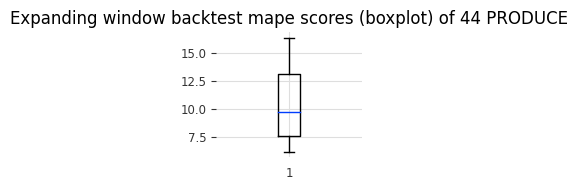

In [166]:
fig = plt.figure(figsize=(2, 2))
fig = plt.boxplot(x=lightgbm_backtest['44 PRODUCE'][0])
plt.title(label="Expanding window backtest mape scores (boxplot) of 44 PRODUCE")    
plt.legend()
plt.tight_layout()
plt.show()

In [167]:
lightgbm_backtest['44 GROCERY I'][1].describe().to_frame()

,44 GROCERY I's residuals
count,180.00
mean,-217.74
std,2334.07
min,-7264.20
25%,-1665.71
50%,-378.93
75%,614.76
max,6906.35


In [168]:
lightgbm_backtest['44 PRODUCE'][1].describe().to_frame()

,44 PRODUCE's residuals
count,180.00
mean,-347.96
std,1924.83
min,-6930.44
25%,-1423.87
50%,-432.91
75%,650.59
max,6605.35


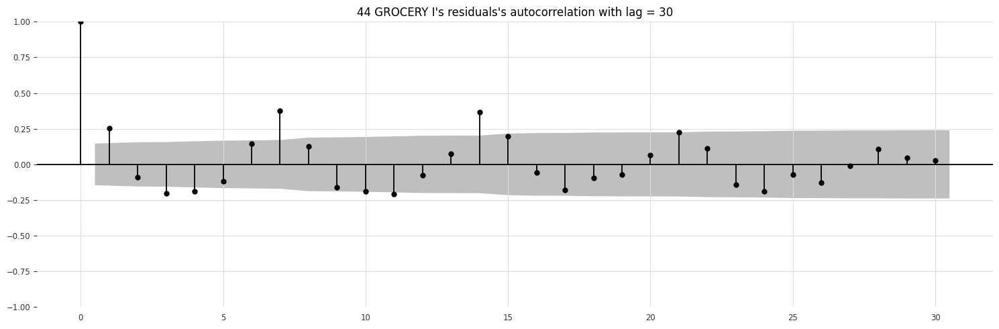

In [169]:
functions.plot_autocorr(series=lightgbm_backtest['44 GROCERY I'][1], lags=30)

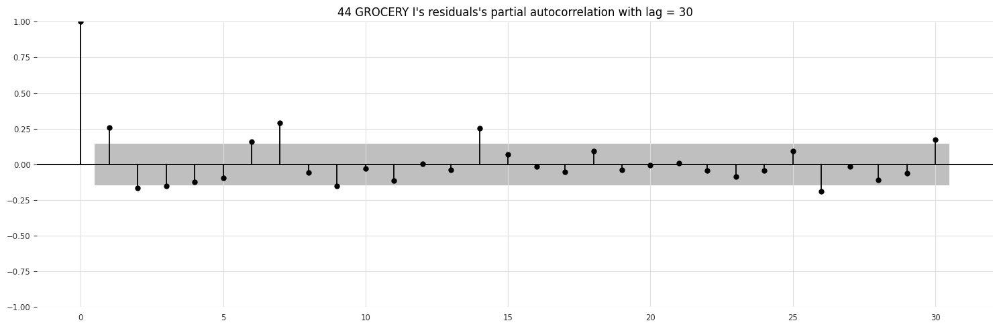

In [170]:
functions.plot_partial_autocorr(series=lightgbm_backtest['44 GROCERY I'][1], lags=30)

In [171]:
#lightgbm_backtest['44 PRODUCE'][2].plot()
fig = px.line(x=lightgbm_backtest['44 GROCERY I'][2].time_index, y=lightgbm_backtest['44 GROCERY I'][2].pd_series(),
              title="Gradient boosting: residuals'time series of 44 GROCERY I", width=700, height=350)
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='44 GROCERY I residuals',
    legend_title='Time series')
fig.show()

<Figure size 640x480 with 0 Axes>

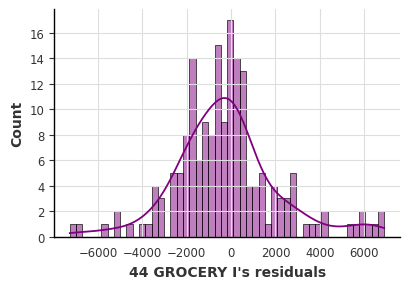

In [172]:
#sns.displot(lightgbm_backtest['44 PRODUCE'][1], kde=True, bins=30)
color = colors['lightgbm']
plt.figure()
sns.displot(lightgbm_backtest['44 GROCERY I'][1], kde=True, bins=50, color=color, height=3, aspect=1.4)
#plt.title("Residuals' distribution of 44 PRODUCE")
plt.xlabel("44 GROCERY I's residuals")
plt.tight_layout()
plt.show()

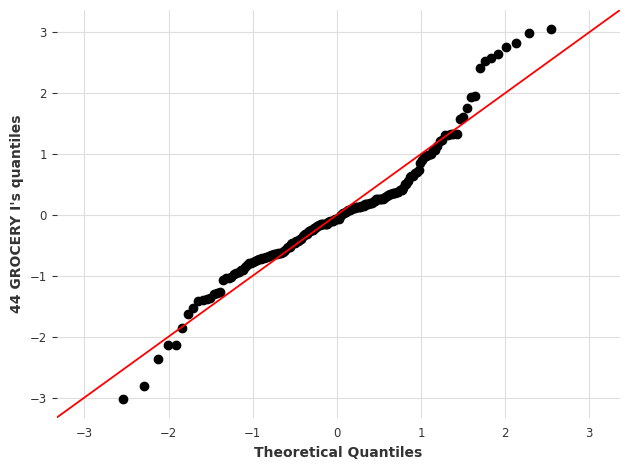

In [173]:
fig = sm.qqplot(data=lightgbm_backtest['44 GROCERY I'][1], fit=True, line="45")
plt.ylabel("44 GROCERY I's quantiles")
plt.tight_layout()
plt.show()

**Backtesting Lstm**

In [174]:
from darts.dataprocessing.transformers import Scaler
from darts.models import RNNModel
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.tensorboard import SummaryWriter

In [175]:
def backtest_rnn(diff_series: pd.Series, model_type: str, lags_indexes: list,
                 to_scale: bool = True, fut_cov_days_only: bool = True,
                 week_of_year: bool = False, return_pred: bool = False,
                 past_covariates: TimeSeries = None):

    #nome serie
    name = diff_series.name
    
    #Creazione ts darts
    series = TimeSeries.from_series(diff_series, freq='D', fill_missing_dates=True)
    
    #Scalatura dei dati
    if to_scale == True:
        scaler = Scaler()
        series = scaler.fit_transform(series)
    
    #Aggiunta covariate future
    fut_cov = functions.get_datetime_series(series=series, days_only=fut_cov_days_only, week_of_year=week_of_year)
    
    #Modello RNN
    chunk_lenght = abs(lags_indexes[-1])
    
    model_type = model_type.upper()
    rnn = RNNModel(model=model_type,
                   hidden_dim=20,
                   n_rnn_layers=1,
                   dropout=0.025,
                   batch_size=8,
                   n_epochs=60,
                   loss_fn=nn.MSELoss(),
                   optimizer_kwargs={"lr": 1e-3},
                   random_state=42,
                   input_chunk_length=chunk_lenght,
                   output_chunk_length=1
                  )

    #slicing: len(series) -48 (=hidden_dim+forecast_horizon) -182 (=13*14): così da avere 13 fold, tot:-230, 20=hidden_dim
    indx = len(series)-230
    print(indx)
    backtest_series = series[indx:]
    #backtest_series = series[1458:] #len(series)-230
    
    
    #start parameter for backtest
    #start = hidden_dim è il valore minimo di osservazioni per il modello, start = 48 = (hidden_dim)+(28)
    
    #backtest
    backtest_mape = rnn.backtest(series=backtest_series, past_covariates=None, future_covariates=fut_cov, num_samples=1,
                                   train_length=None, start=48, forecast_horizon=28, stride=14, retrain=True,
                                   overlap_end=True, last_points_only=False, metric=mape, reduction=None, verbose=False)
    
    #residual analysis
    #slicing: len(series) -132 = (hidden_dim+28 = base di training)+(28*3 = 84 test) : per avere 12 settimane di predizioni
    
    #if 'PRODUCE' in name:
        #series_for_resid = series[677:] #cioè da '2017-04-06:'
    #else:
    indx = len(series)-132
    print(indx)
    series_for_resid = series[indx:]
    #series_for_resid = series[1556:] #cioè da '2017-04-06:'
    
    print('computing residuals')
    residuals = rnn.residuals(series_for_resid, future_covariates=fut_cov, forecast_horizon=28, retrain=True)
    
    #residuals = scaler.inverse_transform(residuals)
    res = residuals.pd_series()
    print("Residuals' mean:", round(res.mean(), 5))
    
    #return
    return backtest_mape, res, residuals

In [176]:
# mass = dict_diff_series['45 PRODUCE'][0]['2017-04-03']
# short_series_45_product = dict_diff_series['45 PRODUCE'][0]
# short_series_45_product = short_series_45_product.replace(mass, -5000)
# short_series_45_product['2015-06-01':].plot()

In [177]:
lags_diff_series

{'44 BEVERAGES': [-2, -4, -5, -6, -7, -12, -13],
 '44 GROCERY I': [-1, -2, -3, -4, -5, -6, -12, -13],
 '44 PRODUCE': [-1, -2, -3, -6, -7, -13],
 '45 BEVERAGES': [-2, -3, -4, -5, -6, -7, -13],
 '45 GROCERY I': [-1, -2, -4, -5, -6, -12, -13],
 '45 PRODUCE': [-1, -2, -3, -5, -6, -7, -13]}

In [178]:
dict_diff_series['44 PRODUCE'][3]

[-1, -2, -3, -6, -7, -14]

In [179]:
backtest_lstm = {}
for category in series_to_backtest: #dict_series_rf.keys():
        diff_series = dict_diff_series[category][0]
        print(len(diff_series))
        #lags_indexes = lags_diff_series[category]
        lags_indexes = dict_diff_series[category][3]
        print(lags_indexes)
        bktest_lstm, pd_res_lstm, darts_res_lstm = backtest_rnn(diff_series=diff_series, model_type='lstm',
                                                                lags_indexes=lags_indexes, to_scale=True, fut_cov_days_only=True)
        bktest_lstm = [round(i, 2) for i in bktest_lstm]
        pd_res_lstm.name = category
        backtest_lstm[category] = [bktest_lstm, pd_res_lstm, darts_res_lstm]

2023-04-03 12:08:45 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:08:45 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:08:45 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:08:45 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:08:45 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


1683
[-1, -2, -3, -4, -5, -6, -12, -13]
1457


Training: 0it [00:00, ?it/s]

2023-04-03 12:08:48 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:08:48 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:08:48 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:08:48 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:08:48 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:08:48 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:08:48 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:08:52 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:08:52 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:08:52 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:08:52 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:08:52 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:08:52 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:08:52 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:08:58 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:08:58 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:08:58 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:08:58 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:08:58 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:08:58 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:08:58 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:09:06 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:09:06 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:09:06 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:09:06 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:09:06 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:09:06 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:09:06 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:09:15 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:09:15 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:09:15 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:09:15 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:09:15 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:09:15 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:09:15 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:09:25 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 12it [00:00, ?it/s]

2023-04-03 12:09:25 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:09:25 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:09:25 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:09:25 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:09:25 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:09:25 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:09:38 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 14it [00:00, ?it/s]

2023-04-03 12:09:38 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:09:38 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:09:38 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:09:38 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:09:38 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:09:38 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:09:51 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 16it [00:00, ?it/s]

2023-04-03 12:09:51 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:09:51 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:09:51 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:09:51 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:09:51 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:09:51 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:10:05 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 17it [00:00, ?it/s]

2023-04-03 12:10:05 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:10:05 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:10:05 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:10:05 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:10:05 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:10:05 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:10:20 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 19it [00:00, ?it/s]

2023-04-03 12:10:21 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:10:21 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:10:21 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:10:21 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:10:21 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:10:21 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:10:38 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 21it [00:00, ?it/s]

2023-04-03 12:10:38 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:10:38 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:10:38 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:10:38 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:10:38 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:10:38 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:10:56 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 23it [00:00, ?it/s]

2023-04-03 12:10:56 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:10:56 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:10:56 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:10:56 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:10:56 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:10:56 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:16 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 24it [00:00, ?it/s]

2023-04-03 12:11:16 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:16 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:16 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:16 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:16 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:16 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

1555
computing residuals


Training: 0it [00:00, ?it/s]

2023-04-03 12:11:17 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:11:17 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:17 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:17 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:17 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:17 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:17 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:18 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:11:18 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:18 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:18 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:18 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:18 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:18 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:19 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:11:19 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:19 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:19 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:19 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:19 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:19 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:20 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:11:20 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:20 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:20 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:20 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:20 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:20 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:21 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:11:21 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:21 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:21 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:21 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:21 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:21 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:22 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:11:22 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:22 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:22 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:22 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:22 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:22 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:23 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:11:23 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:23 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:23 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:23 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:23 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:23 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:24 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:11:24 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:24 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:24 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:24 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:24 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:24 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:26 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:11:26 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:26 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:26 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:26 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:26 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:26 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:28 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:11:28 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:28 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:28 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:28 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:28 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:28 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:30 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:11:30 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:30 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:30 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:30 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:30 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:30 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:32 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:11:32 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:32 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:32 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:32 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:32 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:32 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:33 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:11:34 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:34 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:34 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:34 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:34 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:34 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:35 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:11:35 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:35 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:35 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:35 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:35 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:35 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:37 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:11:37 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:37 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:37 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:37 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:37 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:37 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:39 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:11:39 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:39 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:39 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:39 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:39 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:39 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:42 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:11:42 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:42 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:42 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:42 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:42 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:42 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:45 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:11:45 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:45 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:45 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:45 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:45 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:45 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:48 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:11:48 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:48 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:48 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:48 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:48 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:48 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:51 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:11:51 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:51 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:51 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:51 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:51 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:51 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:53 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:11:54 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:54 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:54 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:54 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:54 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:54 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:56 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:11:56 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:56 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:56 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:56 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:56 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:56 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:11:59 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:11:59 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:11:59 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:11:59 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:11:59 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:11:59 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:11:59 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:02 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:12:02 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:02 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:02 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:02 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:02 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:02 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:05 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:12:05 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:05 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:05 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:06 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:06 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:06 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:09 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:12:09 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:09 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:09 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:09 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:09 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:09 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:13 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:12:13 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:13 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:13 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:13 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:13 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:13 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:16 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:12:17 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:17 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:17 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:17 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:17 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:17 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:20 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:12:20 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:20 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:20 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:20 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:20 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:20 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:24 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:12:24 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:24 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:24 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:24 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:24 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:24 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:28 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:12:28 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:28 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:28 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:28 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:28 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:28 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:32 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:12:32 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:32 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:32 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:32 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:32 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:32 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:36 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:12:36 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:36 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:36 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:36 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:36 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:36 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:41 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:12:41 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:41 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:41 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:41 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:41 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:41 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:45 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:12:45 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:45 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:45 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:45 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:45 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:45 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:50 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:12:50 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:50 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:50 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:50 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:50 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:50 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:54 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:12:54 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:54 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:54 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:54 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:54 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:54 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:12:58 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:12:58 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:12:58 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:12:58 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:12:58 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:12:58 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:12:58 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:13:03 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:13:03 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:13:03 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:13:03 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:13:03 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:13:03 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:13:03 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:13:07 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:13:07 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:13:07 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:13:07 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:13:07 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:13:07 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:13:07 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:13:12 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:13:12 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:13:12 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:13:12 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:13:12 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:13:12 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:13:12 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:13:17 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:13:18 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:13:18 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:13:18 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:13:18 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:13:18 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:13:18 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:13:23 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:13:23 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:13:23 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:13:23 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:13:23 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:13:23 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:13:23 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:13:29 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:13:29 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:13:29 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:13:29 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:13:29 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:13:29 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:13:29 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:13:34 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:13:34 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:13:34 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:13:34 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:13:34 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:13:34 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:13:34 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:13:39 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:13:39 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:13:39 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:13:39 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:13:39 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:13:39 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:13:39 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:13:45 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:13:45 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:13:45 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:13:45 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:13:45 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:13:45 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:13:45 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:13:54 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:13:54 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:13:54 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:13:54 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:13:54 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:13:54 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:13:54 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:14:04 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:14:04 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:14:04 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:14:04 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:14:04 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:14:04 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:14:04 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:14:11 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:14:11 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:14:11 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:14:11 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:14:11 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:14:11 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:14:11 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:14:17 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:14:17 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:14:17 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:14:17 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:14:17 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:14:17 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:14:17 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:14:23 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:14:23 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:14:23 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:14:23 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:14:23 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:14:23 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:14:23 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:14:30 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:14:30 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:14:30 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:14:30 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:14:30 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:14:30 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:14:30 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:14:36 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:14:36 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:14:36 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:14:36 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:14:36 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:14:36 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:14:36 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:14:43 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:14:43 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:14:43 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:14:43 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:14:43 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:14:43 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:14:43 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:14:49 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:14:49 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:14:49 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:14:49 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:14:49 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:14:49 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:14:49 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:14:55 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:14:56 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:14:56 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:14:56 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:14:56 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:14:56 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:14:56 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:15:02 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:15:02 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:15:02 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:15:02 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:15:02 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:15:02 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:15:02 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:15:09 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:15:09 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:15:09 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:15:09 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:15:09 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:15:09 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:15:09 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:15:16 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:15:16 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:15:16 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:15:16 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:15:16 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:15:16 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:15:16 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:15:22 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:15:22 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:15:22 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:15:22 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:15:22 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:15:22 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:15:22 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:15:29 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:15:29 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:15:29 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:15:29 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:15:29 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:15:29 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:15:29 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:15:36 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:15:36 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:15:36 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:15:36 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:15:36 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:15:36 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:15:36 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:15:43 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:15:43 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:15:43 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:15:43 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:15:43 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:15:43 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:15:43 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:15:52 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:15:52 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:15:52 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:15:52 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:15:52 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:15:52 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:15:52 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:16:01 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:16:01 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:16:01 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:16:01 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:16:01 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:16:01 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:16:01 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:16:08 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:16:08 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:16:08 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:16:08 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:16:08 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:16:08 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:16:08 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:16:16 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:16:16 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:16:16 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:16:16 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:16:16 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:16:16 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:16:16 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:16:23 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:16:23 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:16:23 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:16:23 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:16:23 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:16:23 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:16:23 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:16:31 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:16:31 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:16:31 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:16:31 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:16:31 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:16:31 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:16:31 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:16:39 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:16:39 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:16:39 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:16:39 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:16:39 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:16:39 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:16:39 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:16:47 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:16:47 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:16:47 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:16:47 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:16:47 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:16:47 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:16:47 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:16:56 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:16:56 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:16:56 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:16:56 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:16:56 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:16:56 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:16:56 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:17:04 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:17:04 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:17:04 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:17:04 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:17:04 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:17:04 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:17:04 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:17:12 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:17:12 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:17:12 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:17:12 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:17:12 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:17:12 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:17:13 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:17:21 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:17:21 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:17:21 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:17:21 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:17:21 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:17:21 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:17:21 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:17:29 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:17:29 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:17:29 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:17:29 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:17:29 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:17:29 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:17:29 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:17:38 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:17:38 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:17:38 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:17:38 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:17:38 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:17:38 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:17:38 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:17:46 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:17:46 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:17:46 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:17:46 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:17:46 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:17:46 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:17:46 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:17:55 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:17:55 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:17:55 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:17:55 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:17:55 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:17:55 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | MSELoss          | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | rnn           | LSTM             | 2.4 K 
4 | V             | Linear           | 21    
---------------------------------------------------
2.4 K     Trainable params
0         Non-trainable params
2.4 K     Total params
0.019     Total estimated model params size (MB)


Residuals' mean: -0.00047
1683
[-1, -2, -3, -6, -7, -14]
1457


Training: 0it [00:00, ?it/s]

2023-04-03 12:17:58 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:17:58 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:17:58 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:17:58 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:17:58 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:17:58 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:17:58 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:18:03 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:18:03 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:18:03 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:18:03 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:18:03 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:18:03 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:18:03 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:18:09 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:18:09 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:18:09 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:18:09 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:18:09 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:18:09 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:18:09 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:18:16 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:18:16 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:18:16 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:18:16 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:18:16 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:18:16 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:18:16 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:18:25 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:18:25 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:18:25 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:18:25 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:18:25 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:18:25 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:18:25 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:18:35 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 12it [00:00, ?it/s]

2023-04-03 12:18:35 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:18:35 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:18:35 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:18:35 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:18:35 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:18:35 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:18:47 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 14it [00:00, ?it/s]

2023-04-03 12:18:47 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:18:47 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:18:47 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:18:47 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:18:47 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:18:47 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:19:00 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 16it [00:00, ?it/s]

2023-04-03 12:19:00 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:19:00 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:19:00 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:19:00 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:19:00 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:19:00 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:19:15 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 17it [00:00, ?it/s]

2023-04-03 12:19:15 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:19:15 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:19:15 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:19:15 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:19:15 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:19:15 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:19:31 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 19it [00:00, ?it/s]

2023-04-03 12:19:31 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:19:31 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:19:31 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:19:31 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:19:31 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:19:31 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:19:48 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 21it [00:00, ?it/s]

2023-04-03 12:19:49 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:19:49 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:19:49 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:19:49 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:19:49 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:19:49 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:08 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 23it [00:00, ?it/s]

2023-04-03 12:20:08 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:08 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:08 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:08 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:08 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:08 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:28 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 24it [00:00, ?it/s]

2023-04-03 12:20:28 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:28 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:28 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:28 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:28 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:28 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

1555
computing residuals


Training: 0it [00:00, ?it/s]

2023-04-03 12:20:29 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:20:29 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:29 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:29 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:29 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:29 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:29 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:30 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:20:30 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:30 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:30 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:30 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:30 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:30 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:31 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:20:31 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:31 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:31 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:31 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:31 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:31 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:32 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:20:32 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:32 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:32 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:32 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:32 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:32 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:33 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:20:33 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:33 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:33 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:33 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:33 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:33 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:34 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:20:34 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:34 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:34 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:34 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:34 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:34 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:35 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:20:36 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:36 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:36 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:36 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:36 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:36 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:37 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 1it [00:00, ?it/s]

2023-04-03 12:20:37 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:37 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:37 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:37 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:37 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:37 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:38 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:20:39 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:39 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:39 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:39 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:39 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:39 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:40 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:20:40 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:40 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:40 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:40 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:40 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:40 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:42 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:20:42 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:42 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:42 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:42 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:42 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:42 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:44 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:20:44 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:44 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:44 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:44 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:44 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:44 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:46 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:20:46 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:46 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:46 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:46 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:46 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:46 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:48 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:20:48 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:48 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:48 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:48 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:48 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:48 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:51 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:20:51 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:51 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:51 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:51 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:51 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:51 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:53 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 2it [00:00, ?it/s]

2023-04-03 12:20:53 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:53 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:53 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:53 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:53 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:53 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:56 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:20:56 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:56 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:56 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:56 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:56 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:56 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:20:59 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:20:59 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:20:59 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:20:59 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:20:59 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:20:59 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:20:59 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:01 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:21:02 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:02 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:02 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:02 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:02 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:02 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:05 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:21:05 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:05 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:05 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:05 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:05 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:05 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:07 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:21:07 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:07 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:07 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:07 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:07 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:08 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:10 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:21:10 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:10 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:10 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:10 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:10 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:10 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:13 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:21:13 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:13 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:13 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:13 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:13 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:13 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:16 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 3it [00:00, ?it/s]

2023-04-03 12:21:16 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:16 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:16 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:16 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:16 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:16 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:19 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:21:19 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:19 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:19 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:19 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:19 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:19 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:23 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:21:23 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:23 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:23 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:23 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:23 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:23 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:26 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:21:27 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:27 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:27 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:27 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:27 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:27 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:30 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:21:30 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:30 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:30 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:30 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:30 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:30 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:33 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:21:34 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:34 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:34 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:34 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:34 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:34 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:37 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:21:37 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:37 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:37 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:37 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:37 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:37 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:41 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:21:41 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:41 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:41 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:41 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:41 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:41 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:45 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 4it [00:00, ?it/s]

2023-04-03 12:21:45 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:45 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:45 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:45 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:45 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:45 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:49 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:21:49 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:49 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:49 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:49 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:49 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:49 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:54 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:21:54 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:54 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:54 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:54 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:54 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:54 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:21:58 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:21:59 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:21:59 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:21:59 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:21:59 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:21:59 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:21:59 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:22:03 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:22:03 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:22:03 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:22:03 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:22:03 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:22:03 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:22:03 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:22:07 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:22:07 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:22:07 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:22:07 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:22:07 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:22:07 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:22:07 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:22:12 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:22:12 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:22:12 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:22:12 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:22:12 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:22:12 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:22:12 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:22:16 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:22:16 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:22:16 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:22:16 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:22:16 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:22:16 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:22:16 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:22:20 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 5it [00:00, ?it/s]

2023-04-03 12:22:20 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:22:20 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:22:20 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:22:20 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:22:20 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:22:20 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:22:26 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:22:26 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:22:26 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:22:26 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:22:26 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:22:26 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:22:26 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:22:31 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:22:31 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:22:31 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:22:31 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:22:31 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:22:31 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:22:31 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:22:36 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:22:36 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:22:36 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:22:36 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:22:36 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:22:36 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:22:36 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:22:41 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:22:42 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:22:42 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:22:42 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:22:42 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:22:42 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:22:42 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:22:47 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:22:47 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:22:47 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:22:47 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:22:47 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:22:47 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:22:47 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:22:52 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:22:52 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:22:52 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:22:52 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:22:52 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:22:52 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:22:52 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:22:57 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:22:57 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:22:57 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:22:57 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:22:57 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:22:57 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:22:57 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:23:02 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 6it [00:00, ?it/s]

2023-04-03 12:23:02 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:23:02 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:23:02 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:23:02 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:23:02 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:23:02 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:23:09 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:23:09 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:23:09 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:23:09 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:23:09 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:23:09 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:23:09 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:23:15 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:23:15 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:23:15 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:23:15 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:23:15 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:23:15 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:23:15 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:23:21 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:23:21 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:23:21 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:23:21 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:23:21 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:23:21 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:23:21 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:23:27 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:23:27 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:23:27 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:23:27 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:23:27 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:23:27 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:23:27 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:23:33 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:23:33 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:23:33 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:23:33 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:23:33 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:23:33 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:23:33 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:23:40 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:23:40 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:23:40 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:23:40 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:23:40 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:23:40 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:23:40 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:23:48 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:23:48 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:23:48 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:23:48 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:23:48 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:23:48 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:23:48 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:23:54 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 7it [00:00, ?it/s]

2023-04-03 12:23:54 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:23:54 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:23:54 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:23:54 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:23:54 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:23:54 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:24:01 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:24:01 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:24:01 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:24:01 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:24:01 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:24:01 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:24:01 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:24:07 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:24:08 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:24:08 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:24:08 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:24:08 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:24:08 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:24:08 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:24:14 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:24:14 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:24:14 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:24:14 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:24:14 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:24:14 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:24:14 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:24:21 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:24:21 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:24:21 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:24:21 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:24:21 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:24:21 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:24:21 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:24:27 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:24:28 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:24:28 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:24:28 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:24:28 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:24:28 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:24:28 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:24:35 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:24:35 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:24:35 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:24:35 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:24:35 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:24:35 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:24:35 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:24:41 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:24:41 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:24:41 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:24:41 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:24:41 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:24:41 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:24:41 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:24:48 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 8it [00:00, ?it/s]

2023-04-03 12:24:48 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:24:48 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:24:48 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:24:48 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:24:48 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:24:48 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:24:56 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:24:56 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:24:56 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:24:56 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:24:56 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:24:56 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:24:56 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:25:04 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:25:04 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:25:04 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:25:04 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:25:04 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:25:04 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:25:04 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:25:12 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:25:12 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:25:12 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:25:12 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:25:12 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:25:12 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:25:12 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:25:20 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:25:20 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:25:20 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:25:20 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:25:20 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:25:20 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:25:20 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:25:28 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:25:28 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:25:28 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:25:28 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:25:28 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:25:28 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:25:28 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:25:36 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:25:36 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:25:36 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:25:36 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:25:36 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:25:36 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:25:36 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:25:44 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:25:44 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:25:44 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:25:44 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:25:44 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:25:44 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:25:44 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:25:51 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 9it [00:00, ?it/s]

2023-04-03 12:25:52 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:25:52 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:25:52 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:25:52 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:25:52 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:25:52 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:26:00 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:26:00 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:26:00 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:26:00 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:26:00 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:26:00 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:26:00 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:26:09 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:26:09 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:26:09 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:26:09 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:26:09 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:26:09 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:26:09 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:26:18 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:26:18 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:26:18 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:26:18 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:26:18 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:26:18 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:26:18 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:26:27 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:26:27 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:26:27 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:26:27 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:26:27 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:26:27 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:26:27 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:26:35 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:26:35 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:26:35 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:26:35 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:26:35 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:26:35 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:26:35 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:26:45 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:26:45 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:26:45 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:26:45 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:26:45 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:26:45 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:26:45 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:26:53 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

2023-04-03 12:26:53 pytorch_lightning.utilities.rank_zero INFO: GPU available: False, used: False
2023-04-03 12:26:53 pytorch_lightning.utilities.rank_zero INFO: TPU available: False, using: 0 TPU cores
2023-04-03 12:26:53 pytorch_lightning.utilities.rank_zero INFO: IPU available: False, using: 0 IPUs
2023-04-03 12:26:53 pytorch_lightning.utilities.rank_zero INFO: HPU available: False, using: 0 HPUs
2023-04-03 12:26:53 darts.models.forecasting.torch_forecasting_model WARNING: Attempting to retrain the model without resuming from a checkpoint. This is currently discouraged. Consider setting `save_checkpoints` to `True` and specifying `model_name` at model creation. Then call `model = RNNModel.load_from_checkpoint(model_name, best=False)`. Finally, train the model with `model.fit(..., epochs=new_epochs)` where `new_epochs` is the sum of (epochs already trained + some additional epochs).
2023-04-03 12:26:53 pytorch_lightning.callbacks.model_summary INFO: 
  | Name          | Type         

Training: 0it [00:00, ?it/s]

2023-04-03 12:27:03 pytorch_lightning.utilities.rank_zero INFO: `Trainer.fit` stopped: `max_epochs=60` reached.


Predicting: 10it [00:00, ?it/s]

Residuals' mean: 0.00901


In [180]:
# bktest_lstm = backtest_lstm
# backtest_lstm = {}
# backtest_lstm['44 PRODUCE'] = [bktest_lstm, pd_res_lstm, darts_res_lstm]

In [181]:
print(len(backtest_lstm['44 PRODUCE'][0]), min(backtest_lstm['44 PRODUCE'][0]),
      round(average(backtest_lstm['44 PRODUCE'][0]), 2), max(backtest_lstm['44 PRODUCE'][0]))

13 6.01 12.62 18.3


In [182]:
backtest_lstm['44 PRODUCE'][0]

[17.24,
 10.43,
 17.34,
 18.3,
 13.3,
 14.4,
 13.15,
 12.94,
 10.49,
 6.01,
 7.21,
 11.91,
 11.34]

In [183]:
lstm_mape_pro = pd.Series(backtest_lstm['44 PRODUCE'][0])
lstm_mape_pro = lstm_mape_pro.describe().to_frame().rename(columns={0:'LSTM mape'})
lstm_mape_pro

,LSTM mape
count,13.00
mean,12.62
std,3.70
min,6.01
25%,10.49
50%,12.94
75%,14.40
max,18.30


In [184]:
lstm_mape_gro = pd.Series(backtest_lstm['44 GROCERY I'][0])
lstm_mape_gro = lstm_mape_gro.describe().to_frame().rename(columns={0:'LSTM mape'})
lstm_mape_gro

,LSTM mape
count,13.00
mean,3.88
std,1.29
min,2.18
25%,2.92
50%,3.35
75%,4.92
max,6.07


In [185]:
naive_mape_pro

,Naive seasonal mape 44 PRODUCE
count,15.00
mean,11.81
std,3.69
min,7.33
25%,9.21
50%,11.40
75%,13.11
max,21.40


In [186]:
# fig = plt.figure(figsize=(2, 2))
# plt.boxplot(x=backtest_lstm['44 PRODUCE'][0])
# plt.title("Lstm Expanding window backtest mape scores (boxplot) of 44 PRODUCE")
# plt.legend()
# plt.tight_layout()
# plt.show()

In [187]:
len(backtest_lstm['44 PRODUCE'][1])

80

In [188]:
#backtest_lstm['44 PRODUCE'][2].plot()
fig = px.line(x=backtest_lstm['44 GROCERY I'][2].time_index, y=backtest_lstm['44 GROCERY I'][2].pd_series(),
              title="LSTM: residuals'time series of 44 GROCERY I", width=700, height=350)
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='44 GROCERY I residuals',
    legend_title='Time series')
fig.show()

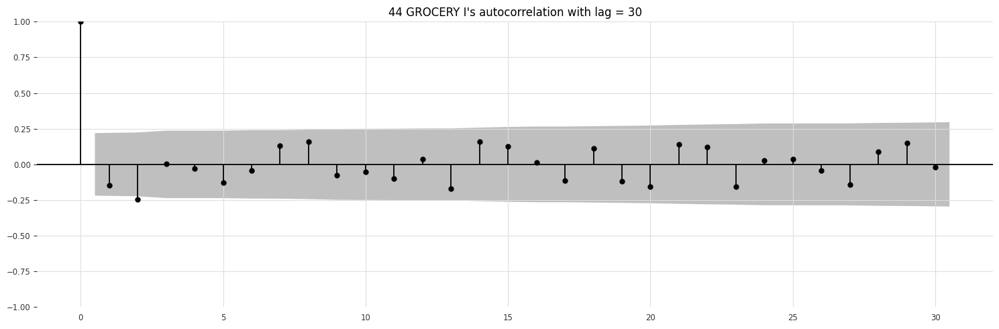

In [189]:
functions.plot_autocorr(series=backtest_lstm['44 GROCERY I'][1], lags=30)

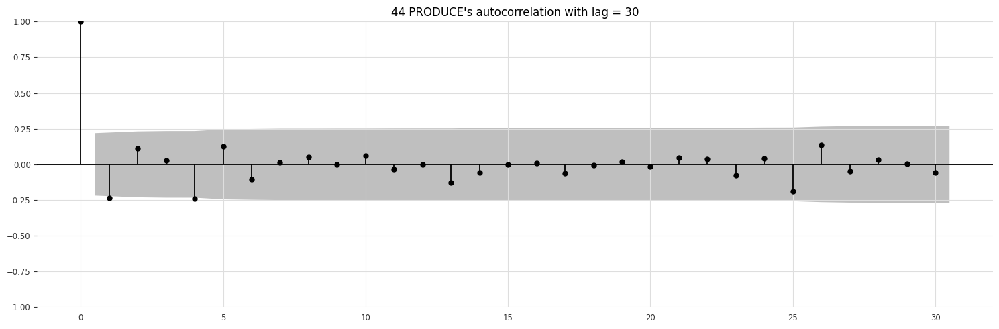

In [242]:
functions.plot_autocorr(series=backtest_lstm['44 PRODUCE'][1], lags=30)

In [190]:
backtest_lstm['44 GROCERY I'][1].describe().to_frame()

,44 GROCERY I
count,80.00
mean,-0.00
std,0.02
min,-0.08
25%,-0.01
50%,0.00
75%,0.01
max,0.06


<Figure size 640x480 with 0 Axes>

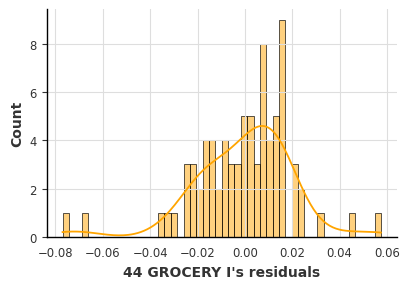

In [191]:
#sns.displot(backtest_lstm['44 PRODUCE'][1], kde=True, bins=30)
color = colors['lstm']
plt.figure()
sns.displot(backtest_lstm['44 GROCERY I'][1], kde=True, bins=50, color=color, height=3, aspect=1.4)
#plt.title("Residuals' distribution of 44 PRODUCE")
plt.xlabel("44 GROCERY I's residuals")
plt.tight_layout()
plt.show()

In [241]:
backtest_lstm['44 PRODUCE'][1].describe().to_frame()

,44 PRODUCE
count,80.00
mean,0.01
std,0.10
min,-0.28
25%,-0.04
50%,0.00
75%,0.05
max,0.36


<Figure size 640x480 with 0 Axes>

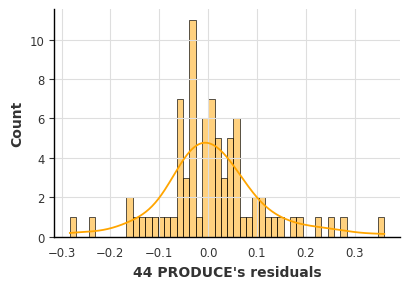

In [232]:
#sns.displot(backtest_lstm['44 PRODUCE'][1], kde=True, bins=30)
color = colors['lstm']
plt.figure()
sns.displot(backtest_lstm['44 PRODUCE'][1], kde=True, bins=50, color=color, height=3, aspect=1.4)
#plt.title("Residuals' distribution of 44 PRODUCE")
plt.xlabel("44 PRODUCE's residuals")
plt.tight_layout()
plt.show()

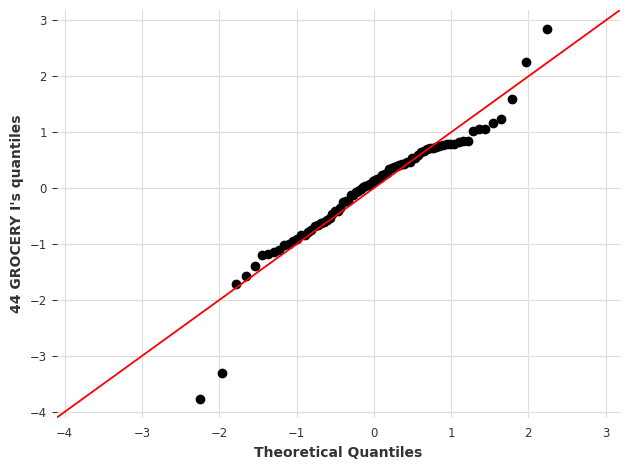

In [192]:
fig = sm.qqplot(data=backtest_lstm['44 GROCERY I'][1], fit=True, line="45")
plt.ylabel("44 GROCERY I's quantiles")
plt.tight_layout()
plt.show()

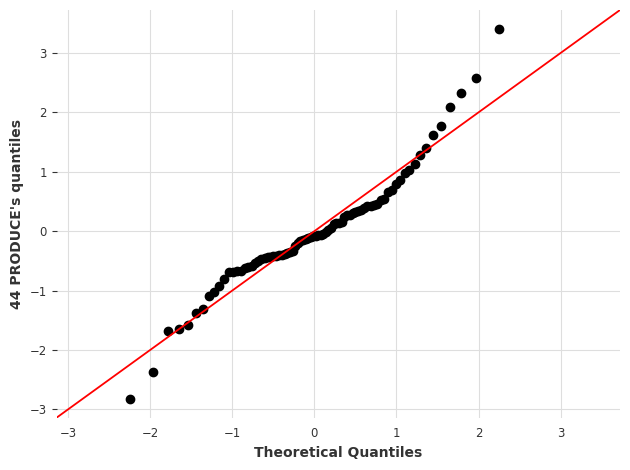

In [233]:
fig = sm.qqplot(data=backtest_lstm['44 PRODUCE'][1], fit=True, line="45")
plt.ylabel("44 PRODUCE's quantiles")
plt.tight_layout()
plt.show()

**Backtesting Arima**

In [193]:
from darts.models.forecasting.arima import ARIMA
#from sklearn.preprocessing import StandardScaler
from darts.dataprocessing.transformers import Scaler


def arima_backtest(diff_series: pd.Series, lags_indexes: list,
                   to_scale: bool = True, fut_cov_days_only: bool = False, week_of_year: bool = True):
    # nome serie
    name = diff_series.name

    # Creazione serie differenziata di darts
    series = TimeSeries.from_series(diff_series, freq='D', fill_missing_dates=True)
    
    #start parameter for backtesting
    start = len(series) - 15*(28-14)
    print(start)

    # Scalatura dei dati
    if to_scale == True:
        #scaler = Scaler(scaler=StandardScaler)
        scaler = Scaler()
        series = scaler.fit_transform(series=series)

    # Aggiunta covariate future
    covariates = functions.get_datetime_series(series=series, days_only=fut_cov_days_only, week_of_year=week_of_year)

    # Predizione in base al tipo di modello
    p = abs(lags_indexes[-1])
    model = ARIMA(p=p, d=0, q=0)
    
    #Backtesting
    backtest_mape = model.backtest(series=series, past_covariates=None, future_covariates=covariates, num_samples=1,
                                   train_length=None, start=start, forecast_horizon=28, stride=14, retrain=True,
                                   overlap_end=True, last_points_only=False, metric=mape, reduction=None, verbose=False)

    #Analisi residui
    #series_for_resid = series[1463:] # cioè dal '2017-01-04':
    #series_for_resid = series[1535:]
    indx = len(series)-153
    print(indx)
    series_for_resid = series[indx:]
    residuals = model.residuals(series=series_for_resid, future_covariates=covariates, forecast_horizon=28, retrain=True)
    #residuals = scaler.inverse_transform(residuals)
    res = residuals.pd_series()

    print("Residuals' mean:", round(res.mean(), 2))

    return backtest_mape, res, residuals

In [194]:
backtest_arima = {}
for category in series_to_backtest: #dict_series_rf.keys():
        diff_series = dict_diff_series[category][0]
        print(len(diff_series))
        #lags_indexes = lags_diff_series[category]
        lags_indexes = dict_diff_series[category][3]
        print(lags_indexes)
        backtest_ar, pd_res_ar, darts_res_ar = arima_backtest(diff_series=diff_series, lags_indexes=lags_indexes,
                                       to_scale=True, fut_cov_days_only=False, week_of_year=True)
        backtest_ar = [round(i, 2) for i in backtest_ar]
        pd_res_ar.name = category
        
        backtest_arima[category] = [backtest_ar, pd_res_ar, darts_res_ar]

1683
[-1, -2, -3, -4, -5, -6, -12, -13]
1477
settimane e giorni
1534
Residuals' mean: 0.04
1683
[-1, -2, -3, -6, -7, -14]
1477
settimane e giorni
1534
Residuals' mean: 0.03


In [195]:
print(len(backtest_arima['44 PRODUCE'][0]), min(backtest_arima['44 PRODUCE'][0]),
      round(average(backtest_arima['44 PRODUCE'][0]), 2), max(backtest_arima['44 PRODUCE'][0]))

15 6.49 15.44 22.88


In [196]:
#15 7.36 19.48 36.19

In [197]:
backtest_arima['44 PRODUCE'][0]

[17.51,
 13.55,
 15.72,
 20.81,
 22.88,
 21.81,
 15.09,
 19.75,
 17.22,
 13.07,
 15.93,
 13.0,
 6.49,
 7.37,
 11.35]

In [198]:
ar_mape_pro = pd.Series(backtest_arima['44 PRODUCE'][0])
ar_mape_pro = ar_mape_pro.describe().to_frame().rename(columns={0:'AR mape'})
ar_mape_pro

,AR mape
count,15.00
mean,15.44
std,4.84
min,6.49
25%,13.04
50%,15.72
75%,18.63
max,22.88


In [199]:
ar_mape_gro = pd.Series(backtest_arima['44 GROCERY I'][0])
ar_mape_gro = ar_mape_gro.describe().to_frame().rename(columns={0:'AR mape'})
ar_mape_gro

,AR mape
count,15.00
mean,3.87
std,1.18
min,1.95
25%,3.06
50%,3.60
75%,4.71
max,5.71


In [200]:
# fig, ax = plt.subplots(figsize=(2, 2))
# plt.boxplot(x=backtest_arima['44 PRODUCE'][0])
# plt.title("Arima Expanding window backtest mape scores (boxplot) of 44 PRODUCE")    
# plt.legend()
# plt.tight_layout()
# plt.show()

In [201]:
len(backtest_arima['44 PRODUCE'][1])

96

In [202]:
pd_res_arima_gro = backtest_arima['44 GROCERY I'][1]
#pd_res_arima[pd_res_arima.isna() == True]
#pd_res_arima = pd_res_arima.replace(to_replace=None, method='bfill')

In [203]:
pd_res_arima_gro.describe().to_frame()

,44 GROCERY I
count,96.00
mean,0.04
std,0.03
min,-0.03
25%,0.03
50%,0.04
75%,0.06
max,0.12


In [204]:
round(average(pd_res_arima_gro), 5)

0.04422

In [205]:
#backtest_arima['44 PRODUCE'][2].plot()
fig = px.line(x=backtest_arima['44 GROCERY I'][2].time_index, y=backtest_arima['44 GROCERY I'][2].pd_series(),
              title="AR: residuals'time series of 44 GROCERY I", width=700, height=350)
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='44 GROCERY I residuals',
    legend_title='Time series')
fig.show()

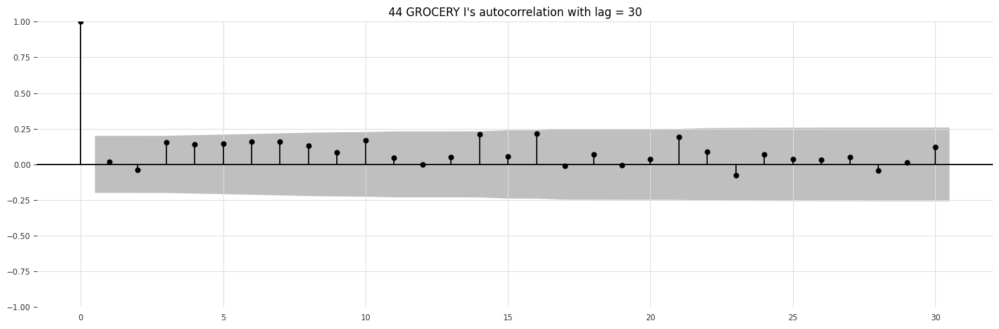

In [206]:
functions.plot_autocorr(series=pd_res_arima_gro, lags=30)

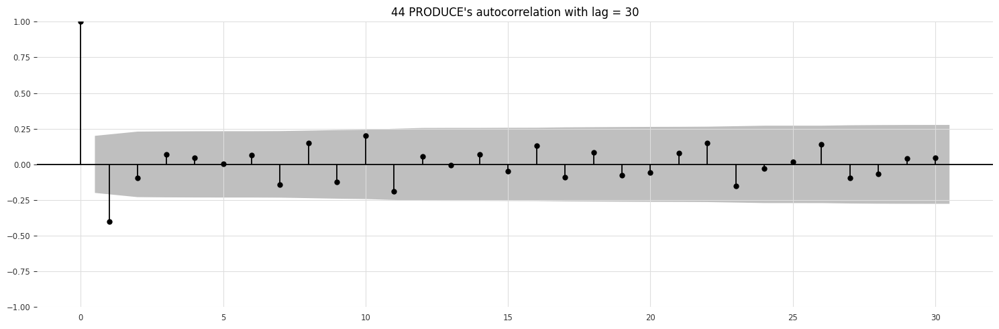

In [243]:
functions.plot_autocorr(series=backtest_arima['44 PRODUCE'][1], lags=30)

<Figure size 640x480 with 0 Axes>

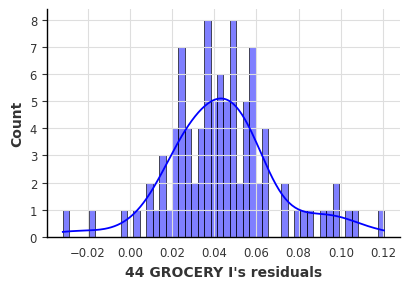

In [234]:
#sns.displot(pd_res_arima, kde=True, bins=30)
color = colors['AR']
plt.figure()
sns.displot(pd_res_arima_gro, kde=True, bins=50, color=color, height=3, aspect=1.4)
#plt.title("Residuals' distribution of 44 PRODUCE")
plt.xlabel("44 GROCERY I's residuals")
plt.tight_layout()
plt.show()

<Figure size 640x480 with 0 Axes>

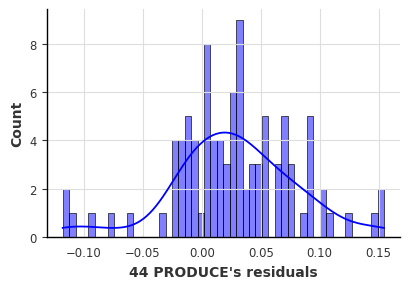

In [235]:
#sns.displot(pd_res_arima, kde=True, bins=30)
color = colors['AR']
plt.figure()
sns.displot(backtest_arima['44 PRODUCE'][1], kde=True, bins=50, color=color, height=3, aspect=1.4)
#plt.title("Residuals' distribution of 44 PRODUCE")
plt.xlabel("44 PRODUCE's residuals")
plt.tight_layout()
plt.show()

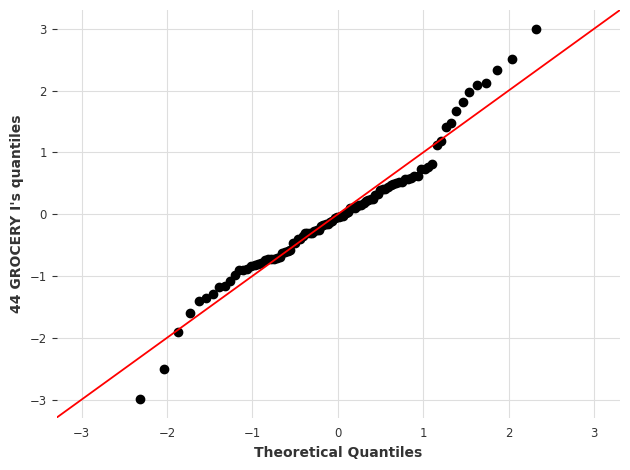

In [208]:
fig = sm.qqplot(data=pd_res_arima_gro, fit=True, line="45")
plt.ylabel("44 GROCERY I's quantiles")
plt.tight_layout()
plt.show()

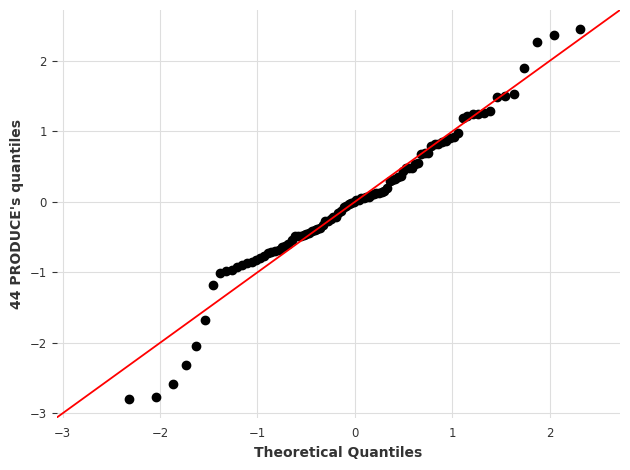

In [236]:
fig = sm.qqplot(data=backtest_arima['44 PRODUCE'][1], fit=True, line="45")
plt.ylabel("44 PRODUCE's quantiles")
plt.tight_layout()
plt.show()

**Backtesting Seasonal Arima**

In [209]:
#from darts.models.forecasting.arima import ARIMA
#from sklearn.preprocessing import StandardScaler

def auto_arima_backtest(diff_series: pd.Series, best_params: list,
                   to_scale: bool = True, fut_cov_days_only: bool = False, week_of_year: bool = True):
    # nome serie
    name = diff_series.name

    # Creazione serie differenziata di darts
    series = TimeSeries.from_series(diff_series, freq='D', fill_missing_dates=True)
    
    #start parameter for backtesting
    start = len(series) - 15*(28-14)
    print(start)
    
    # Scalatura dei dati
    if to_scale == True:
        scaler = Scaler()
        series = scaler.fit_transform(series)

    # Aggiunta covariate future
    covariates = functions.get_datetime_series(series=series, days_only=fut_cov_days_only, week_of_year=week_of_year)

    # Predizione in base al tipo di modello
    p, d, q = best_params[0], best_params[1], best_params[2]
    model = ARIMA(p=p, d=d, q=q, seasonal_order=(best_params[-4:]))
    
    #Backtesting
    backtest_mape = model.backtest(series=series, past_covariates=None, future_covariates=covariates, num_samples=1,
                                   train_length=None, start=start, forecast_horizon=28, stride=14, retrain=True,
                                   overlap_end=True, last_points_only=False, metric=mape, reduction=None, verbose=False)

    #Analisi residui
    #series_for_resid = series[1463:] # cioè dal '2017-01-01':
    indx = len(series)-153
    print(indx)
    series_for_resid = series[indx:]
    #series_for_resid = series[1556:]
    residuals = model.residuals(series_for_resid, future_covariates=covariates, forecast_horizon=28, retrain=True)
    #residuals = scaler.inverse_transform(residuals)
    res = residuals.pd_series()

    print("Residuals' mean:", round(res.mean(), 2))
    #plot_residuals_analysis(residuals, num_bins=50)

    return backtest_mape, res, residuals

In [210]:
auto_best_params_dict

{'44 BEVERAGES': [4, 0, 6, 3, 0, 0, 7],
 '44 GROCERY I': [2, 0, 6, 1, 0, 0, 7],
 '44 PRODUCE': [2, 0, 6, 1, 0, 0, 7],
 '45 BEVERAGES': [4, 0, 6, 3, 0, 0, 7],
 '45 GROCERY I': [2, 0, 6, 1, 0, 0, 7],
 '45 PRODUCE': [2, 0, 6, 1, 0, 0, 7]}

In [211]:
backtest_sarima = {}
for category in series_to_backtest: #dict_series_rf.keys():
    diff_series = dict_diff_series[category][0]
    print(len(diff_series))
    best_params = auto_best_params_dict[category]
    #print(diff_series.mask(diff_series != 0).count())
    #diff_series = diff_series.replace([0.00], method='bfill')
    sarima_backtest, sarima_pd_res, sarima_darts_res = auto_arima_backtest(diff_series=diff_series, best_params=best_params,
                                                                           to_scale=True, fut_cov_days_only=False, week_of_year=True)

    sarima_backtest = [round(i, 2) for i in sarima_backtest]
    sarima_pd_res.name = category
    backtest_sarima[category] = [sarima_backtest, sarima_pd_res, sarima_darts_res]

1683
1477
settimane e giorni
1534
Residuals' mean: 0.04
1683
1477
settimane e giorni
1534
Residuals' mean: 0.03


In [212]:
# backtest_sarima = {}
# backtest_sarima['44 PRODUCE'] = [sarima_backtest, sarima_pd_res, sarima_darts_res]

In [213]:
print(len(backtest_sarima['44 PRODUCE'][0]), min(backtest_sarima['44 PRODUCE'][0]),
      round(average(backtest_sarima['44 PRODUCE'][0]), 2), max(backtest_sarima['44 PRODUCE'][0]))

15 9.94 18.74 26.27


In [214]:
backtest_sarima['44 PRODUCE'][0]

[24.18,
 17.83,
 18.55,
 22.85,
 26.27,
 23.17,
 17.18,
 22.12,
 20.35,
 16.3,
 20.54,
 17.09,
 11.08,
 9.94,
 13.6]

In [215]:
sarima_mape_pro = pd.Series(backtest_sarima['44 PRODUCE'][0])
sarima_mape_pro = sarima_mape_pro.describe().to_frame().rename(columns={0:'SARIMA mape'})
sarima_mape_pro

,SARIMA mape
count,15.00
mean,18.74
std,4.74
min,9.94
25%,16.70
50%,18.55
75%,22.48
max,26.27


In [216]:
sarima_mape_gro = pd.Series(backtest_sarima['44 GROCERY I'][0])
sarima_mape_gro = sarima_mape_gro.describe().to_frame().rename(columns={0:'SARIMA mape'})
sarima_mape_gro

,SARIMA mape
count,15.00
mean,3.88
std,1.18
min,2.04
25%,3.03
50%,3.69
75%,4.73
max,5.77


In [217]:
naive_mape_pro

,Naive seasonal mape 44 PRODUCE
count,15.00
mean,11.81
std,3.69
min,7.33
25%,9.21
50%,11.40
75%,13.11
max,21.40


In [218]:
# fig, ax = plt.subplots(figsize=(2, 2))
# plt.boxplot(x=backtest_sarima['44 PRODUCE'][0])
# plt.title("SARIMA Expanding window backtest mape scores (boxplot) 44 PRODUCE")
# plt.legend()
# plt.tight_layout()
# plt.show()

In [219]:
len(backtest_sarima['44 PRODUCE'][1])

96

In [220]:
sarima_pd_res_gro = backtest_sarima['44 GROCERY I'][1]
sarima_pd_res_gro[sarima_pd_res_gro.isna() == True]

Series([], Freq: D, Name: 44 GROCERY I, dtype: float64)

In [221]:
#sarima_pd_res = sarima_pd_res.replace(to_replace=None, method='bfill')

In [222]:
sarima_pd_res_gro.describe().to_frame()

,44 GROCERY I
count,96.00
mean,0.04
std,0.02
min,-0.02
25%,0.03
50%,0.04
75%,0.06
max,0.12


In [223]:
round(average(sarima_pd_res_gro), 5)

0.04455

In [224]:
#diff_series['2017-05-10':].plot()

In [225]:
#backtest_sarima['44 PRODUCE'][2].plot()
fig = px.line(x=backtest_sarima['44 GROCERY I'][2].time_index, y=backtest_sarima['44 GROCERY I'][2].pd_series(),
              title="SARIMA residuals'time series of 44 GROCERY I", width=700, height=350)
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='44 GROCERY I residuals',
    legend_title='Time series')
fig.show()

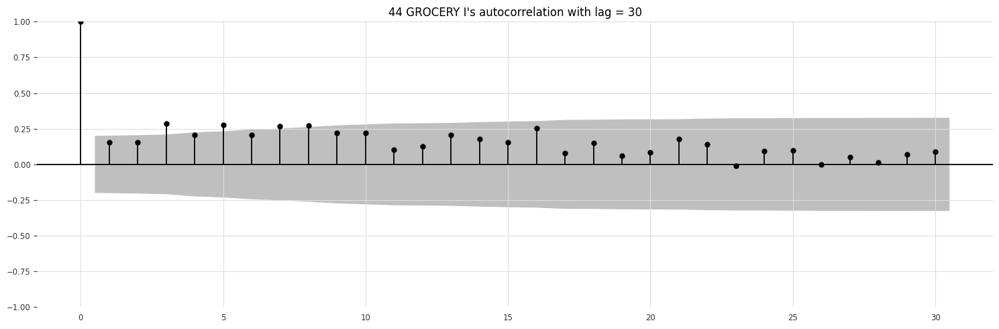

In [226]:
functions.plot_autocorr(series=sarima_pd_res_gro, lags=30)

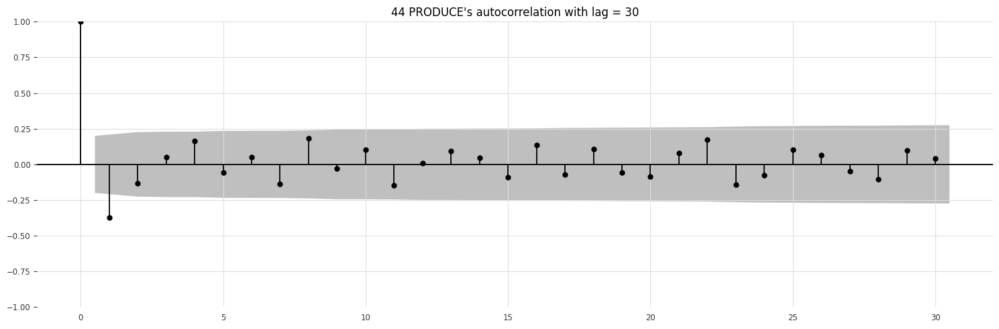

In [244]:
functions.plot_autocorr(series=backtest_sarima['44 PRODUCE'][1], lags=30)

<Figure size 640x480 with 0 Axes>

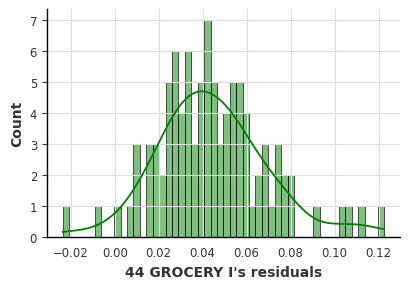

In [227]:
#sns.displot(sarima_pd_res, kde=True, bins=30)
color = colors['SARIMA']
plt.figure()
sns.displot(sarima_pd_res_gro, kde=True, bins=50, color=color, height=3, aspect=1.4)
#plt.title("Residuals'distribution of 44 PRODUCE")
plt.xlabel("44 GROCERY I's residuals")
plt.tight_layout()
plt.show()

<Figure size 640x480 with 0 Axes>

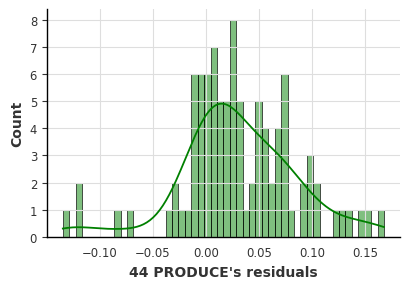

In [237]:
#sns.displot(sarima_pd_res, kde=True, bins=30)
color = colors['SARIMA']
plt.figure()
sns.displot(backtest_sarima['44 PRODUCE'][1], kde=True, bins=50, color=color, height=3, aspect=1.4)
#plt.title("Residuals'distribution of 44 PRODUCE")
plt.xlabel("44 PRODUCE's residuals")
plt.tight_layout()
plt.show()

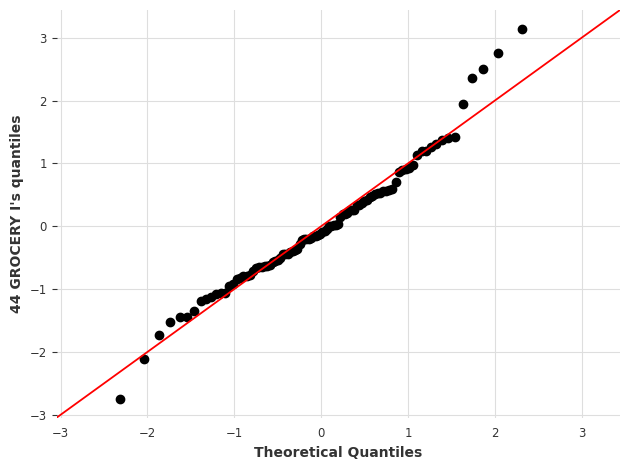

In [228]:
fig = sm.qqplot(data=sarima_pd_res_gro, fit=True, line="45")
#plt.title("Residuals'QQ plot of 44 PRODUCE")
plt.ylabel("44 GROCERY I's quantiles")
plt.tight_layout()
plt.show()

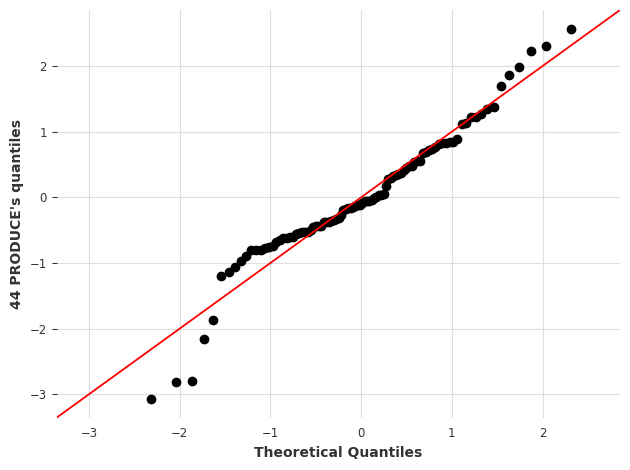

In [238]:
fig = sm.qqplot(data=backtest_sarima['44 PRODUCE'][1], fit=True, line="45")
#plt.title("Residuals'QQ plot of 44 PRODUCE")
plt.ylabel("44 PRODUCE's quantiles")
plt.tight_layout()
plt.show()

In [239]:
merged_mape_produce = pd.concat([naive_mape_pro, ar_mape_pro, sarima_mape_pro, lstm_mape_pro, rf_mape_pro, boosting_mape_pro], axis=1)
merged_mape_produce

,Naive seasonal mape 44 PRODUCE,AR mape,SARIMA mape,LSTM mape,Random forest mape,Lightgbm mape
count,15.00,15.00,15.00,13.00,15.00,15.00
mean,11.81,15.44,18.74,12.62,8.73,10.44
std,3.69,4.84,4.74,3.70,3.25,3.18
min,7.33,6.49,9.94,6.01,4.63,6.21
25%,9.21,13.04,16.70,10.49,6.21,7.55
50%,11.40,15.72,18.55,12.94,7.78,9.76
75%,13.11,18.63,22.48,14.40,10.79,13.12
max,21.40,22.88,26.27,18.30,14.26,16.29


In [230]:
#merged_mape_produce_short = merged_mape_produce.copy()
# merged_mape_produce_short['SARIMA mape'] = sarima_mape
# merged_mape_produce_short

In [240]:
merged_mape_grocery = pd.concat([naive_mape_gro, ar_mape_gro, sarima_mape_gro, lstm_mape_gro, rf_mape_gro, boosting_mape_gro], axis=1)
merged_mape_grocery

,Naive seasonal mape 44 GROCERY I,AR mape,SARIMA mape,LSTM mape,Random forest mape,Lightgbm mape
count,15.00,15.00,15.00,13.00,15.00,15.00
mean,14.01,3.87,3.88,3.88,10.62,12.89
std,4.67,1.18,1.18,1.29,2.55,3.22
min,9.93,1.95,2.04,2.18,6.09,9.32
25%,10.91,3.06,3.03,2.92,8.67,10.10
50%,12.06,3.60,3.69,3.35,10.28,11.42
75%,15.41,4.71,4.73,4.92,12.82,15.58
max,27.39,5.71,5.77,6.07,15.26,18.94
